In [1]:
import copy
import numpy as NP
from astropy import units as U
from astropy import constants as FC
import astropy.cosmology as Cosmo
import scipy.special as SPF
import scipy.integrate as integrate
from scipy import interpolate
import matplotlib.pyplot as PLT
import matplotlib.colors as PLTC
from matplotlib import ticker
# from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

from IPython.core.debugger import set_trace
# %matplotlib notebook
%matplotlib widget

PLT.rcParams.update({
    "text.usetex": False,
    # "font.family": "sans-serif",
    "font.family": "Dejavu Serif",
    "font.sans-serif": ["Helvetica"]})

cosmoparm = Cosmo.Planck18

## Define FLOPS and related units

1 complex addition consists of 2 real additions (2 floating point operations).

1 complex multiply, $(a+ib)(c+id)$ consists of 4 real multiplications, $ac, -bd, ad, bc$ and 2 real additions, $ac-bd$ and $bc+ad$. Therefore, 1 complex multiply $\rightarrow$ 6 floating point operations.

1 complex multiply and accumulate (CMAC) consists of 1 complex multiply and 1 complex addition $\rightarrow 6+2=8$ real floating point operations.

In [2]:
flo = U.def_unit('flo')
gflo = U.def_unit('gflo', 1e9*flo)
tflo = U.def_unit('tflo', 1e12*flo)
pflo = U.def_unit('pflo', 1e15*flo)
flops = U.def_unit('flops', flo/U.s)
gflops = U.def_unit('gflops', gflo/U.s)
tflops = U.def_unit('tflops', tflo/U.s)
pflops = U.def_unit('pflops', pflo/U.s)
cmult = 6*flo
cadd = 2*flo
cmac = cmult+cadd
wl = U.def_unit('wl', U.dimensionless_unscaled)
U.add_enabled_units([flo, gflo, tflo, pflo, flops, gflops, tflops, pflops, cmult, cadd, cmac, wl])

## Define some useful functions relating to computation effort

$N$-point complex FFT has $\frac{r}{\log_2 r} N \log_2 N$ CMACS which contains $\frac{8r}{\log_2 r} N \log_2 N$ floating point operations.

In [3]:
def flo_fft(n, radix=2):
    return (radix/NP.log2(radix)) * n * NP.log2(n) * cmac # Provide reference

def flo_dft(n1, n2):
    return n1*n2*cmac

def flo_correlator(n, npol=1):
    return npol**2 * n*(n-1)/2 * cmult

def flo_voltage_beamform(ncmacs):
    return ncmacs * cmac

def flo_pixelwise_intensity_from_voltage(npix, npol=1):
    return npol**2 * npix * cmult

## Define function relating to event rates

If $\nu_\textrm{out}$ is the required output frequency and $\nu_\textrm{in}$ is the input frequency where a measurement is available, then the luminosity density, $L_\nu(\nu_\textrm{out})$, and the flux density, $S_\nu(\nu_\textrm{in})$, are related by
$$ 
\begin{align}
    L_\nu(\nu_\textrm{out}) &= \frac{4\pi D_L^2(z)}{1+z} \, S_\nu(\nu_\textrm{in}) \, K_{L_{\nu_\textrm{out}}\leftarrow S_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right) \\
    &= 4\pi (1+z) D_C^2(z) \, S_\nu(\nu_\textrm{in}) \, K_{L_{\nu_\textrm{out}}\leftarrow S_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right)
\end{align}
$$
where, $D_C(z)$ is the comoving distance, $D_L(z)=(1+z)\,D_C(z)$ is the luminosity distance, and $K_{L_{\nu_\textrm{out}}\leftarrow S_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right)$ is the K-correction factor, which for a power-law spectrum with spectral index, $\alpha$ (with $S_\nu \propto \nu^\alpha$), is given by
$$
K_{L_{\nu_\textrm{out}}\leftarrow S_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right) = \left(\frac{\nu_\textrm{out}/\nu_\textrm{in}}{1+z}\right)^\alpha
$$

The reverse of this equation to determine spectral flux density from spectral luminosity measurement is
$$
\begin{align}
    S_\nu(\nu_\textrm{out}) &= \frac{(1+z)\, L_\nu(\nu_\textrm{in})}{4\pi D_L^2(z)} \, K_{S_{\nu_\textrm{out}}\leftarrow L_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right) \\
    &= \frac{L_\nu(\nu_\textrm{in})}{(1+z)\, 4\pi D_C^2(z)} \, K_{S_{\nu_\textrm{out}}\leftarrow L_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right) 
\end{align}
$$
where, 
$$
\begin{align}
    K_{S_{\nu_\textrm{out}}\leftarrow L_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{out}}{\nu_\textrm{in}}\right) &= K^{-1}_{L_{\nu_\textrm{out}}\leftarrow S_{\nu_\textrm{in}}}\left(z,\alpha,\frac{\nu_\textrm{in}}{\nu_\textrm{out}}\right) \\
    &= \left(\frac{1+z}{\nu_\textrm{in}/\nu_\textrm{out}}\right)^\alpha 
\end{align}
$$


In [4]:
def k_correction_Sin_Lout(redshift, spindex=0.0, fout_by_fin_ratio=1.0):
    # From Condon & Mathews (2018), PASP, 130, 073001 (and) Macquart & Ekers (2018), MNRAS, 480, 4211
    return (fout_by_fin_ratio/(1+redshift))**spindex 

def k_correction_Lin_Sout(redshift, spindex=0.0, fout_by_fin_ratio=1.0):
    # From Condon & Mathews (2018), PASP, 130, 073001 (and) Macquart & Ekers (2018), MNRAS, 480, 4211
    return (fout_by_fin_ratio*(1+redshift))**spindex

def lum_density_from_flux_density(flux_density_in, redshift=None, dist_lum=None, spindex=0.0, fout_by_fin_ratio=1.0):
    if (redshift is None) and (dist_lum is None):
        raise ValueError('Either redshift or dist_lum must be specified')
    if (redshift is not None) and (dist_lum is not None):
        raise ValueError('Only one of redshift or dist_lum must be specified')
    if redshift is not None:
        dist_lum = cosmoparm.luminosity_distance(redshift)
    elif dist_lum is not None:
        redshift = Cosmo.z_at_value(cosmoparm.luminosity_distance, dist_lum)
    
    k_correction_factor = k_correction_Sin_Lout(redshift, spindex=spindex, fout_by_fin_ratio=fout_by_fin_ratio)
    lum_density_out = 4 * NP.pi * dist_lum**2 / (1+redshift) * k_correction_factor * flux_density_in
    
    return lum_density_out

def flux_density_from_lum_density(lum_density_in, redshift=None, dist_lum=None, spindex=0.0, fout_by_fin_ratio=1.0):
    if (redshift is None) and (dist_lum is None):
        raise ValueError('Either redshift or dist_lum must be specified')
    if (redshift is not None) and (dist_lum is not None):
        raise ValueError('Only one of redshift or dist_lum must be specified')
    if redshift is not None:
        dist_lum = cosmoparm.luminosity_distance(redshift)
    elif dist_lum is not None:
        redshift = Cosmo.z_at_value(cosmoparm.luminosity_distance, dist_lum)
    
    k_correction_factor = k_correction_Lin_Sout(redshift, spindex=spindex, fout_by_fin_ratio=fout_by_fin_ratio)
    flux_density_out = (1+redshift) * lum_density_in * k_correction_factor / (4 * NP.pi * dist_lum**2)
    
    return flux_density_out

def surface_area_modulus_function(redshift):
    redshift = NP.asarray(redshift).reshape(-1)
    return 4 * NP.pi * cosmoparm.luminosity_distance(redshift)**2 / (1+redshift) # See Condon & Matthews (2018) on Cosmology equation 54 using spectral luminosity

def surface_area_modulus_function_alternate(redshift):
    redshift = NP.asarray(redshift).reshape(-1)
    return 4 * NP.pi * cosmoparm.luminosity_distance(redshift)**2 # See Condon & Matthews (2018) on Cosmology equation 51 using bolometric luminosity


In [5]:
def d_lum_1(luminosity, flux):
    return NP.sqrt(luminosity / (4 * NP.pi * flux))

def d_lum_2(energy, fluence):
    return NP.sqrt(energy / (4 * NP.pi * fluence))

def psd_to_esd(psd, dt):
    return psd * dt

def esd_to_psd(esd, dt):
    return esd / dt

In [6]:
def vis_noise_from_sensitivity(Aeff_over_Tsys, dt, df, npol=1, n_meas=1, efficiency=1.0):
    vis_noise = 2 * FC.k_B / (efficiency * (Aeff_over_Tsys) * NP.sqrt(2*npol*n_meas*df*dt))
    return vis_noise

def vis_noise(A_eff, T_sys, dt, df, npol=1, n_meas=1, efficiency=1.0):
    Aeff_over_Tsys = A_eff / T_sys
    vis_noise = vis_noise_from_sensitivity(Aeff_over_Tsys, dt, df, npol=1, n_meas=1, efficiency=1.0)
    return vis_noise

def fluence_noise_from_sensitivity(Aeff_over_Tsys, dt, df, twidth, bw, npol=1, n_meas=1, efficiency=1.0):
    vis_noise = vis_noise_from_sensitivity(Aeff_over_Tsys, dt, df, npol=1, n_meas=1, efficiency=1.0)
    ntimes = twidth / dt
    nchan = bw / df
    fluence_noise = vis_noise * NP.sqrt(ntimes*nchan) * dt * df
    return fluence_noise

def fluence_noise(A_eff, T_sys, dt, df, twidth, bw, npol=1, n_meas=1, efficiency=1.0):
    Aeff_over_Tsys = A_eff / T_sys
    fluence_noise = fluence_noise_from_sensitivity(Aeff_over_Tsys, dt, df, twidth, bw, npol=1, n_meas=1, efficiency=1.0)
    return fluence_noise

def max_luminosity_distance(luminosity, min_flux, t_wid_int, dt):
    return luminosity_distance(luminosity, min_flux) * (t_wid_int/dt)**0.25

def max_luminosity_volume(luminosity, min_flux, t_wid_int, dt, sky_fraction=1.0):
    d_lum_max = max_luminosity_distance(luminosity, min_flux, t_wid_int, dt)
    return 4 * NP.pi / 3 * sky_fraction * d_lum_max**3

def frb_vol_rate_Bochenek_et_al_2020(esd_min, phi_32=2.76, plindex=-1.5):
    # Obtained from Bochenek et al. (2020), Nature, 587, 59 [eqn. 2]
    log10_cumm_rate = plindex * (NP.log10(esd_min.cgs.value) - 32.0) + phi_32
    return 10**log10_cumm_rate / (1e6*U.kpc)**3 / U.year 

def upper_gamma_incomplete(alpha, x):
    if alpha==0:
        return SPF.exp1(x)
    elif (alpha<0):
        return (upper_gamma_incomplete(alpha+1,x)-NP.power(x, alpha)*NP.exp(-x))/alpha
    else:
        return SPF.gammaincc(alpha,x)*SPF.gamma(alpha)
    
def frb_vol_rate_Luo_et_al_2020(lum, plindex=-1.5, phi_=339/(1e6*U.kpc)**3/U.year, lum_=10**44.46*U.erg/U.s):
    x = (lum/lum_).decompose().value
    alpha = plindex + 1
    return phi_ * upper_gamma_incomplete(alpha, x)

def uniform_redshift_weighted_comoving_volume(z, zmax, zmin=0.0, cosmo=cosmoparm):
    zmax = NP.array(zmax).reshape(-1)
    zarr = []
    for zmx in zmax:
        zcut_max = NP.clip(z, a_min=None, a_max=zmx)
        zarr += [zcut_max]
    zarr = NP.array(zarr)
    cmvol = cosmo.comoving_volume(zarr) - cosmo.comoving_volume(zmin)
    return cmvol
    
def frb_redshift_distribution_old(z, zcut, model='uniform-step', output='cdf'):
    z = NP.array(z)
    zcut = NP.array(zcut)
    zlim = 10 * NP.amax(zcut)
    zv = NP.linspace(0, zlim, num=10000, endpoint=True)
    dzv = zv[1] - zv[0]
    pdf = NP.zeros((zlim.size,zv.size))
    if model=='uniform-step':
        pdf = NP.ones((zcut.size,zv.size)) * (zv.reshape(1,-1) <= zcut.reshape(-1,1)) * U.dimensionless_unscaled
    else:
        d_cmv = cosmoparm.comoving_distance(zv)
        d_lum = cosmoparm.luminosity_distance(zv)
        d_lum_zc = cosmoparm.luminosity_distance(zcut)
        pdf = FC.c * 4*NP.pi*d_cmv.reshape(1,-1)**2 / ((1+zv.reshape(1,-1))*cosmoparm.H(zv.reshape(1,-1))) * NP.exp(-d_lum.reshape(1,-1)**2/(2*d_lum_zc.reshape(-1,1)**2))
        if model == 'sfh':
            b1 = 0.0170
            b2 = 0.13
            b3 = 3.3
            b4 = 5.3
            sfh_unit = U.M_sun / U.yr / U.Mpc**3
            rho_star = (b1+b2*zv.reshape(1,-1))*cosmoparm.h / (1+(zv.reshape(1,-1)/b3)**b4) * sfh_unit
            pdf = pdf * rho_star
    pdf = pdf.si
    norm_factor = NP.trapz(pdf.si.value, dx=dzv, axis=-1) * pdf.unit
    pdf = pdf / norm_factor.reshape(-1,1)
    pdf = pdf.decompose().value
    if model=='uniform-step':
        pdf_interpfunc = interpolate.interp1d(zv, pdf, kind='linear')
    else:
        pdf_interpfunc = interpolate.interp1d(zv, pdf, kind='cubic')
    if output=='pdf':
        return pdf_interpfunc(z)
    else:
        cdf = []
        zind = NP.argmin(NP.abs(zv.reshape(1,-1) - z.reshape(-1,1)), axis=1)
        for zi in zind:
            cdf += [NP.trapz(pdf[:,:zi+1], dx=dzv)]
        return NP.array(cdf).T
    
def redshift_weighted_dV_dz(z, zcut, model='uniform-step'):
    pass

## Define some functions related to plotting

In [7]:
def multidim_corner_plot_info(arr, axes=None, nominal_inds=None):
    if not isinstance(arr, NP.ndarray):
        raise TypeError('Input arr must be a numpy array')
    if arr.ndim < 2:
        raise TypeError('Input arr does not contain enough dimensions for a corner plot')

    arr_shape = arr.shape
    
    if axes is None:
        axes = NP.arange(arr.ndim)
    elif isinstance(axes, (list,NP.ndarray)):
        axes = NP.asarray(axes, dtype=int)
        if axes.size > arr.ndim:
            raise ValueError('')
        if NP.any(axes < 0) or NP.any(axes >= arr.ndim):
            raise ValueError('Input axes contains dimensions outside of input arr')
    else:
        raise TypeError('Input axes has incorrect type')
        
    if nominal_inds is None:
        nominal_inds = NP.zeros(arr.ndim)
    elif isinstance(nominal_inds, (list,NP.ndarray)):
        nominal_inds = NP.asarray(nominal_inds, dtype=int)
        if nominal_inds.size > arr.ndim:
            raise ValueError('')
        if NP.any(nominal_inds >= arr_shape):
            exind = NP.where(nominal_inds >= arr_shape)[0]
            if NP.all(NP.array(arr_shape)[exind]==1):
                nominal_inds[exind] = 0
            else:
                raise ValueError('Input nominal_inds contains indices beyond the size of input arr') 
        if NP.any(nominal_inds < 0):
            raise ValueError('Input nominal_inds contains indices beyond the size of input arr')            
#         if NP.any(nominal_inds < 0) or NP.any(nominal_inds >= arr_shape):
#             raise ValueError('Input nominal_inds contains indices beyond the size of input arr')
    
    axes = NP.sort(axes)
    nrows = axes.size - 1
    ncols = nrows
    
    outdict = {}
    for r in range(nrows):
        axr = axes[axes.size-2-r]
        for c in range(r+1):
            key = (r,c)
            axc = axes[axes.size-1-c]
            axkey = (axr, axc)
            multidim_idx = []
            for ni,nomi in enumerate(nominal_inds):
                if ni==axr:
                    multidim_idx += [NP.arange(arr_shape[axr]).reshape(-1).tolist()]
                elif ni==axc:
                    multidim_idx += [NP.arange(arr_shape[axc]).reshape(-1).tolist()]
                else:
                    multidim_idx += [NP.array(nomi).reshape(-1).tolist()]
            outdict[key] = {'axkey': axkey, 'array': arr[NP.ix_(*multidim_idx)]}
    return outdict

In [8]:
figdir = '/mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/'

## Prepare observational parameters

In [9]:
wvlen = 2 * U.m
freq_obs = (FC.c / wvlen).to('MHz')
bw_inst = 100 * U.MHz
df = 40 * U.kHz
tsamp = 1/bw_inst
dt = 1/df
tacc = NP.geomspace(0.1, 1e4, 6, endpoint=True) * U.ms
tacc = tacc.si
nchan = (bw_inst/df).decompose().value
nsamp_per_acc = (tacc/dt).decompose().value
zcut = NP.array([3.0, 6.0, 9.0, 12.0]) # redshift cutoff for transient events
print(dt.to('ms'))
print(tacc)
print(nsamp_per_acc)

0.025 ms
[1.e-04 1.e-03 1.e-02 1.e-01 1.e+00 1.e+01] s
[4.e+00 4.e+01 4.e+02 4.e+03 4.e+04 4.e+05]


## Define some element/station/array/grid parameters

In [10]:
# SKA1-low reference: Macario et al. (2022)

arr1 = {'name': 'SKA1-low-core', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
arr1.update({'ant_dia': 2*U.m/arr1['wvlen'], 'station_dia': 35*U.m/arr1['wvlen'], 'array_dia': 1.05*U.km/arr1['wvlen']})
arr1.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
             'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})

arr2 = {'name': 'SKA1-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
arr2.update({'ant_dia': 2*U.m/arr2['wvlen'], 'station_dia': 35*U.m/arr2['wvlen'], 'array_dia': 70*U.km/arr2['wvlen']})
arr2.update({'ff_in_station': arr2['nants_in_station'] * (arr2['ant_dia']/arr2['station_dia']).decompose()**2, 
             'ff_in_array': arr2['nstations'] * (arr2['station_dia']/arr2['array_dia']).decompose()**2})

arr3 = {'name': 'LAMBDA-I', 'nstations': 8, 'nants_in_station': 256, 'npol': 2, 'wvlen': 1*U.m}
arr3.update({'ant_dia': 1*U.m/arr3['wvlen'], 'station_dia': 17.5*U.m/arr3['wvlen'], 'array_dia': 3900*U.km/arr3['wvlen']})
arr3.update({'ff_in_station': arr3['nants_in_station'] * (arr3['ant_dia']/arr3['station_dia']).decompose()**2, 
             'ff_in_array': arr3['nstations'] * (arr3['station_dia']/arr3['array_dia']).decompose()**2})

# arr4 = {'name': 'CASPA', 'nstations': 3, 'nants_in_station': 98, 'npol': 2, 'wvlen': 0.3*U.m}
# arr4.update({'ant_dia': 0.5, 'station_dia': 1.9*U.m/arr4['wvlen'], 'array_dia': 3900*U.km/arr4['wvlen']})
# arr4.update({'ff_in_station': arr4['nants_in_station'] * (arr4['ant_dia']/arr4['station_dia']).decompose()**2, 
#              'ff_in_array': arr4['nstations'] * (arr4['station_dia']/arr4['array_dia']).decompose()**2})

arr4 = {'name': 'CASPA', 'nstations': 3, 'nants_in_station': 65, 'npol': 2, 'wvlen': 0.25*U.m}
arr4.update({'ant_dia': 1.0, 'station_dia': 2.02*U.m/arr4['wvlen'], 'array_dia': (10/NP.cos(NP.pi/6))*U.km/arr4['wvlen']})
arr4.update({'ff_in_station': arr4['nants_in_station'] * (arr4['ant_dia']/arr4['station_dia']).decompose()**2, 
             'ff_in_array': arr4['nstations'] * (arr4['station_dia']/arr4['array_dia']).decompose()**2})

arr5 = {'name': 'FarView', 'nstations': 81, 'nants_in_station': 625, 'npol': 2, 'wvlen': 10*U.m}
arr5.update({'ant_dia': 10*U.m/arr5['wvlen'], 'station_dia': 385*U.m/arr5['wvlen'], 
             'array_dia': 12.0/NP.sqrt(NP.pi)*U.km/arr5['wvlen']})
arr5.update({'ff_in_station': arr5['nants_in_station'] * (arr5['ant_dia']/arr5['station_dia']).decompose()**2, 
             'ff_in_array': arr5['nstations'] * (arr5['station_dia']/arr5['array_dia']).decompose()**2})

arr6 = {'name': 'LAMBDA-II', 'nstations': 32, 'nants_in_station': 256, 'npol': 2, 'wvlen': 1*U.m}
arr6.update({'ant_dia': 1*U.m/arr6['wvlen'], 'station_dia': 17.5*U.m/arr6['wvlen'], 'array_dia': 3900*U.km/arr6['wvlen']})
arr6.update({'ff_in_station': arr6['nants_in_station'] * (arr6['ant_dia']/arr6['station_dia']).decompose()**2, 
             'ff_in_array': arr6['nstations'] * (arr6['station_dia']/arr6['array_dia']).decompose()**2})

arr7 = {'name': 'AU-VLBA-Low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
arr7.update({'ant_dia': 2*U.m/arr7['wvlen'], 'station_dia': 35*U.m/arr7['wvlen'], 'array_dia': 3900*U.km/arr6['wvlen']})
arr7.update({'ff_in_station': arr7['nants_in_station'] * (arr7['ant_dia']/arr7['station_dia']).decompose()**2, 
             'ff_in_array': arr7['nstations'] * (arr7['station_dia']/arr7['array_dia']).decompose()**2})

arr8 = {'name': 'SKA1-low-core-lb', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': (FC.c/(50*U.MHz)).to('m')}
arr8.update({'ant_dia': 2*U.m/arr8['wvlen'], 'station_dia': 35*U.m/arr8['wvlen'], 'array_dia': 1.05*U.km/arr8['wvlen']})
arr8.update({'ff_in_station': arr8['nants_in_station'] * (arr8['ant_dia']/arr8['station_dia']).decompose()**2, 
             'ff_in_array': arr8['nstations'] * (arr8['station_dia']/arr8['array_dia']).decompose()**2})

arr9 = {'name': 'SKA1-low-core-hb', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': (FC.c/(350*U.MHz)).to('m')}
arr9.update({'ant_dia': 2*U.m/arr9['wvlen'], 'station_dia': 35*U.m/arr9['wvlen'], 'array_dia': 1.05*U.km/arr9['wvlen']})
arr9.update({'ff_in_station': arr9['nants_in_station'] * (arr9['ant_dia']/arr9['station_dia']).decompose()**2, 
             'ff_in_array': arr9['nstations'] * (arr9['station_dia']/arr9['array_dia']).decompose()**2})

arr10 = {'name': 'SKA1-low-lb', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': (FC.c/(50*U.MHz)).to('m')}
arr10.update({'ant_dia': 2*U.m/arr10['wvlen'], 'station_dia': 35*U.m/arr10['wvlen'], 'array_dia': 70*U.km/arr10['wvlen']})
arr10.update({'ff_in_station': arr10['nants_in_station'] * (arr10['ant_dia']/arr10['station_dia']).decompose()**2, 
             'ff_in_array': arr10['nstations'] * (arr10['station_dia']/arr10['array_dia']).decompose()**2})

arr11 = {'name': 'SKA1-low-hb', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': (FC.c/(350*U.MHz)).to('m')}
arr11.update({'ant_dia': 2*U.m/arr11['wvlen'], 'station_dia': 35*U.m/arr11['wvlen'], 'array_dia': 70*U.km/arr11['wvlen']})
arr11.update({'ff_in_station': arr11['nants_in_station'] * (arr11['ant_dia']/arr11['station_dia']).decompose()**2, 
             'ff_in_array': arr11['nstations'] * (arr11['station_dia']/arr11['array_dia']).decompose()**2})

# arr7 = {'name': 'IC-VLBA-Low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
# arr7.update({'ant_dia': 2*U.m/arr7['wvlen'], 'station_dia': 35*U.m/arr7['wvlen'], 'array_dia': 7800*U.km/arr6['wvlen']})
# arr7.update({'ff_in_station': arr7['nants_in_station'] * (arr7['ant_dia']/arr7['station_dia']).decompose()**2, 
#              'ff_in_array': arr7['nstations'] * (arr7['station_dia']/arr7['array_dia']).decompose()**2})

focal_arr1 = {'name': 'ASKAP', 'nstations': 36, 'nants_in_station': 1, 'npol': 2, 'wvlen': 0.2*U.m}
focal_arr1.update({'ant_dia': 12*U.m/focal_arr1['wvlen'], 'station_dia': 12*U.m/focal_arr1['wvlen'], 'array_dia': 6*U.km/focal_arr1['wvlen']})
focal_arr1.update({'ff_in_station': focal_arr1['nants_in_station'] * (focal_arr1['ant_dia']/focal_arr1['station_dia']).decompose()**2, 'ff_in_array': focal_arr1['nstations'] * (focal_arr1['station_dia']/focal_arr1['array_dia']).decompose()**2, 'n_stnbeams': 36})
# focal_arr1['ff_in_array'] = focal_arr1['nstations'] * (focal_arr1['station_dia']/focal_arr1['array_dia']).decompose()**2
# focal_arr1['n_stnbeams'] = 36

In [11]:
# 'wvlen': wvlen}
# arr2.update({'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 70*U.km/wvlen})
# arr2.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
#              'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})
# arr3 = {'name': 'LAMBDA-I', 'nstations': 4, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
# arr3.update({'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 3900*U.km/wvlen})
# arr3.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
#              'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})
# arr4 = {'name': 'FarView', 'nstations': 81, 'nants_in_station': 625, 'npol': 2, 'wvlen': 10*U.m}
# arr4.update({'ant_dia': 10*U.m/arr4['wvlen'], 'station_dia': 385*U.m/arr4['wvlen'], 
#              'array_dia': 12.0/NP.sqrt(NP.pi)*U.km/arr4['wvlen']})
# arr4.update({'ff_in_station': arr4['nants_in_station'] * (arr4['ant_dia']/arr4['station_dia']).decompose()**2, 
#              'ff_in_array': arr4['nstations'] * (arr4['station_dia']/arr4['array_dia']).decompose()**2})
# arr5 = {'name': 'LAMBDA-II', 'nstations': 64, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
# arr5.update({'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 3900*U.km/wvlen})
# arr5.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
#              'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})
# arr7 = {'name': 'SKA1-low-core', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
# arr7.update({'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 1.05*U.km/wvlen})
# arr7.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
#              'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})
# arr6 = {'name': 'IC-VLBA-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'wvlen': wvlen}
# arr6.update({'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 7800*U.km/wvlen})
# arr6.update({'ff_in_station': arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2, 
#              'ff_in_array': arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2})


In [12]:

# arr1['ff_in_station'] = arr1['nants_in_station'] * (arr1['ant_dia']/arr1['station_dia']).decompose()**2
# arr1['ff_in_array'] = arr1['nstations'] * (arr1['station_dia']/arr1['array_dia']).decompose()**2
# arr2 = {'name': 'SKA1-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 65*U.km/wvlen}
# arr2['ff_in_station'] = arr2['nants_in_station'] * (arr2['ant_dia']/arr2['station_dia']).decompose()**2
# arr2['ff_in_array'] = arr2['nstations'] * (arr2['station_dia']/arr2['array_dia']).decompose()**2
# arr3 = {'name': 'AU-VLBA-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 3900*U.km/wvlen}
# arr3['ff_in_station'] = arr3['nants_in_station'] * (arr3['ant_dia']/arr3['station_dia']).decompose()**2
# arr3['ff_in_array'] = arr3['nstations'] * (arr3['station_dia']/arr3['array_dia']).decompose()**2
# arr4 = {'name': 'IC-VLBA-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 7800*U.km/wvlen}
# arr4['ff_in_station'] = arr4['nants_in_station'] * (arr4['ant_dia']/arr4['station_dia']).decompose()**2
# arr4['ff_in_array'] = arr4['nstations'] * (arr4['station_dia']/arr4['array_dia']).decompose()**2
# arr5 = {'name': 'LAMBDA-I', 'nstations': 4, 'nants_in_station': 256, 'npol': 2, 'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 3900*U.km/wvlen}
# arr5['ff_in_station'] = arr5['nants_in_station'] * (arr5['ant_dia']/arr5['station_dia']).decompose()**2
# arr5['ff_in_array'] = arr5['nstations'] * (arr5['station_dia']/arr5['array_dia']).decompose()**2
# arr6 = {'name': 'LAMBDA-II', 'nstations': 64, 'nants_in_station': 256, 'npol': 2, 'ant_dia': 2*U.m/wvlen, 'station_dia': 35*U.m/wvlen, 'array_dia': 3900*U.km/wvlen}
# arr6['ff_in_station'] = arr6['nants_in_station'] * (arr6['ant_dia']/arr6['station_dia']).decompose()**2
# arr6['ff_in_array'] = arr6['nstations'] * (arr6['station_dia']/arr6['array_dia']).decompose()**2
# # arr7['ant_dia'] = 10*U.m/arr7['wvlen']
# # arr7['station_dia'] = 375*U.m/arr7['wvlen']
# # arr7['array_dia'] = 12.0/NP.sqrt(NP.pi)*U.km/arr7['wvlen']
# # arr7['ff_in_station'] = arr7['nants_in_station'] * (arr7['ant_dia']/arr7['station_dia']).decompose()**2
# # arr7['ff_in_array'] = arr7['nstations'] * (arr7['station_dia']/arr7['array_dia']).decompose()**2



# focal_arr1 = {'name': 'ASKAP', 'nstations': 36, 'nants_in_station': 1, 'npol': 2, 'ant_dia': 12*U.m/(0.2*U.m), 'station_dia': 12*U.m/(0.2*U.m), 'array_dia': 6*U.km/(0.2*U.m)}
# focal_arr1['ff_in_station'] = focal_arr1['nants_in_station'] * (focal_arr1['ant_dia']/focal_arr1['station_dia']).decompose()**2
# focal_arr1['ff_in_array'] = focal_arr1['nstations'] * (focal_arr1['station_dia']/focal_arr1['array_dia']).decompose()**2
# focal_arr1['n_stnbeams'] = 36

In [13]:
arrs = {0: arr1, 1: arr2, 2: arr3, 3: arr4, 4: arr5, 5: arr6, 6: arr7, 7: arr8, 8: arr9, 9: arr10, 10: arr11}

In [14]:
print(arr1)
print('-------')
print(arr2)
print('-------')
print(arr3)
print('-------')
print(arr4)
print('-------')
print(arr5)
print('-------')
print(arr6)
print('-------')
print(arr7)
print('-------')
print(arr8)
print('-------')
print(arr9)
print('-------')
print(arr10)
print('-------')
print(arr11)
print('-------')
print(arrs)
print('-------')
print(focal_arr1)

{'name': 'SKA1-low-core', 'nstations': 256, 'nants_in_station': 256, 'npol': 2, 'wvlen': <Quantity 2. m>, 'ant_dia': <Quantity 1.>, 'station_dia': <Quantity 17.5>, 'array_dia': <Quantity 0.525 km / m>, 'ff_in_station': <Quantity 0.83591837>, 'ff_in_array': <Quantity 0.28444444>}
-------
{'name': 'SKA1-low', 'nstations': 512, 'nants_in_station': 256, 'npol': 2, 'wvlen': <Quantity 2. m>, 'ant_dia': <Quantity 1.>, 'station_dia': <Quantity 17.5>, 'array_dia': <Quantity 35. km / m>, 'ff_in_station': <Quantity 0.83591837>, 'ff_in_array': <Quantity 0.000128>}
-------
{'name': 'LAMBDA-I', 'nstations': 8, 'nants_in_station': 256, 'npol': 2, 'wvlen': <Quantity 1. m>, 'ant_dia': <Quantity 1.>, 'station_dia': <Quantity 17.5>, 'array_dia': <Quantity 3900. km / m>, 'ff_in_station': <Quantity 0.83591837>, 'ff_in_array': <Quantity 1.61078238e-10>}
-------
{'name': 'CASPA', 'nstations': 3, 'nants_in_station': 65, 'npol': 2, 'wvlen': <Quantity 0.25 m>, 'ant_dia': 1.0, 'station_dia': <Quantity 8.08>, 'ar

In [15]:
rdx = 2 # radix (default=2)

npol = NP.asarray([1, 2], dtype=int)
# npol = Masked(npol, mask=False)

nstations = NP.geomspace(4, 1024, 9, endpoint=True, dtype=float).round().astype(int)

for arr_ind in range(len(arrs)):
    ind_nstations = NP.searchsorted(nstations, [arrs[arr_ind]['nstations']], side='left')
    nstations = NP.insert(nstations, ind_nstations, [arrs[arr_ind]['nstations']])
nstations = NP.unique(nstations)
# nstations = Masked(nstations, mask=False)

nants_in_station = NP.geomspace(8, 16384, 12, endpoint=True, dtype=float).round().astype(int)

for arr_ind in range(len(arrs)):
    ind_nants_in_station = NP.searchsorted(nants_in_station, [arrs[arr_ind]['nants_in_station']], side='left')
    nants_in_station = NP.insert(nants_in_station, ind_nants_in_station, [arrs[arr_ind]['nants_in_station']])
nants_in_station = NP.unique(nants_in_station)

# nants_in_station = NP.geomspace(8, 16384, 12, endpoint=True, dtype=int)
# nants_in_station = Masked(nants_in_station, mask=False)

nelements_in_array = nstations.reshape(1,1,-1,1,1,1) * nants_in_station.reshape(1,1,1,1,1,-1)

ant_dia = NP.geomspace(0.25, 64, 9, endpoint=True, dtype=NP.float128)*wl

for arr_ind in range(len(arrs)):
    ind_ant_dia = NP.searchsorted(ant_dia, [arrs[arr_ind]['ant_dia']], side='left')
    ant_dia = NP.insert(ant_dia, ind_ant_dia, [arrs[arr_ind]['ant_dia']])
ant_dia = NP.unique(ant_dia)
# ant_dia = Masked(ant_dia, mask=False)

station_dia = NP.geomspace(2, 1024, 10, endpoint=True, dtype=NP.float128)*wl

for arr_ind in range(len(arrs)):
    ind_sta_dia = NP.searchsorted(station_dia, [arrs[arr_ind]['station_dia']], side='left')
    station_dia = NP.insert(station_dia, ind_sta_dia, [arrs[arr_ind]['station_dia']])
station_dia = NP.unique(station_dia)
# station_dia = Masked(station_dia, mask=False)

ind_sta_dia_arr1 = NP.argmin(NP.abs(station_dia - arr1['station_dia']))
ind_sta_dia_arr2 = NP.argmin(NP.abs(station_dia - arr2['station_dia']))
ind_sta_dia_arr3 = NP.argmin(NP.abs(station_dia - arr3['station_dia']))
ind_sta_dia_arr4 = NP.argmin(NP.abs(station_dia - arr4['station_dia']))
ind_sta_dia_arr5 = NP.argmin(NP.abs(station_dia - arr5['station_dia']))
ind_sta_dia_arr6 = NP.argmin(NP.abs(station_dia - arr6['station_dia']))
ind_sta_dia_arr7 = NP.argmin(NP.abs(station_dia - arr7['station_dia']))
ind_sta_dia_arr8 = NP.argmin(NP.abs(station_dia - arr8['station_dia']))
ind_sta_dia_arr9 = NP.argmin(NP.abs(station_dia - arr9['station_dia']))
ind_sta_dia_arr10 = NP.argmin(NP.abs(station_dia - arr10['station_dia']))
ind_sta_dia_arr11 = NP.argmin(NP.abs(station_dia - arr11['station_dia']))

array_dia = NP.geomspace(2**9, 2**23, 15, endpoint=True, dtype=NP.float128)*wl

for arr_ind in range(len(arrs)):
    ind_arr_dia = NP.searchsorted(array_dia, [arrs[arr_ind]['array_dia']], side='left')
    array_dia = NP.insert(array_dia, ind_arr_dia, [arrs[arr_ind]['array_dia']])
array_dia = NP.unique(array_dia)
# array_dia = Masked(array_dia, mask=False)

ind_array_dia_arr1 = NP.argmin(NP.abs(array_dia - arr1['array_dia']))
ind_array_dia_arr2 = NP.argmin(NP.abs(array_dia - arr2['array_dia']))
ind_array_dia_arr3 = NP.argmin(NP.abs(array_dia - arr3['array_dia']))
ind_array_dia_arr4 = NP.argmin(NP.abs(array_dia - arr4['array_dia']))
ind_array_dia_arr5 = NP.argmin(NP.abs(array_dia - arr5['array_dia']))
ind_array_dia_arr6 = NP.argmin(NP.abs(array_dia - arr6['array_dia']))
ind_array_dia_arr7 = NP.argmin(NP.abs(array_dia - arr7['array_dia']))
ind_array_dia_arr8 = NP.argmin(NP.abs(array_dia - arr8['array_dia']))
ind_array_dia_arr9 = NP.argmin(NP.abs(array_dia - arr9['array_dia']))
ind_array_dia_arr10 = NP.argmin(NP.abs(array_dia - arr10['array_dia']))
ind_array_dia_arr11 = NP.argmin(NP.abs(array_dia - arr11['array_dia']))

fftpad_factor = 2.0

In [16]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(zcut.size, npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

In [17]:
# mask_sta_ant = station_dia.reshape(1,1,-1,1,1)**2 < nants_in_station.reshape(1,1,1,1,-1)*ant_dia.reshape(1,1,1,-1,1)**2
# mask_arr_sta = array_dia.reshape(-1,1,1,1,1)**2 < nstations.reshape(1,-1,1,1,1)*station_dia.reshape(1,1,-1,1,1)**2
# mask_arr_sta_ant = NP.logical_or(mask_sta_ant, mask_arr_sta)
# mask_pol_arr_sta_ant = npol.mask.reshape(-1,1,1,1,1,1) + mask_arr_sta_ant 

mask_sta_ant = NP.ones((1,1,1,station_dia.size,ant_dia.size,nants_in_station.size)) 
mask_sta_ant[station_dia.reshape(1,1,1,-1,1,1)**2 < nants_in_station.reshape(1,1,1,1,1,-1)*ant_dia.reshape(1,1,1,1,-1,1)**2] = NP.nan
# mask_sta_ant = mask_sta_ant * NP.ones((1,array_dia.size,nstations.size,1,1,1))
mask_arr_sta = NP.ones((1,array_dia.size,nstations.size,station_dia.size,1,1)) 
mask_arr_sta[array_dia.reshape(1,-1,1,1,1,1)**2 < nstations.reshape(1,1,-1,1,1,1)*station_dia.reshape(1,1,1,-1,1,1)**2] = NP.nan
# mask_arr_sta_ant = NP.ones((1,array_dia.size,nstations.size,station_dia.size,ant_dia.size,nants_in_station.size))

mask_arr_sta_ant = mask_arr_sta * mask_sta_ant
mask_pol_arr_sta_ant = NP.ones((npol.size,1,1,1,1,1,1)) * mask_arr_sta_ant[NP.newaxis,...]
print(mask_arr_sta.shape)

(1, 24, 11, 15, 1, 1)


In [18]:
print(nstations)
print(ant_dia)
print(nants_in_station)
print(station_dia)
print(array_dia)
print(array_dia[ind_array_dia_arr4])

[   3    4    8   16   32   64   81  128  256  512 1024]
[ 0.25        0.3335641   0.5         1.          2.          2.33494867
  4.          8.         16.         32.         64.        ] wl
[    8    16    32    64    65   128   256   512   625  1024  2048  4096
  8192 16384]
[   2.            4.            5.83737167    8.            8.08
   16.           17.5          32.           38.5          40.86160166
   64.          128.          256.          512.         1024.        ] wl
[1.75121150e+02 5.12000000e+02 5.25000000e+02 6.77027500e+02
 1.02400000e+03 1.22584805e+03 2.04800000e+03 4.09600000e+03
 8.19200000e+03 1.16747433e+04 1.63840000e+04 3.27680000e+04
 3.50000000e+04 4.61880215e+04 6.55360000e+04 8.17232033e+04
 1.31072000e+05 2.62144000e+05 5.24288000e+05 1.04857600e+06
 2.09715200e+06 3.90000000e+06 4.19430400e+06 8.38860800e+06] wl
46188.02153517006 wl


In [19]:
ant_area = ant_dia**2
station_area = station_dia**2
array_area = array_dia**2

# ant_fov_theta = 2 * NP.arcsin(0.5/ant_dia.to('')) # in rad
ant_fov_theta = 2 * NP.arcsin(0.5/NP.clip(ant_dia.to(''),0.5, None)) # in rad
ant_fov_sa = 2*NP.pi*(1-NP.cos(ant_fov_theta/2)) * U.sr

station_fov_theta = 2 * NP.arcsin(0.5/station_dia.to('')) # in rad
station_fov_sa = 2*NP.pi*(1-NP.cos(station_fov_theta/2)) * U.sr

nbeams_fov = NP.ceil(ant_fov_sa.reshape(1,1,1,1,-1,1) / station_fov_sa.reshape(1,1,1,-1,1,1)) * mask_arr_sta_ant

array_res_theta = 2 * NP.arcsin(0.5/array_dia.to('')) # in rad
array_res_sa = 2*NP.pi*(1-NP.cos(array_res_theta/2)) * U.sr
array_res_sa = NP.clip(array_res_sa.to('sr').value, NP.finfo(NP.longdouble).eps, None) * U.sr

# cell_size = NP.clip(0.5 * ant_dia, 0.5, None) * wl
cell_size = NP.clip(ant_dia, 0.5, None) * wl
cell_area = cell_size**2 

station_ngrid = (station_area.reshape(1,1,1,-1,1,1) / cell_area.reshape(1,1,1,1,-1,1)).decompose() * mask_arr_sta_ant
# station_ngrid = Masked((station_area.reshape(1,1,1,1,-1,1,1) / cell_area.reshape(1,1,1,1,-1,1)).decompose(), mask=mask_arr_sta_ant[None,arr_ind_nominal_array_dia, None,arr_ind_nominal_nstations,:,:, None,arr_ind_nominal_nants_in_station])

# nbeams_fov_nyquist = station_ngrid = (station_area / cell_area.reshape(1,1,1,1,-1,1)).decompose()

In [20]:
# print(ant_dia)
# print(cell_size)
# print(nbeams_fov.shape)
print(NP.finfo(NP.longdouble))
print(NP.finfo(NP.longdouble).eps)
print('-----------')
print(array_dia)
print('-----------')
print(array_res_sa)

Machine parameters for float128
---------------------------------------------------------------
precision =  18   resolution = 1e-18
machep =    -63   eps =        1.084202172485504434e-19
negep =     -64   epsneg =     5.42101086242752217e-20
minexp = -16382   tiny =       3.3621031431120935063e-4932
maxexp =  16384   max =        1.189731495357231765e+4932
nexp =       15   min =        -max
smallest_normal = 3.3621031431120935063e-4932   smallest_subnormal = 4e-4951
---------------------------------------------------------------

1.084202172485504434e-19
-----------
[1.75121150e+02 5.12000000e+02 5.25000000e+02 6.77027500e+02
 1.02400000e+03 1.22584805e+03 2.04800000e+03 4.09600000e+03
 8.19200000e+03 1.16747433e+04 1.63840000e+04 3.27680000e+04
 3.50000000e+04 4.61880215e+04 6.55360000e+04 8.17232033e+04
 1.31072000e+05 2.62144000e+05 5.24288000e+05 1.04857600e+06
 2.09715200e+06 3.90000000e+06 4.19430400e+06 8.38860800e+06] wl
-----------
[2.56102351e-05 2.99605694e-06 2.84951779e

In [21]:
nominal_npol = 2
nominal_tacc = 1 * U.ms
nominal_array_dia = arr1['array_dia']
nominal_nstations = arr1['nstations']
nominal_station_dia = arr1['station_dia']
nominal_ant_dia = arr1['ant_dia']
nominal_nants_in_station = arr1['nants_in_station']
nominal_zcut = 6.0

nominal_vals = [nominal_npol, nominal_tacc, nominal_array_dia, nominal_nstations, nominal_station_dia, nominal_ant_dia, nominal_nants_in_station]

ind_nominal_zcut = NP.argmin(NP.abs(zcut - nominal_zcut))
ind_nominal_npol = NP.argmin(NP.abs(npol - nominal_npol))
ind_nominal_tacc = NP.argmin(NP.abs(tacc - nominal_tacc))
ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - nominal_array_dia))
ind_nominal_nstations = NP.argmin(NP.abs(nstations - nominal_nstations))
ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - nominal_station_dia))
ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - nominal_ant_dia))
ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - nominal_nants_in_station))

nominal_inds = [ind_nominal_npol, ind_nominal_tacc, ind_nominal_array_dia, ind_nominal_nstations, ind_nominal_station_dia, ind_nominal_ant_dia, ind_nominal_nants_in_station]
nominal_inds_epe_incoherent = [ind_nominal_npol, ind_nominal_tacc, 0, ind_nominal_nstations, ind_nominal_station_dia, ind_nominal_ant_dia, ind_nominal_nants_in_station]
nominal_inds_eventrate_incoherent = [ind_nominal_npol, ind_nominal_tacc, 0, 0, 0, ind_nominal_ant_dia, ind_nominal_nants_in_station]

In [22]:
print(nominal_inds)
print(nominal_inds_epe_incoherent)

[np.int64(1), np.int64(1), np.int64(2), np.int64(8), np.int64(6), np.int64(3), np.int64(6)]
[np.int64(1), np.int64(1), 0, np.int64(8), np.int64(6), np.int64(3), np.int64(6)]


In [23]:
arr1_nominal_npol = 2
arr1_nominal_tacc = nominal_tacc
arr1_nominal_zcut = nominal_zcut

arr1_nominal_vals = [arr1_nominal_npol, arr1_nominal_tacc, arr1['array_dia'], arr1['nstations'], arr1['station_dia'], arr1['ant_dia'], arr1['nants_in_station']]

arr1_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr1_nominal_zcut))
arr1_ind_nominal_npol = NP.argmin(NP.abs(npol - arr1_nominal_npol))
arr1_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr1_nominal_tacc))
arr1_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr1['array_dia']))
arr1_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr1['nstations']))
arr1_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr1['station_dia']))
arr1_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr1['ant_dia']))
arr1_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr1['nants_in_station']))

arr1_nominal_inds = [arr1_ind_nominal_npol, arr1_ind_nominal_tacc, arr1_ind_nominal_array_dia, arr1_ind_nominal_nstations, arr1_ind_nominal_station_dia, arr1_ind_nominal_ant_dia, arr1_ind_nominal_nants_in_station]
arr1_nominal_inds_epe_incoherent = [arr1_ind_nominal_npol, arr1_ind_nominal_tacc, 0, arr1_ind_nominal_nstations, arr1_ind_nominal_station_dia, arr1_ind_nominal_ant_dia, arr1_ind_nominal_nants_in_station]
arr1_nominal_inds_eventrate_incoherent = [arr1_ind_nominal_npol, arr1_ind_nominal_tacc, 0, 0, 0, arr1_ind_nominal_ant_dia, arr1_ind_nominal_nants_in_station]

print(arr1['name'])
print('------')
print('Nominal indices: ', arr1_nominal_inds)
print('Nominal indices EPE incoherent: ', arr1_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr1_nominal_inds_eventrate_incoherent)

SKA1-low-core
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(2), np.int64(8), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(8), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]


In [24]:
arr2_nominal_npol = 2
arr2_nominal_tacc = nominal_tacc
arr2_nominal_zcut = nominal_zcut

arr2_nominal_vals = [arr2_nominal_npol, arr2_nominal_tacc, arr2['array_dia'], arr2['nstations'], arr2['station_dia'], arr2['ant_dia'], arr2['nants_in_station']]

arr2_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr2_nominal_zcut))
arr2_ind_nominal_npol = NP.argmin(NP.abs(npol - arr2_nominal_npol))
arr2_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr2_nominal_tacc))
arr2_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr2['array_dia']))
arr2_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr2['nstations']))
arr2_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr2['station_dia']))
arr2_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr2['ant_dia']))
arr2_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr2['nants_in_station']))

arr2_nominal_inds = [arr2_ind_nominal_npol, arr2_ind_nominal_tacc, arr2_ind_nominal_array_dia, arr2_ind_nominal_nstations, arr2_ind_nominal_station_dia, arr2_ind_nominal_ant_dia, arr2_ind_nominal_nants_in_station]
arr2_nominal_inds_epe_incoherent = [arr2_ind_nominal_npol, arr2_ind_nominal_tacc, 0, arr2_ind_nominal_nstations, arr2_ind_nominal_station_dia, arr2_ind_nominal_ant_dia, arr2_ind_nominal_nants_in_station]
arr2_nominal_inds_eventrate_incoherent = [arr2_ind_nominal_npol, arr2_ind_nominal_tacc, 0, 0, 0, arr2_ind_nominal_ant_dia, arr2_ind_nominal_nants_in_station]

print(arr2['name'])
print('------')
print('Nominal indices: ', arr2_nominal_inds)
print('Nominal indices EPE incoherent: ', arr2_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr2_nominal_inds_eventrate_incoherent)

SKA1-low
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(12), np.int64(9), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(9), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]


In [25]:
arr3_nominal_npol = 2
arr3_nominal_tacc = nominal_tacc
arr3_nominal_zcut = nominal_zcut

arr3_nominal_vals = [arr3_nominal_npol, arr3_nominal_tacc, arr3['array_dia'], arr3['nstations'], arr3['station_dia'], arr3['ant_dia'], arr3['nants_in_station']]

arr3_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr3_nominal_zcut))
arr3_ind_nominal_npol = NP.argmin(NP.abs(npol - arr3_nominal_npol))
arr3_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr3_nominal_tacc))
arr3_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr3['array_dia']))
arr3_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr3['nstations']))
arr3_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr3['station_dia']))
arr3_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr3['ant_dia']))
arr3_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr3['nants_in_station']))

arr3_nominal_inds = [arr3_ind_nominal_npol, arr3_ind_nominal_tacc, arr3_ind_nominal_array_dia, arr3_ind_nominal_nstations, arr3_ind_nominal_station_dia, arr3_ind_nominal_ant_dia, arr3_ind_nominal_nants_in_station]
arr3_nominal_inds_epe_incoherent = [arr3_ind_nominal_npol, arr3_ind_nominal_tacc, 0, arr3_ind_nominal_nstations, arr3_ind_nominal_station_dia, arr3_ind_nominal_ant_dia, arr3_ind_nominal_nants_in_station]
arr3_nominal_inds_eventrate_incoherent = [arr3_ind_nominal_npol, arr3_ind_nominal_tacc, 0, 0, 0, arr3_ind_nominal_ant_dia, arr3_ind_nominal_nants_in_station]

print(arr3['name'])
print('------')
print('Nominal indices: ', arr3_nominal_inds)
print('Nominal indices EPE incoherent: ', arr3_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr3_nominal_inds_eventrate_incoherent)

LAMBDA-I
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]


In [26]:
arr4_nominal_npol = 2
arr4_nominal_tacc = nominal_tacc
arr4_nominal_zcut = nominal_zcut

arr4_nominal_vals = [arr4_nominal_npol, arr4_nominal_tacc, arr4['array_dia'], arr4['nstations'], arr4['station_dia'], arr4['ant_dia'], arr4['nants_in_station']]

arr4_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr4_nominal_zcut))
arr4_ind_nominal_npol = NP.argmin(NP.abs(npol - arr4_nominal_npol))
arr4_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr4_nominal_tacc))
arr4_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr4['array_dia']))
arr4_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr4['nstations']))
arr4_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr4['station_dia']))
arr4_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr4['ant_dia']))
arr4_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr4['nants_in_station']))

arr4_nominal_inds = [arr4_ind_nominal_npol, arr4_ind_nominal_tacc, arr4_ind_nominal_array_dia, arr4_ind_nominal_nstations, arr4_ind_nominal_station_dia, arr4_ind_nominal_ant_dia, arr4_ind_nominal_nants_in_station]
arr4_nominal_inds_epe_incoherent = [arr4_ind_nominal_npol, arr4_ind_nominal_tacc, 0, arr4_ind_nominal_nstations, arr4_ind_nominal_station_dia, arr4_ind_nominal_ant_dia, arr4_ind_nominal_nants_in_station]
arr4_nominal_inds_eventrate_incoherent = [arr4_ind_nominal_npol, arr4_ind_nominal_tacc, 0, 0, 0, arr4_ind_nominal_ant_dia, arr4_ind_nominal_nants_in_station]

print(arr4['name'])
print('------')
print('Nominal indices: ', arr4_nominal_inds)
print('Nominal indices EPE incoherent: ', arr4_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr4_nominal_inds_eventrate_incoherent)

CASPA
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(13), np.int64(0), np.int64(4), np.int64(3), np.int64(4)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(0), np.int64(4), np.int64(3), np.int64(4)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(4)]


In [27]:
arr5_nominal_npol = 2
arr5_nominal_tacc = nominal_tacc
arr5_nominal_zcut = nominal_zcut

arr5_nominal_vals = [arr5_nominal_npol, arr5_nominal_tacc, arr5['array_dia'], arr5['nstations'], arr5['station_dia'], arr5['ant_dia'], arr5['nants_in_station']]

arr5_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr5_nominal_zcut))
arr5_ind_nominal_npol = NP.argmin(NP.abs(npol - arr5_nominal_npol))
arr5_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr5_nominal_tacc))
arr5_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr5['array_dia']))
arr5_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr5['nstations']))
arr5_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr5['station_dia']))
arr5_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr5['ant_dia']))
arr5_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr5['nants_in_station']))

arr5_nominal_inds = [arr5_ind_nominal_npol, arr5_ind_nominal_tacc, arr5_ind_nominal_array_dia, arr5_ind_nominal_nstations, arr5_ind_nominal_station_dia, arr5_ind_nominal_ant_dia, arr5_ind_nominal_nants_in_station]
arr5_nominal_inds_epe_incoherent = [arr5_ind_nominal_npol, arr5_ind_nominal_tacc, 0, arr5_ind_nominal_nstations, arr5_ind_nominal_station_dia, arr5_ind_nominal_ant_dia, arr5_ind_nominal_nants_in_station]
arr5_nominal_inds_eventrate_incoherent = [arr5_ind_nominal_npol, arr5_ind_nominal_tacc, 0, 0, 0, arr5_ind_nominal_ant_dia, arr5_ind_nominal_nants_in_station]

print(arr5['name'])
print('------')
print('Nominal indices: ', arr5_nominal_inds)
print('Nominal indices EPE incoherent: ', arr5_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr5_nominal_inds_eventrate_incoherent)

FarView
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(3), np.int64(6), np.int64(8), np.int64(3), np.int64(8)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(6), np.int64(8), np.int64(3), np.int64(8)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(8)]


In [28]:
arr6_nominal_npol = 2
arr6_nominal_tacc = nominal_tacc
arr6_nominal_zcut = nominal_zcut

arr6_nominal_vals = [arr6_nominal_npol, arr6_nominal_tacc, arr6['array_dia'], arr6['nstations'], arr6['station_dia'], arr6['ant_dia'], arr6['nants_in_station']]

arr6_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr6_nominal_zcut))
arr6_ind_nominal_npol = NP.argmin(NP.abs(npol - arr6_nominal_npol))
arr6_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr6_nominal_tacc))
arr6_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr6['array_dia']))
arr6_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr6['nstations']))
arr6_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr6['station_dia']))
arr6_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr6['ant_dia']))
arr6_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr6['nants_in_station']))

arr6_nominal_inds = [arr6_ind_nominal_npol, arr6_ind_nominal_tacc, arr6_ind_nominal_array_dia, arr6_ind_nominal_nstations, arr6_ind_nominal_station_dia, arr6_ind_nominal_ant_dia, arr6_ind_nominal_nants_in_station]
arr6_nominal_inds_epe_incoherent = [arr6_ind_nominal_npol, arr6_ind_nominal_tacc, 0, arr6_ind_nominal_nstations, arr6_ind_nominal_station_dia, arr6_ind_nominal_ant_dia, arr6_ind_nominal_nants_in_station]
arr6_nominal_inds_eventrate_incoherent = [arr6_ind_nominal_npol, arr6_ind_nominal_tacc, 0, 0, 0, arr6_ind_nominal_ant_dia, arr6_ind_nominal_nants_in_station]

print(arr6['name'])
print('------')
print('Nominal indices: ', arr6_nominal_inds)
print('Nominal indices EPE incoherent: ', arr6_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr6_nominal_inds_eventrate_incoherent)

LAMBDA-II
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(21), np.int64(4), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(4), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]


In [29]:
arr7_nominal_npol = 2
arr7_nominal_tacc = nominal_tacc
arr7_nominal_zcut = nominal_zcut

arr7_nominal_vals = [arr7_nominal_npol, arr7_nominal_tacc, arr7['array_dia'], arr7['nstations'], arr7['station_dia'], arr7['ant_dia'], arr7['nants_in_station']]

arr7_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr7_nominal_zcut))
arr7_ind_nominal_npol = NP.argmin(NP.abs(npol - arr7_nominal_npol))
arr7_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr7_nominal_tacc))
arr7_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr7['array_dia']))
arr7_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr7['nstations']))
arr7_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr7['station_dia']))
arr7_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr7['ant_dia']))
arr7_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr7['nants_in_station']))

arr7_nominal_inds = [arr7_ind_nominal_npol, arr7_ind_nominal_tacc, arr7_ind_nominal_array_dia, arr7_ind_nominal_nstations, arr7_ind_nominal_station_dia, arr7_ind_nominal_ant_dia, arr7_ind_nominal_nants_in_station]
arr7_nominal_inds_epe_incoherent = [arr7_ind_nominal_npol, arr7_ind_nominal_tacc, 0, arr7_ind_nominal_nstations, arr7_ind_nominal_station_dia, arr7_ind_nominal_ant_dia, arr7_ind_nominal_nants_in_station]
arr7_nominal_inds_eventrate_incoherent = [arr7_ind_nominal_npol, arr7_ind_nominal_tacc, 0, 0, 0, arr7_ind_nominal_ant_dia, arr7_ind_nominal_nants_in_station]

print(arr7['name'])
print('------')
print('Nominal indices: ', arr7_nominal_inds)
print('Nominal indices EPE incoherent: ', arr7_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr7_nominal_inds_eventrate_incoherent)

AU-VLBA-Low
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(21), np.int64(9), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(9), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]


In [30]:
arr8_nominal_npol = 2
arr8_nominal_tacc = nominal_tacc
arr8_nominal_zcut = nominal_zcut

arr8_nominal_vals = [arr8_nominal_npol, arr8_nominal_tacc, arr8['array_dia'], arr8['nstations'], arr8['station_dia'], arr8['ant_dia'], arr8['nants_in_station']]

arr8_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr8_nominal_zcut))
arr8_ind_nominal_npol = NP.argmin(NP.abs(npol - arr8_nominal_npol))
arr8_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr8_nominal_tacc))
arr8_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr8['array_dia']))
arr8_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr8['nstations']))
arr8_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr8['station_dia']))
arr8_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr8['ant_dia']))
arr8_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr8['nants_in_station']))

arr8_nominal_inds = [arr8_ind_nominal_npol, arr8_ind_nominal_tacc, arr8_ind_nominal_array_dia, arr8_ind_nominal_nstations, arr8_ind_nominal_station_dia, arr8_ind_nominal_ant_dia, arr8_ind_nominal_nants_in_station]
arr8_nominal_inds_epe_incoherent = [arr8_ind_nominal_npol, arr8_ind_nominal_tacc, 0, arr8_ind_nominal_nstations, arr8_ind_nominal_station_dia, arr8_ind_nominal_ant_dia, arr8_ind_nominal_nants_in_station]
arr8_nominal_inds_eventrate_incoherent = [arr8_ind_nominal_npol, arr8_ind_nominal_tacc, 0, 0, 0, arr8_ind_nominal_ant_dia, arr8_ind_nominal_nants_in_station]

print(arr8['name'])
print('------')
print('Nominal indices: ', arr8_nominal_inds)
print('Nominal indices EPE incoherent: ', arr8_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr8_nominal_inds_eventrate_incoherent)

SKA1-low-core-lb
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(0), np.int64(8), np.int64(2), np.int64(1), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(8), np.int64(2), np.int64(1), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(1), np.int64(6)]


In [31]:
arr9_nominal_npol = 2
arr9_nominal_tacc = nominal_tacc
arr9_nominal_zcut = nominal_zcut

arr9_nominal_vals = [arr9_nominal_npol, arr9_nominal_tacc, arr9['array_dia'], arr9['nstations'], arr9['station_dia'], arr9['ant_dia'], arr9['nants_in_station']]

arr9_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr9_nominal_zcut))
arr9_ind_nominal_npol = NP.argmin(NP.abs(npol - arr9_nominal_npol))
arr9_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr9_nominal_tacc))
arr9_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr9['array_dia']))
arr9_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr9['nstations']))
arr9_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr9['station_dia']))
arr9_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr9['ant_dia']))
arr9_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr9['nants_in_station']))

arr9_nominal_inds = [arr9_ind_nominal_npol, arr9_ind_nominal_tacc, arr9_ind_nominal_array_dia, arr9_ind_nominal_nstations, arr9_ind_nominal_station_dia, arr9_ind_nominal_ant_dia, arr9_ind_nominal_nants_in_station]
arr9_nominal_inds_epe_incoherent = [arr9_ind_nominal_npol, arr9_ind_nominal_tacc, 0, arr9_ind_nominal_nstations, arr9_ind_nominal_station_dia, arr9_ind_nominal_ant_dia, arr9_ind_nominal_nants_in_station]
arr9_nominal_inds_eventrate_incoherent = [arr9_ind_nominal_npol, arr9_ind_nominal_tacc, 0, 0, 0, arr9_ind_nominal_ant_dia, arr9_ind_nominal_nants_in_station]

print(arr9['name'])
print('------')
print('Nominal indices: ', arr9_nominal_inds)
print('Nominal indices EPE incoherent: ', arr9_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr9_nominal_inds_eventrate_incoherent)

SKA1-low-core-hb
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(5), np.int64(8), np.int64(9), np.int64(5), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(8), np.int64(9), np.int64(5), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(5), np.int64(6)]


In [32]:
arr10_nominal_npol = 2
arr10_nominal_tacc = nominal_tacc
arr10_nominal_zcut = nominal_zcut

arr10_nominal_vals = [arr10_nominal_npol, arr10_nominal_tacc, arr10['array_dia'], arr10['nstations'], arr10['station_dia'], arr10['ant_dia'], arr10['nants_in_station']]

arr10_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr10_nominal_zcut))
arr10_ind_nominal_npol = NP.argmin(NP.abs(npol - arr10_nominal_npol))
arr10_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr10_nominal_tacc))
arr10_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr10['array_dia']))
arr10_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr10['nstations']))
arr10_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr10['station_dia']))
arr10_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr10['ant_dia']))
arr10_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr10['nants_in_station']))

arr10_nominal_inds = [arr10_ind_nominal_npol, arr10_ind_nominal_tacc, arr10_ind_nominal_array_dia, arr10_ind_nominal_nstations, arr10_ind_nominal_station_dia, arr10_ind_nominal_ant_dia, arr10_ind_nominal_nants_in_station]
arr10_nominal_inds_epe_incoherent = [arr10_ind_nominal_npol, arr10_ind_nominal_tacc, 0, arr10_ind_nominal_nstations, arr10_ind_nominal_station_dia, arr10_ind_nominal_ant_dia, arr10_ind_nominal_nants_in_station]
arr10_nominal_inds_eventrate_incoherent = [arr10_ind_nominal_npol, arr10_ind_nominal_tacc, 0, 0, 0, arr10_ind_nominal_ant_dia, arr10_ind_nominal_nants_in_station]

print(arr10['name'])
print('------')
print('Nominal indices: ', arr10_nominal_inds)
print('Nominal indices EPE incoherent: ', arr10_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr10_nominal_inds_eventrate_incoherent)

SKA1-low-lb
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(9), np.int64(8), np.int64(2), np.int64(1), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(8), np.int64(2), np.int64(1), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(1), np.int64(6)]


In [33]:
arr11_nominal_npol = 2
arr11_nominal_tacc = nominal_tacc
arr11_nominal_zcut = nominal_zcut

arr11_nominal_vals = [arr11_nominal_npol, arr11_nominal_tacc, arr11['array_dia'], arr11['nstations'], arr11['station_dia'], arr11['ant_dia'], arr11['nants_in_station']]

arr11_ind_nominal_zcut = NP.argmin(NP.abs(zcut - arr11_nominal_zcut))
arr11_ind_nominal_npol = NP.argmin(NP.abs(npol - arr11_nominal_npol))
arr11_ind_nominal_tacc = NP.argmin(NP.abs(tacc - arr11_nominal_tacc))
arr11_ind_nominal_array_dia = NP.argmin(NP.abs(array_dia - arr11['array_dia']))
arr11_ind_nominal_nstations = NP.argmin(NP.abs(nstations - arr11['nstations']))
arr11_ind_nominal_station_dia = NP.argmin(NP.abs(station_dia - arr11['station_dia']))
arr11_ind_nominal_ant_dia = NP.argmin(NP.abs(ant_dia - arr11['ant_dia']))
arr11_ind_nominal_nants_in_station = NP.argmin(NP.abs(nants_in_station - arr11['nants_in_station']))

arr11_nominal_inds = [arr11_ind_nominal_npol, arr11_ind_nominal_tacc, arr11_ind_nominal_array_dia, arr11_ind_nominal_nstations, arr11_ind_nominal_station_dia, arr11_ind_nominal_ant_dia, arr11_ind_nominal_nants_in_station]
arr11_nominal_inds_epe_incoherent = [arr11_ind_nominal_npol, arr11_ind_nominal_tacc, 0, arr11_ind_nominal_nstations, arr11_ind_nominal_station_dia, arr11_ind_nominal_ant_dia, arr11_ind_nominal_nants_in_station]
arr11_nominal_inds_eventrate_incoherent = [arr11_ind_nominal_npol, arr11_ind_nominal_tacc, 0, 0, 0, arr11_ind_nominal_ant_dia, arr11_ind_nominal_nants_in_station]

print(arr11['name'])
print('------')
print('Nominal indices: ', arr11_nominal_inds)
print('Nominal indices EPE incoherent: ', arr11_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr11_nominal_inds_eventrate_incoherent)

SKA1-low-hb
------
Nominal indices:  [np.int64(1), np.int64(1), np.int64(15), np.int64(8), np.int64(9), np.int64(5), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(8), np.int64(9), np.int64(5), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(5), np.int64(6)]


In [34]:
def chosen_array_info(chosen_arr):
    if chosen_arr == 0:
        arr = copy.deepcopy(arr1)
        arr_nominal_vals = arr1_nominal_vals
        arr_ind_nominal_zcut = arr1_ind_nominal_zcut
        arr_ind_nominal_npol = arr1_ind_nominal_npol
        arr_ind_nominal_tacc = arr1_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr1_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr1_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr1_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr1_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr1_ind_nominal_nants_in_station
        arr_nominal_inds = arr1_nominal_inds
        arr_nominal_inds_epe_incoherent = arr1_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr1_nominal_inds_eventrate_incoherent
    elif chosen_arr == 1:
        arr = copy.deepcopy(arr2)
        arr_nominal_vals = arr2_nominal_vals
        arr_ind_nominal_zcut = arr2_ind_nominal_zcut
        arr_ind_nominal_npol = arr2_ind_nominal_npol
        arr_ind_nominal_tacc = arr2_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr2_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr2_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr2_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr2_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr2_ind_nominal_nants_in_station
        arr_nominal_inds = arr2_nominal_inds
        arr_nominal_inds_epe_incoherent = arr2_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr2_nominal_inds_eventrate_incoherent
    if chosen_arr == 2:
        arr = copy.deepcopy(arr3)
        arr_nominal_vals = arr3_nominal_vals
        arr_ind_nominal_zcut = arr3_ind_nominal_zcut
        arr_ind_nominal_npol = arr3_ind_nominal_npol
        arr_ind_nominal_tacc = arr3_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr3_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr3_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr3_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr3_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr3_ind_nominal_nants_in_station
        arr_nominal_inds = arr3_nominal_inds
        arr_nominal_inds_epe_incoherent = arr3_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr3_nominal_inds_eventrate_incoherent
    elif chosen_arr == 3:
        arr = copy.deepcopy(arr4)
        arr_nominal_vals = arr4_nominal_vals
        arr_ind_nominal_zcut = arr4_ind_nominal_zcut
        arr_ind_nominal_npol = arr4_ind_nominal_npol
        arr_ind_nominal_tacc = arr4_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr4_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr4_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr4_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr4_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr4_ind_nominal_nants_in_station
        arr_nominal_inds = arr4_nominal_inds
        arr_nominal_inds_epe_incoherent = arr4_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr4_nominal_inds_eventrate_incoherent
    elif chosen_arr == 4:
        arr = copy.deepcopy(arr5)
        arr_nominal_vals = arr5_nominal_vals
        arr_ind_nominal_zcut = arr5_ind_nominal_zcut
        arr_ind_nominal_npol = arr5_ind_nominal_npol
        arr_ind_nominal_tacc = arr5_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr5_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr5_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr5_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr5_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr5_ind_nominal_nants_in_station
        arr_nominal_inds = arr5_nominal_inds
        arr_nominal_inds_epe_incoherent = arr5_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr5_nominal_inds_eventrate_incoherent
    elif chosen_arr == 5:
        arr = copy.deepcopy(arr6)
        arr_nominal_vals = arr6_nominal_vals
        arr_ind_nominal_zcut = arr6_ind_nominal_zcut
        arr_ind_nominal_npol = arr6_ind_nominal_npol
        arr_ind_nominal_tacc = arr6_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr6_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr6_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr6_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr6_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr6_ind_nominal_nants_in_station
        arr_nominal_inds = arr6_nominal_inds
        arr_nominal_inds_epe_incoherent = arr6_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr6_nominal_inds_eventrate_incoherent
    elif chosen_arr == 6:
        arr = copy.deepcopy(arr7)
        arr_nominal_vals = arr7_nominal_vals
        arr_ind_nominal_zcut = arr7_ind_nominal_zcut
        arr_ind_nominal_npol = arr7_ind_nominal_npol
        arr_ind_nominal_tacc = arr7_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr7_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr7_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr7_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr7_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr7_ind_nominal_nants_in_station
        arr_nominal_inds = arr7_nominal_inds
        arr_nominal_inds_epe_incoherent = arr7_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr7_nominal_inds_eventrate_incoherent
    elif chosen_arr == 7:
        arr = copy.deepcopy(arr8)
        arr_nominal_vals = arr8_nominal_vals
        arr_ind_nominal_zcut = arr8_ind_nominal_zcut
        arr_ind_nominal_npol = arr8_ind_nominal_npol
        arr_ind_nominal_tacc = arr8_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr8_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr8_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr8_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr8_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr8_ind_nominal_nants_in_station
        arr_nominal_inds = arr8_nominal_inds
        arr_nominal_inds_epe_incoherent = arr8_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr8_nominal_inds_eventrate_incoherent
    elif chosen_arr == 8:
        arr = copy.deepcopy(arr9)
        arr_nominal_vals = arr9_nominal_vals
        arr_ind_nominal_zcut = arr9_ind_nominal_zcut
        arr_ind_nominal_npol = arr9_ind_nominal_npol
        arr_ind_nominal_tacc = arr9_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr9_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr9_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr9_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr9_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr9_ind_nominal_nants_in_station
        arr_nominal_inds = arr9_nominal_inds
        arr_nominal_inds_epe_incoherent = arr9_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr9_nominal_inds_eventrate_incoherent
    elif chosen_arr == 9:
        arr = copy.deepcopy(arr10)
        arr_nominal_vals = arr10_nominal_vals
        arr_ind_nominal_zcut = arr10_ind_nominal_zcut
        arr_ind_nominal_npol = arr10_ind_nominal_npol
        arr_ind_nominal_tacc = arr10_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr10_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr10_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr10_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr10_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr10_ind_nominal_nants_in_station
        arr_nominal_inds = arr10_nominal_inds
        arr_nominal_inds_epe_incoherent = arr10_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr10_nominal_inds_eventrate_incoherent
    elif chosen_arr == 10:
        arr = copy.deepcopy(arr11)
        arr_nominal_vals = arr11_nominal_vals
        arr_ind_nominal_zcut = arr11_ind_nominal_zcut
        arr_ind_nominal_npol = arr11_ind_nominal_npol
        arr_ind_nominal_tacc = arr11_ind_nominal_tacc
        arr_ind_nominal_array_dia = arr11_ind_nominal_array_dia
        arr_ind_nominal_nstations = arr11_ind_nominal_nstations
        arr_ind_nominal_station_dia = arr11_ind_nominal_station_dia
        arr_ind_nominal_ant_dia = arr11_ind_nominal_ant_dia
        arr_ind_nominal_nants_in_station = arr11_ind_nominal_nants_in_station
        arr_nominal_inds = arr11_nominal_inds
        arr_nominal_inds_epe_incoherent = arr11_nominal_inds_epe_incoherent
        arr_nominal_inds_eventrate_incoherent = arr11_nominal_inds_eventrate_incoherent

    return (arr, arr_nominal_vals, arr_ind_nominal_zcut, arr_ind_nominal_npol, arr_ind_nominal_tacc, arr_ind_nominal_array_dia, arr_ind_nominal_nstations, arr_ind_nominal_station_dia, arr_ind_nominal_ant_dia, arr_ind_nominal_nants_in_station, arr_nominal_inds, arr_nominal_inds_epe_incoherent, arr_nominal_inds_eventrate_incoherent)

chosen_arr = 2
arr, arr_nominal_vals, arr_ind_nominal_zcut, arr_ind_nominal_npol, arr_ind_nominal_tacc, arr_ind_nominal_array_dia, arr_ind_nominal_nstations, arr_ind_nominal_station_dia, arr_ind_nominal_ant_dia, arr_ind_nominal_nants_in_station, arr_nominal_inds, arr_nominal_inds_epe_incoherent, arr_nominal_inds_eventrate_incoherent = chosen_array_info(chosen_arr)

print(chosen_arr)
print(arr)
print('Nominal indices: ', arr_nominal_inds)
print('Nominal indices EPE incoherent: ', arr_nominal_inds_epe_incoherent)
print('Nominal indices event rate incoherent: ', arr_nominal_inds_eventrate_incoherent)
print('Array diameter {0:.1f} (wl)'.format(array_dia[arr_ind_nominal_array_dia]))
print('Number of stations: {0:0d}'.format(nstations[arr_ind_nominal_nstations]))
print('Station diameter {0:.1f} (wl)'.format(station_dia[arr_ind_nominal_station_dia]))
print('Antenna diameter {0:.1f} (wl)'.format(ant_dia[arr_ind_nominal_ant_dia]))
print('Number of antennas/station: {0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]))

2
{'name': 'LAMBDA-I', 'nstations': 8, 'nants_in_station': 256, 'npol': 2, 'wvlen': <Quantity 1. m>, 'ant_dia': <Quantity 1.>, 'station_dia': <Quantity 17.5>, 'array_dia': <Quantity 3900. km / m>, 'ff_in_station': <Quantity 0.83591837>, 'ff_in_array': <Quantity 1.61078238e-10>}
Nominal indices:  [np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices EPE incoherent:  [np.int64(1), np.int64(1), 0, np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
Nominal indices event rate incoherent:  [np.int64(1), np.int64(1), 0, 0, 0, np.int64(3), np.int64(6)]
Array diameter 3900000.0 wl (wl)
Number of stations: 8
Station diameter 17.5 wl (wl)
Antenna diameter 1.0 wl (wl)
Number of antennas/station: 256


In [35]:
print(nominal_inds)
print(arr_nominal_inds)
print(arr_nominal_inds_epe_incoherent)
print(array_dia[16])

[np.int64(1), np.int64(1), np.int64(2), np.int64(8), np.int64(6), np.int64(3), np.int64(6)]
[np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
[np.int64(1), np.int64(1), 0, np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
131072.0 wl


# Incoherent processing analysis

### Station Gridding parameters

In [36]:
print(ant_area)
print(cell_area.shape)
kernsize = (ant_area/cell_area).decompose()
# kernsize = 4*(ant_area / cell_area).decompose()
print(kernsize.shape)
print(kernsize)

[6.25000000e-02 1.11265006e-01 2.50000000e-01 1.00000000e+00
 4.00000000e+00 5.45198527e+00 1.60000000e+01 6.40000000e+01
 2.56000000e+02 1.02400000e+03 4.09600000e+03] wl2
(11,)
(11,)
[0.25       0.44506002 1.         1.         1.         1.
 1.         1.         1.         1.         1.        ]


### Round station_ngrid to the next power of 4 (power of 2 on either side)

In [37]:
is_pow2 = False
if is_pow2:
    pow4 = NP.ceil(0.5*NP.log2(station_ngrid))
    station_ngrid = 4**pow4
    station_ngrid = NP.clip(station_ngrid.astype(int), 1, None)
station_ngrid = NP.ceil(station_ngrid).astype(int) * mask_arr_sta_ant
station_nside = NP.ceil(NP.sqrt(station_ngrid)).astype(int) * mask_arr_sta_ant


/tmp/ipykernel_945689/453664542.py:6: RuntimeWarning: invalid value encountered in cast
  station_ngrid = NP.ceil(station_ngrid).astype(int) * mask_arr_sta_ant
/tmp/ipykernel_945689/453664542.py:7: RuntimeWarning: invalid value encountered in cast
  station_nside = NP.ceil(NP.sqrt(station_ngrid)).astype(int) * mask_arr_sta_ant


In [38]:
# station_nside = NP.ceil(NP.sqrt(station_ngrid)).astype(int) * mask_arr_sta_ant

## Recalculate cell size after adjustments above => Solid angle imaged may be greater than ant_fov_sa
cell_size = station_dia.reshape(1,1,1,-1,1,1) / station_nside
# cell_size = Masked(cell_size, mask=mask_arr_sta_ant[None,arr_ind_nominal_array_dia, None,arr_ind_nominal_nstations, :, :, None,arr_ind_nominal_nants_in_station])
cell_area = cell_size**2
print(cell_area.shape)

(1, 24, 11, 15, 11, 14)


In [39]:
print(NP.nanmax(station_nside))

2048.0


### Apply padding

In [40]:
station_nside = station_nside * fftpad_factor
# station_ngrid = NP.power(station_nside, 2)

station_ngrid = station_nside**2

In [41]:
print(NP.nanmax(station_ngrid))

16777216.0


### Calculate station image FoV and resolution in direction cosine units

In [42]:
station_img_fov_l = 1/cell_size
station_img_fov_lm = station_img_fov_l**2

station_img_res_l = 1/(station_nside*cell_size)
station_img_res_lm = station_img_res_l**2

## Computational cost of selective Beamforming 

### Define number of beams

In [43]:
nbeams = 2**NP.arange(1+NP.log2(NP.nanmax(station_ngrid)).astype(int))

In [44]:
# print(station_ngrid)
print(nbeams)
print(nbeams_fov.shape)

[       1        2        4        8       16       32       64      128
      256      512     1024     2048     4096     8192    16384    32768
    65536   131072   262144   524288  1048576  2097152  4194304  8388608
 16777216]
(1, 24, 11, 15, 11, 14)


### Beamform $N_a$ polarised antenna voltages towards $N_b$ patches of sky and form Stokes intensities

$N_a$ element polarised voltages (with $N_p$ polarisations) beamforming towards $N_b$ beams on sky takes $N_p N_b N_a$ CMACS to get one polarised voltage on sky. To get $N_p$ polarised voltages on sky, it requires $N_p^2 N_b N_a$ CMACS $\rightarrow 8 N_p^2 N_b N_a$ floating point operations. 

Converting beamformed polarised voltages on the sky to Stokes intensities requires $N_p^2$ complex "squaring" operations (complex products) among each of the complex polarised voltage beams, and therefore $N_p^2 N_b$ complex multiplications or $6 N_p^2 N_b$ floating point operations. 

These Stokes intensities will be averaged temporally which takes 1 complex summation for every beam in every polarisation. Hence, temporal accumulation will require $N_p^2 N_b$ complex additions, or $2 N_p^2 N_b$ floating point operations. 

In total, the number of floating point operations is $8 N_p^2 N_b N_a + 6 N_p^2 N_b + 2 N_p^2 N_b = 8 N_p^2 N_b N_a + 8 N_p^2 N_b$.

In [45]:
flops_beamform_voltage_all_stations_per_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * nants_in_station.reshape(1,1,1,1,1,1,-1) * nstations.reshape(1,1,1,-1,1,1,1) * cmac / dt 
# flops_beamform_voltage_all_stations_per_beam = Masked(flops_beamform_voltage_all_stations_per_beam, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia,:, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia,:])
flops_beamform_voltage_all_stations_per_beam = flops_beamform_voltage_all_stations_per_beam * mask_pol_arr_sta_ant

flops_beamform_Stokes_intensity_all_stations_per_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * nstations.reshape(1,1,1,-1,1,1,1) * cmult / dt 
# flops_beamform_Stokes_intensity_all_stations_per_beam = Masked(flops_beamform_Stokes_intensity_all_stations_per_beam, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia,:, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])
flops_beamform_Stokes_intensity_all_stations_per_beam = flops_beamform_Stokes_intensity_all_stations_per_beam * mask_pol_arr_sta_ant

flops_beamform_Stokes_intensity_tsum_stations_per_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * nstations.reshape(1,1,1,-1,1,1,1) * cadd / dt
# flops_beamform_Stokes_intensity_tsum_stations_per_beam = Masked(flops_beamform_Stokes_intensity_tsum_stations_per_beam, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia,:, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])
flops_beamform_Stokes_intensity_tsum_stations_per_beam = flops_beamform_Stokes_intensity_tsum_stations_per_beam * mask_pol_arr_sta_ant

flops_beamform_Stokes_intensity_ssum_stations_per_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * nstations.reshape(1,1,1,-1,1,1,1) * cadd / tacc.reshape(1,-1,1,1,1,1,1)
# flops_beamform_Stokes_intensity_tsum_stations_per_beam = Masked(flops_beamform_Stokes_intensity_tsum_stations_per_beam, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia,:, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])
flops_beamform_Stokes_intensity_ssum_stations_per_beam = flops_beamform_Stokes_intensity_ssum_stations_per_beam * mask_pol_arr_sta_ant

flops_beamform_Stokes_intensities_per_beam_isolated_stations = flops_beamform_voltage_all_stations_per_beam + flops_beamform_Stokes_intensity_all_stations_per_beam + flops_beamform_Stokes_intensity_tsum_stations_per_beam 
flops_beamform_Stokes_intensities_per_beam = flops_beamform_Stokes_intensities_per_beam_isolated_stations + flops_beamform_Stokes_intensity_ssum_stations_per_beam

In [46]:
flops_beamform_voltage_all_stations = flops_beamform_voltage_all_stations_per_beam * nbeams_fov[NP.newaxis,...]
flops_beamform_Stokes_intensity_all_stations = flops_beamform_Stokes_intensity_all_stations_per_beam * nbeams_fov[NP.newaxis,...]
flops_beamform_Stokes_intensity_tsum_stations = flops_beamform_Stokes_intensity_tsum_stations_per_beam * nbeams_fov[NP.newaxis,...]
flops_beamform_Stokes_intensity_ssum_stations = flops_beamform_Stokes_intensity_ssum_stations_per_beam * nbeams_fov[NP.newaxis,...]
flops_beamform_Stokes_intensities_isolated_stations = flops_beamform_Stokes_intensities_per_beam_isolated_stations * nbeams_fov[NP.newaxis,...]
flops_beamform_Stokes_intensities = flops_beamform_Stokes_intensities_per_beam * nbeams_fov[NP.newaxis,...]

# flops_beamform_voltage_all_stations_nyquist = flops_beamform_voltage_all_stations_per_beam * nbeams_fov_nyquist[NP.newaxis,...]
# flops_beamform_Stokes_intensity_all_stations_nyquist = flops_beamform_Stokes_intensity_all_stations_per_beam * nbeams_fov_nyquist[NP.newaxis,...]
# flops_beamform_Stokes_intensity_sum_stations_nyquist = flops_beamform_Stokes_intensity_sum_stations_per_beam * nbeams_fov_nyquist[NP.newaxis,...]
# flops_beamform_Stokes_intensities_nyquist = flops_beamform_Stokes_intensities_per_beam * nbeams_fov_nyquist[NP.newaxis,...]

In [47]:
print(flops_beamform_Stokes_intensities.shape)
print(NP.nanmin(flops_beamform_Stokes_intensities[:,1,0,...]).to(tflops))
print(flops_beamform_Stokes_intensities_isolated_stations.shape)
print(NP.nanmin(flops_beamform_Stokes_intensities_isolated_stations[:,0,0,...]).to(tflops))
# print(flops_beamform_voltage_all_stations_nyquist / flops_beamform_voltage_all_stations)

(2, 6, 24, 11, 15, 11, 14)
7.781400000000001e-05 tflops
(2, 1, 24, 11, 15, 11, 14)
7.776e-05 tflops


## Computational cost of EPIC beamforming

EPIC involves gridding of polarised voltage measurements and taking a spatial FFT. Gridding a single polarised voltage requires $N_p^2 N_k$ complex multiplications, where, $N_k$ is the number of pixels in the gridding kernel. Let $N_g$ be the number of grid cells in the unpadded grid. The cost of gridding is $6 N_p^2 N_k N_a$ floating point operations. 

If there is overlap between the gridded voltages (due to mutual coupling, etc.), then there will be complex summations at those overlapping grid locations. Let $\epsilon$ be the antenna overlap factor. Then, the number of overlapping grid cells is $N_\epsilon = \epsilon N_g$. The cost of summing overlapping grid cells is $2 \epsilon N_g$ floating point operations.

Let $\gamma$ be the padding factor (by default, $\gamma=2$). Then, $\gamma^2 N_g$ pixels will undergo the spatial FFT. The cost of FFT is $N_p \frac{r}{\log_2 r} (\gamma^2 N_g)\log_2(\gamma^2 N_g)$ CMACs amounting to $N_p \frac{8r}{\log_2 r} (\gamma^2 N_g)\log_2(\gamma^2 N_g)$ floating point operations.

Obtaining Stokes intensities from the EPIC beamformed voltages involves pixelwise complex "squaring" requiring $N_p^2 (\gamma^2 N_g)$ complex multiplications followed by complex additions to carry out the accumulations, equivalent to $N_p^2 (\gamma^2 N_g)$ CMACs, or $8 N_p^2 (\gamma^2 N_g)$ floating point operations for squaing and accumulating. 

The total is $6 N_p^2 N_k N_a + 2 \epsilon N_g + N_p \frac{8r}{\log_2 r} (\gamma^2 N_g)\log_2(\gamma^2 N_g) + 8 N_p^2 (\gamma^2 N_g)$ floating point operations. 

In [48]:
flops_gridding_voltages_all_stations = npol.reshape(-1,1,1,1,1,1,1)**2 * kernsize.reshape(1,1,1,1,1,-1,1) * nants_in_station.reshape(1,1,1,1,1,1,-1) * nstations.reshape(1,1,1,-1,1,1,1) * cmult / dt
# flops_gridding_voltages_all_stations = Masked(flops_gridding_voltages_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, None,arr_ind_nominal_station_dia, :, :])
flops_gridding_voltages_all_stations = flops_gridding_voltages_all_stations * mask_pol_arr_sta_ant

flops_fft_voltages_all_stations = npol.reshape(-1,1,1,1,1,1,1) * flo_fft(station_ngrid[NP.newaxis,...], rdx) * nstations.reshape(1,1,1,-1,1,1,1) / dt
# flops_fft_voltages_all_stations = Masked(flops_fft_voltages_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])
# flops_fft_voltages_all_stations = flops_fft_voltages_all_stations * mask_pol_arr_sta_ant

flops_epic_pixelwise_Stokes_intensity_all_stations = npol.reshape(-1,1,1,1,1,1,1)**2 * station_ngrid[NP.newaxis,...] * nstations.reshape(1,1,1,-1,1,1,1) * cmult / dt
# flops_epic_pixelwise_Stokes_intensity_all_stations = Masked(flops_epic_pixelwise_Stokes_intensity_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])

flops_epic_pixelwise_Stokes_intensity_acc_all_stations = npol.reshape(-1,1,1,1,1,1,1)**2 * station_ngrid[NP.newaxis,...] * nstations.reshape(1,1,1,-1,1,1,1) * cadd / dt
# flops_epic_pixelwise_Stokes_intensity_acc_all_stations = Masked(flops_epic_pixelwise_Stokes_intensity_acc_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, None,arr_ind_nominal_nants_in_station])

flops_epic_pixelwise_Stokes_intensity_ssum = npol.reshape(-1,1,1,1,1,1,1)**2 * station_ngrid[NP.newaxis,...] * cadd / tacc.reshape(1,-1,1,1,1,1,1)
# flops_epic_pixelwise_Stokes_intensity_tsum = Masked(flops_epic_pixelwise_Stokes_intensity_tsum, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, None,arr_ind_nominal_nstations, :, :, None,arr_ind_nominal_nants_in_station])

# flops_epic_Stokes_intensities = flops_gridding_voltages_all_stations + flops_overlap_addition_voltages_all_stations + flops_fft_voltages_all_stations + flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations + flops_epic_pixelwise_Stokes_intensity_tsum
flops_epic_Stokes_intensities_isolated_stations = flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations + flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations 
flops_epic_Stokes_intensities = flops_epic_Stokes_intensities_isolated_stations + flops_epic_pixelwise_Stokes_intensity_ssum

In [49]:
flops_gridding_voltages_all_stations_per_beam = flops_gridding_voltages_all_stations / nbeams_fov[NP.newaxis,...]
flops_fft_voltages_all_stations_per_beam = flops_fft_voltages_all_stations / nbeams_fov[NP.newaxis,...]
flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam = flops_epic_pixelwise_Stokes_intensity_all_stations / nbeams_fov[NP.newaxis,...]
flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam = flops_epic_pixelwise_Stokes_intensity_acc_all_stations / nbeams_fov[NP.newaxis,...]
flops_epic_pixelwise_Stokes_intensity_ssum_per_beam = flops_epic_pixelwise_Stokes_intensity_ssum / nbeams_fov[NP.newaxis,...]
flops_epic_Stokes_intensities_isolated_stations_per_beam = flops_epic_Stokes_intensities_isolated_stations / nbeams_fov[NP.newaxis,...]
flops_epic_Stokes_intensities_per_beam = flops_epic_Stokes_intensities / nbeams_fov[NP.newaxis,...]

In [50]:
# print((npol.reshape(-1,1,1,1,1,1) * flo_fft(station_ngrid[NP.newaxis,...], rdx)).shape)
# print((npol.reshape(-1,1,1,1,1,1)**2 * station_ngrid[NP.newaxis,...] * cmult).shape)
# print(flo_fft(station_ngrid, rdx) / (2*station_ngrid[NP.newaxis,...] * cmult))
# print(flops_fft_voltages_all_stations / flops_epic_pixelwise_Stokes_intensity_all_stations)
print(flops_gridding_voltages_all_stations.shape)
print(flops_fft_voltages_all_stations.shape)
print(flops_epic_Stokes_intensities_isolated_stations.shape)
print(flops_epic_Stokes_intensities.shape)
print(NP.nanmax(flops_epic_Stokes_intensities.to(tflops)))
print((flops_epic_pixelwise_Stokes_intensity_acc_all_stations/flops_epic_Stokes_intensities).decompose().min())
print((flops_epic_pixelwise_Stokes_intensity_acc_all_stations/flops_epic_Stokes_intensities).decompose().max())
print(flops_epic_pixelwise_Stokes_intensity_acc_all_stations.to(tflops).max())
print(NP.nanmax(flops_epic_Stokes_intensities_isolated_stations.to(tflops)))

(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


549773.26219264 tflops
nan
nan
nan tflops
549771.92001536 tflops


In [51]:
# print(NP.clip(ant_dia.to(''),0.5, None))
# print(ant_fov_sa)
# print(station_fov_sa)
# print(mask_arr_sta.shape)
# print(mask_sta_ant.shape)
# print(mask_arr_sta[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,0])
# print(station_dia)
# print(station_dia[arr_ind_nominal_station_dia])
# print(nants_in_station)
# print(nants_in_station[arr_ind_nominal_nants_in_station])
# print(ant_dia)
# print(ant_dia[arr_ind_nominal_ant_dia])
# print(mask_sta_ant[0,0,0,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station])
# print(mask_arr_sta_ant[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station])
# print(nbeams_fov[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station])

## Computational cost of station-level correlation-beamforming

The cost of correlations from $N_a$ polarised elements is $N_p^2 N_a (N_a-1)/2$ complex multiplications. These will be followed by complex additions for temporal averaging. These correspond to the Stokes visibilities and require $N_{vis}=N_p^2 N_a (N_a-1)/2$ CMACs, or $8 N_p^2 N_a (N_a-1)/2 = 4 N_p^2 N_a (N_a-1)$ floating point operations.

The accumulations can be done (1) on a per-station basis first on a fast timescale followed by averaging of all-stations on the slower accumulation timescale, or (2) averaged across stations first and averaged temporally on fast timescale. For the first method, the rate of complex additions will be $N_p^2 N_a (N_a-1) N_s / (2 \delta t) + N_p^2 N_a (N_a-1) N_s / (2 t_{acc}) = N_p^2 N_a (N_a-1) N_s \left(\frac{1}{\delta t} + \frac{1}{t_{acc}}\right)/2$. The second method will require complex additions at the rate of $N_p^2 N_a (N_a-1) N_s / (2 \delta t) + N_p^2 N_a (N_a-1) / (2 \delta t) = N_p^2 N_a (N_a-1) (N_s+1) / (2 \delta t)$. The second method will have a computational advantage when $N_s > t_{acc}/\delta t$, which can be valid when the arrays consist of a large number of stations and the accumulation interval is small. However, the first method has the advantage that the hardware and processing architecture can be much simpler operating independently on each station, and only interacts with other stations on a slower timescale. 

After each accumulation cycle, there are two options to obtain Stokes intensities on the sky. 

Option (1): 

The visibilities can be beamformed towards $N_b$ sky locations using a DFT to obtain the Stokes intensities. This beamforming takes $N_{vis} N_b$ CMACs, or $8 N_p^2 N_a (N_a-1)/2 N_b = 4 N_p^2 N_a (N_a-1) N_b$ floating point operations. 

Option (2):

The visibilities can be gridded and spatially FFT-ed to obtain Stokes intensities on the sky. The gridding operation requires $N_p^4 (4 N_k) N_{vis}$ complex multiplications amounting to $16 N_p^4 N_k N_a (N_a-1)$ floating point operations. 

If there is overlap in these gridded visibilities, they have to be summed but that is difficult to estimate as it depends on the exact antenna distribution. So, it will be ignored here. 

The gridded visibilities will then be spatially FFT-ed. The grid will contain $\gamma^2 N_g$ cells. The spatial FFT of this grid requires $N_p^2 \frac{r}{\log_2 r} (\gamma^2 N_g)\log_2(\gamma^2 N_g)$ CMACs, or $N_p^2 \frac{8r}{\log_2 r} (\gamma^2 N_g)\log_2(\gamma^2 N_g)$ floating point operations. 

In [52]:
ncorr_stationwise = npol.reshape(-1,1,1,1,1,1,1)**2 * nants_in_station.reshape(1,1,1,1,1,1,-1) * (nants_in_station.reshape(1,1,1,1,1,1,-1)-1)/2
ncorr_stationwise = ncorr_stationwise * mask_pol_arr_sta_ant

ncorr_stationwise_all_stations = nstations.reshape(1,1,1,-1,1,1,1) * ncorr_stationwise
# ncorr_stationwise_all_stations = Masked(ncorr_stationwise_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, None,arr_ind_nominal_nstations, None,arr_ind_nominal_station_dia, None,arr_ind_nominal_ant_dia, :])

flo_correlator_stationwise = ncorr_stationwise * cmult
flo_acc_vis_stationwise = ncorr_stationwise * cadd
flops_correlator_stationwise = flo_correlator_stationwise / dt
flops_acc_vis_stationwise = flo_acc_vis_stationwise / dt
flo_correlator_stationwise_all_stations = ncorr_stationwise_all_stations * cmult
flo_acc_vis_stationwise_all_stations = ncorr_stationwise_all_stations * cadd
# flo_vis_station_acc_all_stations = ncorr_stationwise_all_stations * cadd
flops_correlator_stationwise_all_stations = flo_correlator_stationwise_all_stations / dt
# flops_vis_station_acc_all_stations = flo_vis_station_acc_all_stations / tacc
flops_acc_vis_all_stations_method1 = flo_acc_vis_stationwise_all_stations / dt + flo_acc_vis_stationwise_all_stations / tacc.reshape(1,-1,1,1,1,1,1)
flops_acc_vis_all_stations_method2 = flo_acc_vis_stationwise_all_stations / dt + flo_acc_vis_stationwise / dt

In [53]:
flops_correlator_stationwise_all_stations_per_beam = flops_correlator_stationwise_all_stations / nbeams_fov[NP.newaxis,...]
flops_acc_vis_all_stations_method1_per_beam = flops_acc_vis_all_stations_method1 / nbeams_fov[NP.newaxis,...]
flops_acc_vis_all_stations_method2_per_beam = flops_acc_vis_all_stations_method2 / nbeams_fov[NP.newaxis,...]

In [54]:
flo_vis_dft_Stokes_intensity_all_stations_per_beam = flo_dft(1, ncorr_stationwise_all_stations)
flops_vis_dft_Stokes_intensity_all_stations_per_beam = flo_vis_dft_Stokes_intensity_all_stations_per_beam / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_dft_Stokes_imaging_all_stations_per_beam = flops_correlator_stationwise_all_stations_per_beam + flops_acc_vis_all_stations_method1_per_beam + flops_vis_dft_Stokes_intensity_all_stations_per_beam

flo_vis_dft_Stokes_intensity_all_stations = flo_dft(nbeams_fov[NP.newaxis,...], ncorr_stationwise_all_stations)
# flo_vis_dft_Stokes_intensity_all_stations = Masked(flo_vis_dft_Stokes_intensity_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, :, :, :])

flops_vis_dft_Stokes_intensity_all_stations = flo_vis_dft_Stokes_intensity_all_stations / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_dft_Stokes_imaging_all_stations = flops_correlator_stationwise_all_stations + flops_acc_vis_all_stations_method1 + flops_vis_dft_Stokes_intensity_all_stations

In [55]:
overlap_factor_per_pixel_in_station_grid = ncorr_stationwise_all_stations / station_ngrid[NP.newaxis,...]
flo_vis_gridproj_all_stations = npol.reshape(-1,1,1,1,1,1,1)**4 * 4*kernsize.reshape(1,1,1,1,1,-1,1) * ncorr_stationwise_all_stations * cmult
# flo_vis_uvcell_sum_all_stations = npol.reshape(-1,1,1,1,1,1,1)**4 * (ncorr_stationwise_all_stations / station_ngrid[NP.newaxis,...]) * cadd
flo_vis_uvcell_sum_all_stations = npol.reshape(-1,1,1,1,1,1,1)**4 * 4*kernsize.reshape(1,1,1,1,1,-1,1) * overlap_factor_per_pixel_in_station_grid * station_ngrid[NP.newaxis,...] * cadd

# flo_vis_uvcell_sum_all_stations = Masked(flo_vis_uvcell_sum_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, :, :, :])

flo_vis_fft_Stokes_intensity_all_stations = npol.reshape(-1,1,1,1,1,1,1)**2 * flo_fft(station_ngrid[NP.newaxis,...], rdx) * nstations.reshape(1,1,1,-1,1,1,1)
# flo_vis_fft_Stokes_intensity_all_stations = Masked(flo_vis_fft_Stokes_intensity_all_stations, mask=mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, :, :, None,arr_ind_nominal_nants_in_station])

flops_vis_gridproj_all_stations = flo_vis_gridproj_all_stations / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_uvcell_sum_all_stations = flo_vis_uvcell_sum_all_stations / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_gridding_all_stations = flops_vis_gridproj_all_stations + flops_vis_uvcell_sum_all_stations
flops_vis_fft_Stokes_intensity_all_stations = flo_vis_fft_Stokes_intensity_all_stations / tacc.reshape(1,-1,1,1,1,1,1)

flops_vis_fft_Stokes_imaging_all_stations = flops_correlator_stationwise_all_stations + flops_acc_vis_all_stations_method1 + flops_vis_gridding_all_stations + flops_vis_fft_Stokes_intensity_all_stations
# flops_vis_fft_Stokes_imaging_all_stations = Masked(flops_vis_fft_Stokes_imaging_all_stations, mask_pol_arr_sta_ant[:, None,arr_ind_nominal_array_dia, :, :, :, :])

In [56]:
flops_vis_gridproj_all_stations_per_beam = flops_vis_gridproj_all_stations / nbeams_fov[NP.newaxis,...]
flops_vis_uvcell_sum_all_stations_per_beam = flops_vis_uvcell_sum_all_stations / nbeams_fov[NP.newaxis,...]
flops_vis_gridding_all_stations_per_beam = flops_vis_gridding_all_stations / nbeams_fov[NP.newaxis,...]
flops_vis_fft_Stokes_intensity_all_stations_per_beam = flops_vis_fft_Stokes_intensity_all_stations / nbeams_fov[NP.newaxis,...]
flops_vis_fft_Stokes_imaging_all_stations_per_beam = flops_vis_fft_Stokes_imaging_all_stations / nbeams_fov[NP.newaxis,...]

In [57]:
print(flops_vis_fft_Stokes_imaging_all_stations.shape)
print(NP.nanmax(flops_vis_fft_Stokes_imaging_all_stations.to(tflops)))
print(NP.nanmax(overlap_factor_per_pixel_in_station_grid))
# print((flops_vis_dft_Stokes_imaging_stationwise_all_stations_nyquist / flops_vis_dft_Stokes_imaging_stationwise_all_stations)[1,0,0,0,:,-2,:])

(2, 6, 24, 11, 15, 11, 14)


3265366.327296 tflops
32527944.346508875


In [58]:
print(flops_vis_fft_Stokes_imaging_all_stations.shape)
print(flops_vis_fft_Stokes_intensity_all_stations.shape)
print(NP.nanmax(flops_vis_fft_Stokes_imaging_all_stations.to(tflops)))

(2, 6, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


3265366.327296 tflops


### Comparison of method 1 and method 2 for accumulation of visibilities 

In [59]:
print(flops_acc_vis_all_stations_method2.shape)

(2, 1, 24, 11, 15, 11, 14)


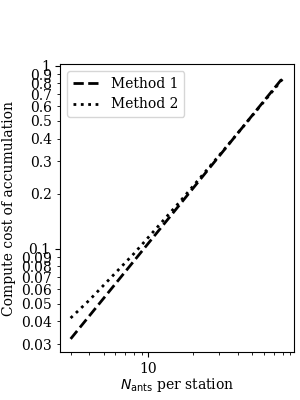

In [60]:
fig = PLT.figure(figsize=(3,4))
ax = fig.add_subplot(111)
ax.plot(nstations, flops_acc_vis_all_stations_method1[nominal_inds_epe_incoherent[0], nominal_inds_epe_incoherent[1],nominal_inds_epe_incoherent[2],:,nominal_inds_epe_incoherent[4],nominal_inds_epe_incoherent[5],nominal_inds_epe_incoherent[6]].to(tflops).value, ls='--', lw=2, color='black', label='Method 1')
ax.plot(nstations, flops_acc_vis_all_stations_method2[nominal_inds_epe_incoherent[0], 0,nominal_inds_epe_incoherent[2],:,nominal_inds_epe_incoherent[4],nominal_inds_epe_incoherent[5],nominal_inds_epe_incoherent[6]].to(tflops).value, ls=':', lw=2, color='black', label='Method 2')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax.set_ylabel('Compute cost of accumulation')
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2g'))
# ax.ticklabel_format(axis='y', style='plain', useOffset=False)
ax.legend()
PLT.subplots_adjust(left=0.2,right=0.98, bottom=0.12, top=0.84)

In [61]:
print(nbeams_fov.shape)
print(station_ngrid.shape)
print(NP.nanmax((station_ngrid / nbeams_fov)))
print(NP.nanmin((station_ngrid / nbeams_fov)))

(1, 24, 11, 15, 11, 14)
(1, 24, 11, 15, 11, 14)
5.882352941176471
2.0


In [62]:
print(npol.reshape(-1,1,1,1,1,1,1)**4 * 4*kernsize.reshape(1,1,1,1,1,-1,1))
print(flops_vis_gridding_all_stations / flops_correlator_stationwise_all_stations)

[[[[[[[ 1.        ]
      [ 1.78024009]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]
      [ 4.        ]]]]]]





 [[[[[[16.        ]
      [28.48384143]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]
      [64.        ]]]]]]]


[[[[[[[3.33333333e+02 3.33333333e+02 3.33333333e+02 ...
                  nan            nan            nan]
      [5.93413363e+02 5.93413363e+02 5.93413363e+02 ...
                  nan            nan            nan]
      [1.33333333e+03 1.33333333e+03            nan ...
                  nan            nan            nan]
      ...
      [           nan            nan            nan ...
                  nan            nan            nan]
      [           nan            nan            nan ...
                  nan            nan            nan]
      [           nan            nan            nan ...
                  nan            nan            nan]]

     [[3.33333333e+02 3.33333333e+02 3.33333333e+02 ...
                  nan            nan            nan]
      [5.93413363e+02 5.93413363e+02 5.93413363e+02 ...
                  nan            nan            nan]
      [1.33333333e+03 1.33333333e+03 1.33333333e+03 ...
                  nan            nan            nan]
      .

## Plot coherent-incoherent computational costs

In [63]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(zcut.size, npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

In [64]:
print("Accumulation intervals:", tacc.si)
print("Antennas per station:", nants_in_station)
print("Antenna diameter (lambda):", ant_dia)
print("Number of stations in array:", nstations)
print("Station diameter (lambda):", station_dia)
print("Array diameter (lambda)", array_dia)
print("Number of polarizations:", npol)
print("Transient z_cut:", zcut)

Accumulation intervals: [1.e-04 1.e-03 1.e-02 1.e-01 1.e+00 1.e+01] s
Antennas per station: [    8    16    32    64    65   128   256   512   625  1024  2048  4096
  8192 16384]
Antenna diameter (lambda): [ 0.25        0.3335641   0.5         1.          2.          2.33494867
  4.          8.         16.         32.         64.        ] wl
Number of stations in array: [   3    4    8   16   32   64   81  128  256  512 1024]
Station diameter (lambda): [   2.            4.            5.83737167    8.            8.08
   16.           17.5          32.           38.5          40.86160166
   64.          128.          256.          512.         1024.        ] wl
Array diameter (lambda) [1.75121150e+02 5.12000000e+02 5.25000000e+02 6.77027500e+02
 1.02400000e+03 1.22584805e+03 2.04800000e+03 4.09600000e+03
 8.19200000e+03 1.16747433e+04 1.63840000e+04 3.27680000e+04
 3.50000000e+04 4.61880215e+04 6.55360000e+04 8.17232033e+04
 1.31072000e+05 2.62144000e+05 5.24288000e+05 1.04857600e+06
 2.

In [65]:
print(tacc)
print(station_dia)
print(ant_dia)
print(nants_in_station)
print(arr_nominal_inds_epe_incoherent)
print(arr_nominal_inds)
print(ant_dia[arr_nominal_inds[4]])
print(mask_pol_arr_sta_ant[arr_nominal_inds[0],0,arr_nominal_inds[2],arr_nominal_inds[3],arr_nominal_inds[4],:,:])
print(mask_pol_arr_sta_ant[arr_nominal_inds[0],0,arr_nominal_inds[2],arr_nominal_inds[3],:,arr_nominal_inds[5],:])

[1.e-04 1.e-03 1.e-02 1.e-01 1.e+00 1.e+01] s
[   2.            4.            5.83737167    8.            8.08
   16.           17.5          32.           38.5          40.86160166
   64.          128.          256.          512.         1024.        ] wl
[ 0.25        0.3335641   0.5         1.          2.          2.33494867
  4.          8.         16.         32.         64.        ] wl
[    8    16    32    64    65   128   256   512   625  1024  2048  4096
  8192 16384]
[np.int64(1), np.int64(1), 0, np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
[np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
4.0 wl
[[ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. nan nan]
 [ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. nan nan nan]
 [ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1. nan nan nan nan]
 [ 1.  1.  1.  1.  1.  1.  1. nan nan nan nan nan nan nan]
 [ 1.  1.  1.  1.  1. nan nan nan nan nan nan nan nan nan]
 [ 1.  1.  1. nan nan nan nan nan nan nan

In [66]:
print(flops_vis_fft_Stokes_imaging_all_stations[arr_nominal_inds[0],arr_nominal_inds[1],arr_nominal_inds[2],arr_nominal_inds[3],:,arr_nominal_inds[5],:].to(tflops))

[[           nan            nan            nan            nan
             nan            nan            nan            nan
             nan            nan            nan            nan
             nan            nan]
 [1.08742944e-03 3.54272544e-03            nan            nan
             nan            nan            nan            nan
             nan            nan            nan            nan
             nan            nan]
 [1.27588823e-03 3.73118423e-03 1.37658722e-02            nan
             nan            nan            nan            nan
             nan            nan            nan            nan
             nan            nan]
 [2.13074504e-03 4.58604104e-03 1.46207290e-02 5.51864890e-02
             nan            nan            nan            nan
             nan            nan            nan            nan
             nan            nan]
 [2.13074504e-03 4.58604104e-03 1.46207290e-02 5.51864890e-02
  5.68945210e-02            nan            nan            nan


In [67]:
# ## EPIC
# fig = PLT.figure(figsize=(3,4))
# ax = fig.add_subplot(111)
# compcost = ax.pcolormesh(nants_in_station, station_dia, flops_epic_Stokes_intensities[arr_nominal_inds[0],arr_nominal_inds[1],arr_nominal_inds[2],:,arr_nominal_inds[4],:].to(tflops), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# # compcost = ax.contourf(nants_in_station, station_dia, flops_epic_Stokes_intensities[arr_nominal_inds[0],arr_nominal_inds[1],arr_nominal_inds[2],:,arr_nominal_inds[4],:].to(tflops), levels=3, norm=PLTC.LogNorm(), cmap='viridis')
# ax.plot(arr1['nants_in_station'], arr1['station_dia'], ls='none', marker='o', ms=6, mec='black', mfc='none', label='ska-low')
# ax.plot(arr2['nants_in_station'], arr2['station_dia'], ls='none', marker='x', ms=6, mec='black', mfc='black', label='vlba-low')
# ax.set_xscale('log')
# ax.set_yscale('log')
# ax.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
# ax.set_ylabel(r'$D_\mathrm{s}$')
# ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# # ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
# # ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2g'))
# # ax.ticklabel_format(axis='y', style='plain', useOffset=False)
# ax.legend()
# PLT.subplots_adjust(left=0.2,right=0.98, bottom=0.12, top=0.84)
# cbax = fig.add_axes([0.2, 0.86, 0.78, 0.03])
# cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('top')
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5)
# print(figdir+'epic_cost.pdf')
# # PLT.savefig(figdir+'epic_cost.pdf', bbox_inches=0)

# ## Correlator-Beamformer-FFT
# fig = PLT.figure(figsize=(3,4))
# ax = fig.add_subplot(111)
# compcost = ax.pcolormesh(nants_in_station, station_dia, flops_vis_fft_Stokes_imaging_all_stations[arr_nominal_inds[0],arr_nominal_inds[1],arr_nominal_inds[2],:,arr_nominal_inds[4],:].to(tflops), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# # compcost = ax.contourf(nants_in_station, station_dia, flops_vis_fft_Stokes_imaging_all_stations[arr_nominal_inds[0],arr_nominal_inds[1],arr_nominal_inds[2],:,arr_nominal_inds[4],:].to(tflops), levels=10, norm=PLTC.LogNorm(), cmap='viridis')
# ax.plot(arr1['nants_in_station'], arr1['station_dia'], ls='none', marker='o', ms=6, mec='black', mfc='none', label='ska-low')
# ax.plot(arr2['nants_in_station'], arr2['station_dia'], ls='none', marker='x', ms=6, mec='black', mfc='black', label='vlba-low')
# ax.set_xscale('log')
# ax.set_yscale('log')
# ax.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
# ax.set_ylabel(r'$D_\mathrm{s}$')
# ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# # ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
# # ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2g'))
# # ax.ticklabel_format(axis='y', style='plain', useOffset=False)
# ax.legend()
# PLT.subplots_adjust(left=0.2,right=0.98, bottom=0.12, top=0.84)
# cbax = fig.add_axes([0.2, 0.86, 0.78, 0.03])
# cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('top')
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
# cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5)
# print(figdir+'correlator_beamformer_fft_cost.pdf')
# # PLT.savefig(figdir+'epic_cost.pdf', bbox_inches=0)

In [68]:
print(flops_fft_voltages_all_stations.shape)
print(flops_gridding_voltages_all_stations.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


In [69]:
print(flops_epic_Stokes_intensities.to(tflops))

[[[[[[[8.01440000e-04 8.02880000e-04 8.05760000e-04 ...
                  nan            nan            nan]
      [8.02563546e-04 8.05127091e-04 8.10254183e-04 ...
                  nan            nan            nan]
      [8.05760000e-04 8.11520000e-04            nan ...
                  nan            nan            nan]
      ...
      [           nan            nan            nan ...
                  nan            nan            nan]
      [           nan            nan            nan ...
                  nan            nan            nan]
      [           nan            nan            nan ...
                  nan            nan            nan]]

     [[5.50701389e-03 5.50845389e-03 5.51133389e-03 ...
                  nan            nan            nan]
      [5.50813744e-03 5.51070098e-03 5.51582807e-03 ...
                  nan            nan            nan]
      [5.51133389e-03 5.51709389e-03 5.52861389e-03 ...
                  nan            nan            nan]
      .

In [70]:
# # flops_epic_Stokes_intensities = flops_gridding_voltages_all_stations + flops_overlap_addition_voltages_all_stations + flops_fft_voltages_all_stations + flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations 

# # start with a square Figure
# fig = PLT.figure(figsize=(4,4.5))

# # Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# # the size of the marginal axes and the main axes in both directions.
# # Also adjust the subplot parameters for a square plot.
# gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
#                       left=0.18, right=0.97, bottom=0.23, top=0.98,
#                       wspace=0.05, hspace=0.05)
# ax10 = fig.add_subplot(gs[1,0])
# # compcost = ax10.contourf(nants_in_station, station_dia, flops_epic_Stokes_intensities[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops), levels=100, norm=PLTC.LogNorm(), cmap='viridis')
# imgvals = flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops)
# log10_min_imgvals = NP.floor(NP.log10(NP.nanmax(imgvals.value)))
# log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals.value)))
# nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
# compcost = ax10.pcolormesh(nants_in_station, station_dia, imgvals.to(tflops).value, norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# # compcost = ax10.contourf(nants_in_station, station_dia, imgvals.value, levels=NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs), norm=PLTC.LogNorm(), cmap='viridis')

# ax10.plot(nants_in_station[arr_ind_nominal_nants_in_station], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
# ax10.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)

# ax10.set_xscale('log')
# ax10.set_yscale('log')
# ax10.set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
# ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
# ax10.set_xlim(xmin=0.95*nants_in_station.min())
# ax10.set_ylim(ymin=0.95*station_dia.min())
# ax10.set_xlim(xmax=1.05*nants_in_station.max())
# ax10.set_ylim(ymax=1.05*station_dia.max())

# # ax10.set_xlim(xmin=5)
# # ax10.set_ylim(ymin=0.08)
# # ax10_yticks = ticker.LogLocator(base=10.0, numticks=5)
# # ax10.yaxis.set_major_locator(ax10_yticks)
# ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# # ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2f'))
# ax10.grid(axis='both', which='both', lw=0.2, color='gray')
# ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
# cbax = fig.add_axes([0.1, 0.01, 0.6, 0.02])
# cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('top')
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
# cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5, fontsize=9)

# ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
# ax00.plot(nants_in_station, flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-', drawstyle='steps-pre', label='total')
# ax00.plot(nants_in_station, flops_gridding_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls=':', lw=2, label='gridding')
# ax00.step(nants_in_station, flops_fft_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, where='mid', color='black', ls='--', label='2D FFT')
# ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_acc_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='blue', ls='-.', label='T-Average')
# ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_ssum[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='orange', ls='-.', label='S-Average')
# ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='magenta', ls='-.', label='square')
# ax00.plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations)[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-.', label='square+avg.')
# ax00.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)

# ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r'$\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
# ax00.set_xlim(xmin=0.95*nants_in_station.min())
# ax00.set_xlim(xmax=1.05*nants_in_station.max())
# # ax00.set_xscale('log')
# ax00.set_yscale('log')
# ax00.grid(axis='both', which='both', lw=0.2, color='gray')
# ax00_yticks = ticker.LogLocator(base=10.0, numticks=5)
# ax00.yaxis.set_major_locator(ax00_yticks)
# ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
# ax00.tick_params(axis='x', labelbottom=False)
# # ax00.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
# ax00.set_ylabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

# ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
# ax11.plot(flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-', drawstyle='steps-pre', label='total')
# ax11.plot(flops_fft_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='--', drawstyle='steps-pre', label='FFT')
# ax11.plot(flops_gridding_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls=':', lw=2, label='gridding')
# # ax11.vlines(flops_gridding_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops).value, ymin=station_dia.min(), ymax=station_dia.max(), color='black', ls=':', lw=2, label='grid')
# ax11.plot((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations + flops_epic_pixelwise_Stokes_intensity_ssum)[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-.', drawstyle='steps-pre', label='square+avg.')
# ax11.plot(flops_epic_pixelwise_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='magenta', ls='-.', drawstyle='steps-pre', label='square')
# ax11.plot(flops_epic_pixelwise_Stokes_intensity_acc_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='blue', ls='-.', drawstyle='steps-pre', label='T-Average')
# ax11.plot(flops_epic_pixelwise_Stokes_intensity_ssum[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='orange', ls='-.', label='S-Average')
# # ax11.axvline(flops_fft_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,0].to(tflops).value, color='black', ls='--', drawstyle='steps-pre', label='2D FFT')
# ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)

# ax11.text(0.03, 0.01, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
# ax11.set_xscale('log')
# # ax11.set_xlim(xmin=0.10001)
# ax11.grid(axis='both', which='both', lw=0.2, color='gray')
# ax11_xticks = ticker.LogLocator(base=10.0, numticks=5)
# ax11.xaxis.set_major_locator(ax11_xticks)
# ax11.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# # ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax11.tick_params(axis='y', labelleft=False)
# # ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
# ax11.set_xlabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

# ax01 = fig.add_subplot(gs[0,1])
# PLT.setp(ax01.spines.values(), visible=False) 
# ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
# handles, labels = ax11.get_legend_handles_labels()
# ax01.legend(handles=handles, labels=labels, loc='upper left', handlelength=4, labelspacing=0, fontsize=8.5, frameon=False, fancybox=False, shadow=False, borderaxespad=0)
# ax01.text(0.01, 0.0, r'$\delta$f='+'{0:.1f} kHz'.format(df.to('kHz').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
# ax01.text(0.01, 0.08, 'Polarisations: {0:0d}'.format(npol[arr_ind_nominal_npol]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
# ax01.text(0.01, 0.16, 'Padding factor: 2.0', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
# ax01.text(0.01, 0.24, '{0:0d} stations'.format(nstations[arr_ind_nominal_nstations]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
# ax01.text(0.01, 0.32, 'Antenna size={0:.1g}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# # PLT.savefig(figdir+'epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
# print('Saved at: '+figdir+'epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

In [71]:
print(station_dia.decompose().value.dtype)

float128


Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/epic_cost_analysis_LAMBDA-I.pdf


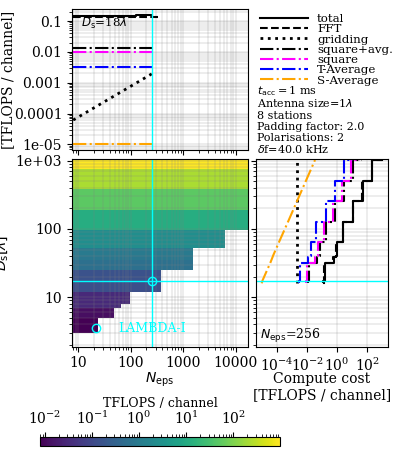

In [72]:
# flops_epic_Stokes_intensities = flops_gridding_voltages_all_stations + flops_overlap_addition_voltages_all_stations + flops_fft_voltages_all_stations + flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations 

# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.18, right=0.97, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)

ax10 = fig.add_subplot(gs[1,0])
# compcost = ax10.contourf(nants_in_station, station_dia, flops_epic_Stokes_intensities[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops), levels=100, norm=PLTC.LogNorm(), cmap='viridis')
imgvals = flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops)
log10_min_imgvals = NP.floor(NP.log10(NP.nanmax(imgvals.value)))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals.value)))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(nants_in_station, station_dia.decompose().value.astype(float), imgvals.value.astype(float), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.contourf(nants_in_station, station_dia, imgvals.value, levels=NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs), norm=PLTC.LogNorm(), cmap='viridis')

ax10.plot(nants_in_station[arr_ind_nominal_nants_in_station], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)

ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
ax10.set_xlim(xmin=0.95*nants_in_station.min())
ax10.set_ylim(ymin=0.95*station_dia.min())
ax10.set_xlim(xmax=1.05*nants_in_station.max())
ax10.set_ylim(ymax=1.05*station_dia.max())

# ax10.set_xlim(xmin=5)
# ax10.set_ylim(ymin=0.08)
# ax10_yticks = ticker.LogLocator(base=10.0, numticks=5)
# ax10.yaxis.set_major_locator(ax10_yticks)
ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2f'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.1, 0.01, 0.6, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5, fontsize=9)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(nants_in_station, flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-', drawstyle='steps-pre', label='total')
ax00.plot(nants_in_station, flops_gridding_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls=':', lw=2, label='gridding')
ax00.step(nants_in_station, flops_fft_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, where='mid', color='black', ls='--', label='2D FFT')
ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_acc_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='blue', ls='-.', label='T-Average')
ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_ssum[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='orange', ls='-.', label='S-Average')
ax00.plot(nants_in_station, flops_epic_pixelwise_Stokes_intensity_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='magenta', ls='-.', label='square')
ax00.plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations)[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-.', label='square+avg.')
ax00.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)

ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r'$\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
ax00.set_xlim(xmin=0.95*nants_in_station.min())
ax00.set_xlim(xmax=1.05*nants_in_station.max())
# ax00.set_xscale('log')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=5)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
ax00.tick_params(axis='x', labelbottom=False)
# ax00.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax00.set_ylabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(flops_epic_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-', drawstyle='steps-pre', label='total')
ax11.plot(flops_fft_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='--', drawstyle='steps-pre', label='FFT')
ax11.plot(flops_gridding_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls=':', lw=2, label='gridding')
# ax11.vlines(flops_gridding_voltages_all_stations[arr_ind_nominal_npol,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops).value, ymin=station_dia.min(), ymax=station_dia.max(), color='black', ls=':', lw=2, label='grid')
ax11.plot((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations + flops_epic_pixelwise_Stokes_intensity_ssum)[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-.', drawstyle='steps-pre', label='square+avg.')
ax11.plot(flops_epic_pixelwise_Stokes_intensity_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='magenta', ls='-.', drawstyle='steps-pre', label='square')
ax11.plot(flops_epic_pixelwise_Stokes_intensity_acc_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='blue', ls='-.', drawstyle='steps-pre', label='T-Average')
ax11.plot(flops_epic_pixelwise_Stokes_intensity_ssum[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='orange', ls='-.', label='S-Average')
# ax11.axvline(flops_fft_voltages_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,0].to(tflops).value, color='black', ls='--', drawstyle='steps-pre', label='2D FFT')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)

ax11.text(0.03, 0.01, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
ax11.set_xscale('log')
# ax11.set_xlim(xmin=0.10001)
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=5)
ax11.xaxis.set_major_locator(ax11_xticks)
ax11.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
handles, labels = ax11.get_legend_handles_labels()
ax01.legend(handles=handles, labels=labels, loc='upper left', handlelength=4, labelspacing=0, fontsize=8.5, frameon=False, fancybox=False, shadow=False, borderaxespad=0)
ax01.text(0.01, -0.03, r'$\delta$f='+'{0:.1f} kHz'.format(df.to('kHz').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.05, 'Polarisations: {0:0d}'.format(npol[arr_ind_nominal_npol]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.13, 'Padding factor: 2.0', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.21, '{0:0d} stations'.format(nstations[arr_ind_nominal_nstations]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.29, 'Antenna size={0:.1g}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.37, r'$t_\mathrm{acc}=$'+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/FX_fft_cost_analysis_LAMBDA-I.pdf


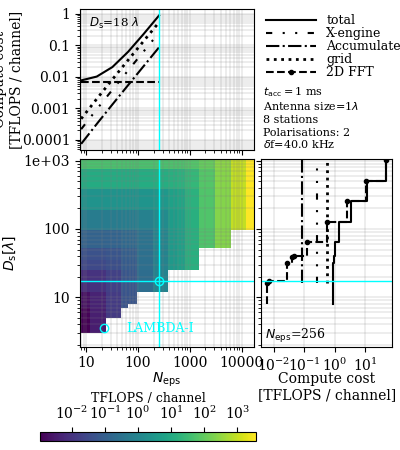

In [73]:
# flops_vis_fft_Stokes_imaging_stationwise_all_stations = flops_correlator_stationwise_all_stations + flops_acc_vis_stationwise_all_stations + flops_vis_gridding_stationswise_all_stations + flops_vis_fft_Stokes_intensity_stationwise_all_stations

# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.2, right=0.98, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)
ax10 = fig.add_subplot(gs[1,0])

# compcost = ax10.pcolormesh(nants_in_station, station_dia, flops_vis_fft_Stokes_imaging_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
imgvals = flops_vis_fft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops)
log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(nants_in_station, station_dia.value.astype(float), imgvals.value.astype(float), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.contourf(nants_in_station, station_dia, imgvals, levels=NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs), norm=PLTC.LogNorm(), cmap='viridis', corner_mask=False)
ax10.plot(nants_in_station[arr_ind_nominal_nants_in_station], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
ax10.set_xlim(xmin=0.95*nants_in_station.min())
ax10.set_ylim(ymin=0.95*station_dia.min())
ax10.set_xlim(xmax=1.05*nants_in_station.max())
ax10.set_ylim(ymax=1.05*station_dia.max())

ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.1, 0.02, 0.54, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5, fontsize=9)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(nants_in_station, flops_vis_fft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, color='black', ls='-', label='total')
ax00.plot(nants_in_station, flops_correlator_stationwise_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
ax00.plot(nants_in_station, flops_acc_vis_all_stations_method1[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, color='black', ls='-.', label='Accumulate')
ax00.plot(nants_in_station, flops_vis_gridding_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, color='black', ls=':', lw=2, label='grid')
# ax00.axhline(flops_vis_fft_Stokes_intensity_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,0].to(tflops).value, color='black', ls='--', drawstyle='steps-post', marker='o', ms=3, label='2D FFT')
ax00.plot(nants_in_station, flops_vis_fft_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops).value, color='black', ls='--', label='2D FFT')
ax00.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r' $\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=7)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
ax00.tick_params(axis='x', labelbottom=False)
# ax00.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax00.set_ylabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(flops_vis_fft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-', drawstyle='steps-post', label='total')
ax11.plot(flops_correlator_stationwise_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
ax11.plot(flops_acc_vis_all_stations_method1[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-.', label='Accumulate')
ax11.plot(flops_vis_gridding_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls=':', lw=2, label='grid')

ax11.plot(flops_vis_fft_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='--', drawstyle='steps-post', marker='o', ms=3, label='2D FFT')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax11.text(0.03, 0.01, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
ax11.set_xscale('log')
# ax11.set_yscale('log')
# ax11.set_xlim(xmin=0.05)
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=5)
ax11.xaxis.set_major_locator(ax11_xticks)
# ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
handles, labels = ax11.get_legend_handles_labels()
ax01.legend(handles=handles, labels=labels, loc='upper left', handlelength=4, labelspacing=0, fontsize=9, frameon=False, fancybox=False, shadow=False, borderaxespad=0)
ax01.text(0.01, 0.0, r'$\delta$f='+'{0:.1f} kHz'.format(df.to('kHz').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.09, 'Polarisations: {0:0d}'.format(npol[arr_ind_nominal_npol]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.18, '{0:0d} stations'.format(nstations[arr_ind_nominal_nstations]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.27, 'Antenna size={0:.1g}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.36, r'$t_\mathrm{acc}=$'+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'FX_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'FX_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/FX_dft_cost_analysis_LAMBDA-I.pdf


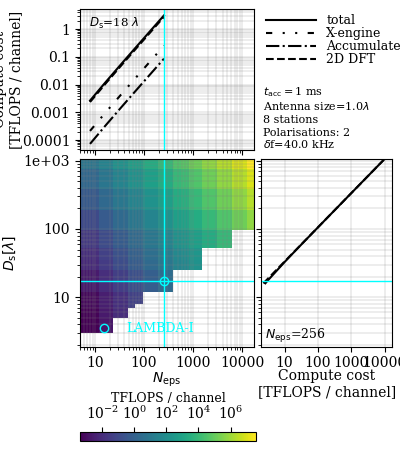

In [74]:
# flops_vis_dft_Stokes_imaging_stationwise_all_stations = flops_correlator_stationwise_all_stations + flops_acc_vis_stationwise_all_stations + flops_vis_gridding_stationswise_all_stations + flops_vis_dft_Stokes_intensity_stationwise_all_stations

# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.2, right=0.98, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)
ax10 = fig.add_subplot(gs[1,0])

imgvals = flops_vis_dft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops)
log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(nants_in_station, station_dia.value.astype(float), imgvals.value.astype(float), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.pcolormesh(nants_in_station, station_dia, flops_vis_dft_Stokes_imaging_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
ax10.plot(nants_in_station[arr_ind_nominal_nants_in_station], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
ax10.set_xlim(xmin=0.95*nants_in_station.min())
ax10.set_ylim(ymin=0.95*station_dia.min())
ax10.set_xlim(xmax=1.05*nants_in_station.max())
ax10.set_ylim(ymax=1.05*station_dia.max())
ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1g'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.2, 0.02, 0.44, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5, fontsize=9)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(nants_in_station, flops_vis_dft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-', label='total')
ax00.plot(nants_in_station, flops_correlator_stationwise_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
ax00.plot(nants_in_station, flops_acc_vis_all_stations_method1[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-.', label='Accumulate')
ax00.plot(nants_in_station, flops_vis_dft_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='--', label='2D DFT')
ax00.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r' $\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
ax00.set_xlim(xmin=5)
# ax00.set_xscale('log')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=7)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
ax00.tick_params(axis='x', labelbottom=False)
ax00.set_ylabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(flops_vis_dft_Stokes_imaging_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-', label='total')
ax11.plot(flops_correlator_stationwise_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
ax11.plot(flops_acc_vis_all_stations_method1[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-.', label='Accumulate')
ax11.plot(flops_vis_dft_Stokes_intensity_all_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='--', label='2D DFT')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax11.text(0.03, 0.01, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
ax11.set_xscale('log')
# ax11.set_yscale('log')
ax11.set_xlim(xmin=2)
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=5)
ax11.xaxis.set_major_locator(ax11_xticks)
ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
handles, labels = ax11.get_legend_handles_labels()
ax01.legend(handles=handles, labels=labels, loc='upper left', handlelength=4, labelspacing=0, fontsize=9, frameon=False, fancybox=False, shadow=False, borderaxespad=0)
ax01.text(0.01, 0.0, r'$\delta$f='+'{0:.1f} kHz'.format(df.to('kHz').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.09, 'Polarisations: {0:0d}'.format(npol[arr_ind_nominal_npol]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.18, '{0:0d} stations'.format(nstations[arr_ind_nominal_nstations]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.27, 'Antenna size={0:.1f}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.36, r'$t_\mathrm{acc}=$'+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'FX_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'FX_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/beamformer_dft_cost_analysis_LAMBDA-I.pdf


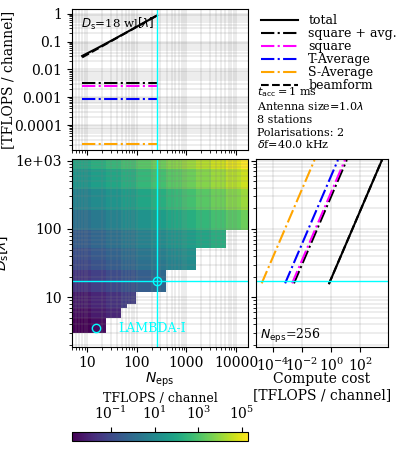

In [75]:
# flops_beamform_Stokes_intensities = flops_beamform_voltage_all_stations + flops_beamform_Stokes_intensity_all_stations + flops_beamform_Stokes_intensity_acc_stations

# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.18, right=0.97, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)
ax10 = fig.add_subplot(gs[1,0])

imgvals = flops_beamform_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops)
log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(nants_in_station, station_dia.value.astype(float), imgvals.value.astype(float), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.pcolormesh(nants_in_station, station_dia, flops_beamform_Stokes_intensities[arr_ind_nominal_npol,0,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,:].to(tflops), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
ax10.plot(nants_in_station[arr_ind_nominal_nants_in_station], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
ax10.set_xlim(xmin=0.95*nants_in_station.min())
ax10.set_ylim(ymin=0.95*station_dia.min())
ax10.set_xlim(xmax=1.05*nants_in_station.max())
ax10.set_ylim(ymax=1.05*station_dia.max())
ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.18, 0.02, 0.44, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
cbar.set_label('TFLOPS / channel', labelpad=-35, x=0.5, fontsize=9)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(nants_in_station, flops_beamform_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-', label='total')
ax00.plot(nants_in_station, (flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations)[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='-.', label='square + avg.')
ax00.plot(nants_in_station, flops_beamform_Stokes_intensity_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='magenta', ls='-.', label='square')
ax00.plot(nants_in_station, flops_beamform_Stokes_intensity_tsum_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='blue', ls='-.', label='T-Average')
ax00.plot(nants_in_station, flops_beamform_Stokes_intensity_ssum_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='orange', ls='-.', label='S-Average')
ax00.plot(nants_in_station, flops_beamform_voltage_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(tflops), color='black', ls='--', label='beamform')
ax00.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia])+r'$ [\lambda]$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
ax00.set_xlim(xmin=5)
# ax00.set_xscale('log')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=7)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
ax00.tick_params(axis='x', labelbottom=False)
ax00.set_ylabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(flops_beamform_Stokes_intensities[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='-', label='total')
ax11.plot((flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations)[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops).value, station_dia, color='black', ls='-.', label='square + avg.')
ax11.plot(flops_beamform_Stokes_intensity_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='magenta', ls='-.', label='square')
ax11.plot(flops_beamform_Stokes_intensity_tsum_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='blue', ls='-.', label='T-Average')
ax11.plot(flops_beamform_Stokes_intensity_ssum_stations[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='orange', ls='-.', label='S-Average')
ax11.plot(flops_beamform_voltage_all_stations[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(tflops), station_dia, color='black', ls='--', label='beamform')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax11.text(0.03, 0.01, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
ax11.set_xscale('log')
# ax11.set_yscale('log')
# ax11.set_xlim(xmin=0.02)
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=7)
ax11.xaxis.set_major_locator(ax11_xticks)
# ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('Compute cost\n[TFLOPS / channel]', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
handles, labels = ax11.get_legend_handles_labels()
ax01.legend(handles=handles, labels=labels, loc='upper left', handlelength=3, labelspacing=0, fontsize=9, frameon=False, fancybox=False, shadow=False, borderaxespad=0)
ax01.text(0.01, 0.0, r'$\delta$f='+'{0:.1f} kHz'.format(df.to('kHz').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.09, 'Polarisations: {0:0d}'.format(npol[arr_ind_nominal_npol]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.18, '{0:0d} stations'.format(nstations[arr_ind_nominal_nstations]), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.27, 'Antenna size={0:.1f}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')
ax01.text(0.01, 0.36, r'$t_\mathrm{acc}=$'+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/beamformer_correlator_epic_cost_comparison_nants_in_station.pdf


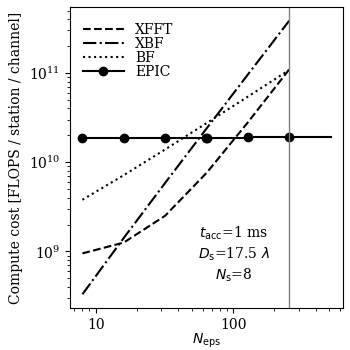

In [76]:
fig = PLT.figure(figsize=(3.5,3.5))
ax = fig.add_subplot(111)
ax.plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(flops), color='black', ls='--', label='XFFT')
ax.plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(flops), color='black', ls='-.', label='XBF')
ax.plot(nants_in_station, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(flops), color='black', ls=':', label='BF')
ax.plot(nants_in_station, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(flops), color='black', marker='o', ls='-', drawstyle='steps-post', label='EPIC')
ax.axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='gray', ls='-', lw=1)
ax.text(0.6, 0.22, r'$t_\mathrm{acc}$='+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=10, transform=ax.transAxes, ha='center', va='bottom')
ax.text(0.6, 0.15, r'$D_\mathrm{s}$='+'{0:.3g}'.format(station_dia[arr_ind_nominal_station_dia].decompose().value)+r' $\lambda$', fontsize=10, transform=ax.transAxes, ha='center', va='bottom')
ax.text(0.6, 0.08, r'$N_\mathrm{s}$='+'{0:0d}'.format(nstations[arr_ind_nominal_nstations]), fontsize=10, transform=ax.transAxes, ha='center', va='bottom')
ax.set_xscale('log')
ax.set_yscale('log')
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax.set_xlabel(r'$N_\mathrm{eps}$', labelpad=0)
ax.set_ylabel('Compute cost [FLOPS / station / channel]')
ax.legend(loc='upper left', bbox_to_anchor=(0.0, 0.99), handlelength=3, ncol=1, fontsize=10, frameon=False, labelspacing=0, fancybox=True, shadow=False)
PLT.subplots_adjust(left=0.2,right=0.98, bottom=0.12, top=0.98)
# PLT.savefig(figdir+'beamformer_correlator_cost_comparison_nants_in_station.pdf', bbox_inches=0)
print('Saved at: '+figdir+'beamformer_correlator_epic_cost_comparison_nants_in_station.pdf')

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/beamformer_correlator_epic_cost_comparison_station_dia.pdf


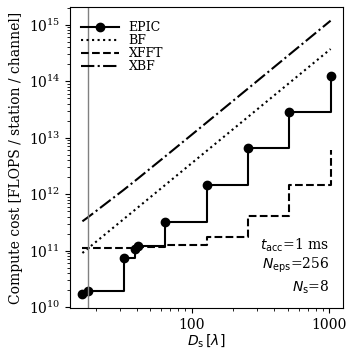

In [77]:
fig = PLT.figure(figsize=(3.5,3.5))
ax = fig.add_subplot(111)
ax.plot(station_dia, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(flops), color='black', marker='o', ls='-', drawstyle='steps-post', label='EPIC')
ax.plot(station_dia, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(flops), color='black', ls=':', label='BF')
ax.plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(flops), color='black', ls='--', drawstyle='steps-post', label='XFFT')
ax.plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(flops), color='black', ls='-.', label='XBF')
ax.axvline(station_dia[arr_ind_nominal_station_dia], color='gray', ls='-', lw=1)
ax.text(0.95, 0.18, r'$t_\mathrm{acc}$='+'{0:.1g} ms'.format(tacc[arr_ind_nominal_tacc].to('ms').value), fontsize=10, transform=ax.transAxes, ha='right', va='bottom')
ax.text(0.95, 0.11, r'$N_\mathrm{eps}$='+'{0:0d}'.format(nants_in_station[arr_ind_nominal_nants_in_station]), fontsize=10, transform=ax.transAxes, ha='right', va='bottom')
ax.text(0.95, 0.04, r'$N_\mathrm{s}$='+'{0:0d}'.format(nstations[arr_ind_nominal_nstations]), fontsize=10, transform=ax.transAxes, ha='right', va='bottom')
ax.set_xscale('log')
ax.set_yscale('log')
ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
ax.set_xlabel(r'$D_\mathrm{s} \, [\lambda]$', labelpad=0)
ax.set_ylabel('Compute cost [FLOPS / station / channel]')
ax.legend(loc='upper left', bbox_to_anchor=(0.0, 0.99), ncol=1, handlelength=3, labelspacing=0, fontsize=9, frameon=False, fancybox=True, shadow=False)
PLT.subplots_adjust(left=0.2,right=0.98, bottom=0.12, top=0.98)
# PLT.savefig(figdir+'beamformer_correlator_cost_comparison_station_dia.pdf', bbox_inches=0)
print('Saved at: '+figdir+'beamformer_correlator_epic_cost_comparison_station_dia.pdf')

In [78]:
print(nbeams_fov.shape)
print(arr_ind_nominal_nstations)
print(arr_ind_nominal_array_dia)
print(arr_ind_nominal_station_dia)
print(arr_ind_nominal_ant_dia)
print(arr_ind_nominal_nants_in_station)

(1, 24, 11, 15, 11, 14)
2
21
6
3
6


In [79]:
print(nbeams_fov.shape)

(1, 24, 11, 15, 11, 14)


Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/nbeams_fov_analysis.pdf


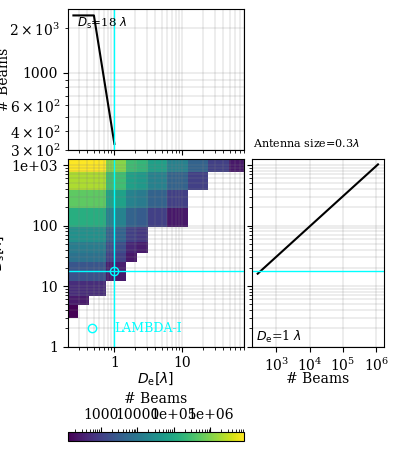

In [80]:
# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.17, right=0.96, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)
ax10 = fig.add_subplot(gs[1,0])

imgvals = nbeams_fov[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,:,arr_ind_nominal_nants_in_station]
log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(ant_dia.decompose().value.astype(float), station_dia.decompose().value.astype(float), imgvals.astype(float), norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.pcolormesh(ant_dia, station_dia, nbeams_fov[0,0,:,:,0], norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
ax10.plot(ant_dia[arr_ind_nominal_ant_dia], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$D_\mathrm{e} [\lambda]$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
# ax10.set_xlim(xmin=5)
# ax10.set_ylim(ymin=0.08)
ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.17, 0.02, 0.44, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
cbar.set_label('# Beams', labelpad=-35, x=0.5, fontsize=10)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(ant_dia, nbeams_fov[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station], color='black', ls='-')
ax00.axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
ax00.text(0.05, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r' $\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='left', va='top')
# ax00.set_xlim(xmin=5)
# ax00.set_xscale('log')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=7)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
ax00.tick_params(axis='x', labelbottom=False)
ax00.set_ylabel('# Beams', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(nbeams_fov[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station], station_dia, color='black', ls='-')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax11.text(0.03, 0.01, r'$D_\mathrm{e}$='+'{0:.2g}'.format(ant_dia[arr_ind_nominal_ant_dia].value)+r' $\lambda$', fontsize=9, transform=ax11.transAxes, ha='left', va='bottom')
ax11.set_xscale('log')
# ax11.set_yscale('log')
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=7)
ax11.xaxis.set_major_locator(ax11_xticks)
# ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('# Beams', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
ax01.text(0.01, 0.01, 'Antenna size={0:.1g}'.format(ant_dia[1].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'nbeams_fov_analysis.pdf', bbox_inches=0)
print('Saved at: '+figdir+'nbeams_fov_analysis.pdf')

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/station_ngrid_analysis.pdf


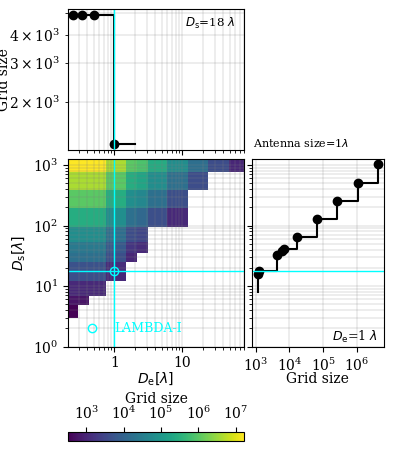

In [81]:
# start with a square Figure
fig = PLT.figure(figsize=(4,4.5))

# Add a gridspec with two rows and two columns and a ratio of 2 to 7 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(1.33,1), height_ratios=(1,1.33),
                      left=0.17, right=0.96, bottom=0.23, top=0.98,
                      wspace=0.05, hspace=0.05)
ax10 = fig.add_subplot(gs[1,0])

imgvals = station_ngrid[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,:,arr_ind_nominal_nants_in_station]
log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
nlevs = 2*int(log10_max_imgvals - log10_min_imgvals) + 1
compcost = ax10.pcolormesh(ant_dia.decompose().value.astype(float), station_dia.decompose().value.astype(float), imgvals, norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
# compcost = ax10.pcolormesh(ant_dia, station_dia, station_ngrid[0,0,:,:,0], norm=PLTC.LogNorm(), shading='nearest', cmap='viridis')
ax10.plot(ant_dia[arr_ind_nominal_ant_dia], station_dia[arr_ind_nominal_station_dia], ls='none', marker='o', ms=6, mec='cyan', mfc='none', label=arrs[chosen_arr]['name'])
ax10.axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
ax10.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax10.set_xscale('log')
ax10.set_yscale('log')
ax10.set_xlabel(r'$D_\mathrm{e} [\lambda]$', fontsize=10, labelpad=0)
ax10.set_ylabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10)
# ax10.set_xlim(xmin=5)
# ax10.set_ylim(ymin=0.08)
ax10.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
# ax10.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.1g'))
# ax10.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
ax10.grid(axis='both', which='both', lw=0.2, color='gray')
ax10.legend(bbox_to_anchor=[0.001, 0.001], loc='lower left', fontsize=9, labelcolor='cyan', frameon=False, fancybox=False, shadow=False)
cbax = fig.add_axes([0.17, 0.02, 0.44, 0.02])
cbar = PLT.colorbar(compcost, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('top')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
cbar.set_label('Grid size', labelpad=-35, x=0.5, fontsize=10)

ax00 = fig.add_subplot(gs[0,0], sharex=ax10)
ax00.plot(ant_dia, station_ngrid[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station], color='black', ls='-', drawstyle='steps-post', marker='o')
ax00.axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
ax00.text(0.95, 0.95, r'$D_\mathrm{s}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia].value)+r' $\lambda$', fontsize=8.5, transform=ax00.transAxes, ha='right', va='top')
# ax00.set_xlim(xmin=5)
# ax00.set_xscale('log')
ax00.set_yscale('log')
ax00.grid(axis='both', which='both', lw=0.2, color='gray')
ax00_yticks = ticker.LogLocator(base=10.0, numticks=7)
ax00.yaxis.set_major_locator(ax00_yticks)
ax00.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
# ax00.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
ax00.tick_params(axis='x', labelbottom=False)
ax00.set_ylabel('Grid size', fontsize=10, labelpad=-1)

ax11 = fig.add_subplot(gs[1,1], sharey=ax10)
ax11.plot(station_ngrid[0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station], station_dia, color='black', ls='-', drawstyle='steps-post', marker='o')
ax11.axhline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
ax11.text(0.95, 0.01, r'$D_\mathrm{e}$='+'{0:.2g}'.format(ant_dia[arr_ind_nominal_ant_dia].value)+r' $\lambda$', fontsize=9, transform=ax11.transAxes, ha='right', va='bottom')
ax11.set_xscale('log')
# ax11.set_yscale('log')
ax11.grid(axis='both', which='both', lw=0.2, color='gray')
ax11_xticks = ticker.LogLocator(base=10.0, numticks=7)
ax11.xaxis.set_major_locator(ax11_xticks)
# ax11.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.5g'))
ax11.tick_params(axis='y', labelleft=False)
# ax11.set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
ax11.set_xlabel('Grid size', fontsize=10, labelpad=-1)

ax01 = fig.add_subplot(gs[0,1])
PLT.setp(ax01.spines.values(), visible=False) 
ax01.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)
ax01.text(0.01, 0.01, 'Antenna size={0:.2g}'.format(ant_dia[arr_ind_nominal_ant_dia].to(wl).value)+r'$\lambda$', fontsize=8, transform=ax01.transAxes, ha='left', va='bottom')

# PLT.savefig(figdir+'station_ngrid_analysis.pdf', bbox_inches=0)
print('Saved at: '+figdir+'station_ngrid_analysis.pdf')

## Multi-dimensional slices of coherent-incoherent imaging computational costs

In [82]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(npol.size, tacc.size, nbeams.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

axs_labels = [r'$n_\mathrm{p}$', r'$t_\mathrm{acc}$'+' [s]', r'$D_\mathrm{A}\,\, [\lambda]$', r'$N_\mathrm{s}$', r'$D_\mathrm{s}\,\, [\lambda]$', r'$D_\mathrm{e}\,\, [\lambda]$', r'$N_\mathrm{eps}$']
axs_scales = ['linear', 'log', 'log', 'log', 'log', 'log', 'log']
axs_vals = [npol, tacc.si.value.astype(float), array_dia.decompose().value.astype(float), nstations, station_dia.decompose().value.astype(float), ant_dia.decompose().value.astype(float), nants_in_station]
axs_min = []*len(axs_vals)
axs_max = []*len(axs_vals)
for axi,axv in enumerate(axs_vals):
    if axi == 2:
        if chosen_arr in [2,3]:
            axs_min += [2**NP.mean(NP.log2(array_dia.to(wl).value)) * wl]
            axs_max += [1.05*axv.max()]            
        else:
            axs_min += [0.95*axv.min()]
            axs_max += [2**NP.mean(NP.log2(array_dia.to(wl).value)) * wl]
    else:
        axs_min += [0.95*NP.nanmin(axv)]
        axs_max += [1.05*NP.nanmax(axv)]

axes_to_plot_img_incoherent = NP.array([4,5,6])
# axes_to_plot_img_incoherent = NP.array([1,4,5,6])

slices_compcost_stationwise_beamforming = multidim_corner_plot_info(flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_epic = multidim_corner_plot_info(flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_xcor_dft = multidim_corner_plot_info(flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_xcor_fft = multidim_corner_plot_info(flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)

slices_compcost_stationwise_beamforming_per_pixel = multidim_corner_plot_info(flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_epic_per_pixel = multidim_corner_plot_info(flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_xcor_dft_per_pixel = multidim_corner_plot_info(flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)
slices_compcost_stationwise_xcor_fft_per_pixel = multidim_corner_plot_info(flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1), axes=axes_to_plot_img_incoherent, nominal_inds=arr_nominal_inds)

In [83]:
print(chosen_arr)
print(arrs[chosen_arr])

2
{'name': 'LAMBDA-I', 'nstations': 8, 'nants_in_station': 256, 'npol': 2, 'wvlen': <Quantity 1. m>, 'ant_dia': <Quantity 1.>, 'station_dia': <Quantity 17.5>, 'array_dia': <Quantity 3900. km / m>, 'ff_in_station': <Quantity 0.83591837>, 'ff_in_array': <Quantity 1.61078238e-10>}


In [84]:
print(axs_min)
print(axs_max)

[np.float64(0.95), np.float64(9.5e-05), <Quantity 31347.874985 wl>, np.float64(2.8499999999999996), np.float64(1.9), np.float64(0.2375), np.float64(7.6)]
[np.float64(2.1), np.float64(10.5), np.float64(8808038.4), np.float64(1075.2), np.float64(1075.2), np.float64(67.2), np.float64(17203.2)]


## Multi-dimensional plots of coherent-incoherent imaging computational costs

In [85]:
cntr_log_fmt = ticker.LogFormatterSciNotation()
major_tick_log_fmt = ticker.LogFormatterMathtext()
major_tick_log_locs = ticker.LogLocator(base=10.0, subs=(0.1,1.0,10.0), numticks=21)
minor_tick_log_sublocs = ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,6,7,8,9),numticks=25)
minor_tick_log_baselocs = ticker.LogLocator(base=10.0, subs=(0.1,1.0,10.0), numticks=21)

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_beamformer_dft_cost_analysis_LAMBDA-I.pdf


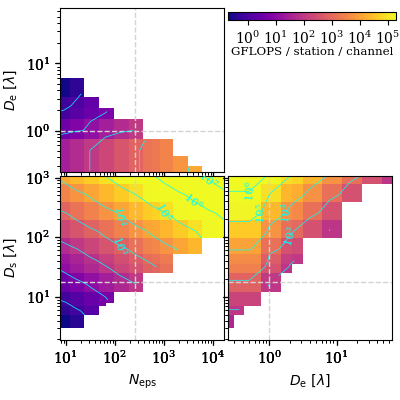

In [86]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_beamforming:
    yax, xax = slices_compcost_stationwise_beamforming[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_beamforming[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterSciNotation()
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    # ax.xaxis.set_major_formatter(ticker.LogFormatterMathtext())
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    # majorticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
    # ax.xaxis.set_major_locator(majorticks)
    # ax.yaxis.set_major_locator(majorticks)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    # minorticks = ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=11)
    # ax.xaxis.set_minor_locator(minorticks)
    # ax.yaxis.set_minor_locator(minorticks)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

PLT.savefig(figdir+'multidim_beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_beamformer_dft_per_pixel_cost_analysis_LAMBDA-I.pdf


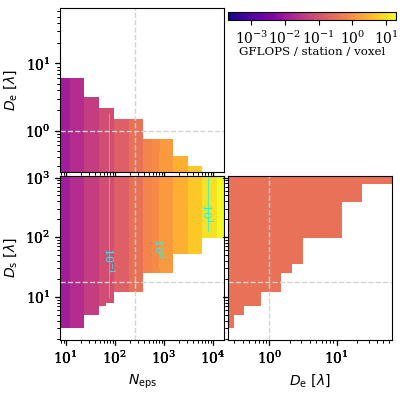

In [ ]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_beamforming_per_pixel:
    yax, xax = slices_compcost_stationwise_beamforming_per_pixel[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_beamforming_per_pixel[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterSciNotation()
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    # ax.xaxis.set_major_formatter(ticker.LogFormatterMathtext())
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    # majorticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
    # ax.xaxis.set_major_locator(majorticks)
    # ax.yaxis.set_major_locator(majorticks)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    # minorticks = ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=11)
    # ax.xaxis.set_minor_locator(minorticks)
    # ax.yaxis.set_minor_locator(minorticks)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / voxel', labelpad=0, x=0.5, fontsize=8.5)

PLT.savefig(figdir+'multidim_beamformer_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_beamformer_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_beamformer_dft_cost_analysis_LAMBDA-I.pdf


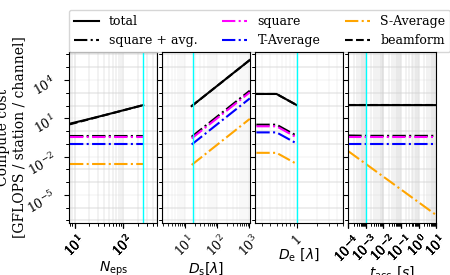

In [88]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, ((flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations+flops_beamform_Stokes_intensity_ssum_stations)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='square + avg.')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='magenta', ls='-.', label='square')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_tsum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='blue', ls='-.', label='T-Average')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_ssum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='orange', ls='-.', label='S-Average')
axs[0].plot(nants_in_station, (flops_beamform_voltage_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='beamform')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax0_yticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / channel]', fontsize=10, labelpad=-1)
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].legend(ncol=3, loc=[0.0, 1.0], fontsize=9)

axs[1].plot(station_dia, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[1].plot(station_dia, ((flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations+flops_beamform_Stokes_intensity_ssum_stations)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', label='square')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_tsum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', label='T-Average')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_ssum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[1].plot(station_dia, (flops_beamform_voltage_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='beamform')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_yscale('log')
axs[1].set_xscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax1_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[1].xaxis.set_major_locator(ax1_xticks)
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[1].set_xlabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, ((flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations+flops_beamform_Stokes_intensity_ssum_stations)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', label='square')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_tsum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', label='T-Average')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_ssum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[2].plot(ant_dia, (flops_beamform_voltage_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='beamform')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_yscale('log')
axs[2].set_xscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax2_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[2].xaxis.set_major_locator(ax2_xticks)
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=-1)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].plot(tacc.si, ((flops_beamform_Stokes_intensity_all_stations+flops_beamform_Stokes_intensity_tsum_stations+flops_beamform_Stokes_intensity_ssum_stations)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[3].axhline((flops_beamform_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='magenta', ls='-.', label='square')
axs[3].axhline((flops_beamform_Stokes_intensity_tsum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='blue', ls='-.', label='T-Average')
axs[3].plot(tacc.si, (flops_beamform_Stokes_intensity_ssum_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[3].axhline((flops_beamform_voltage_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls='--', label='beamform')
axs[3].axvline(tacc.si.value[arr_ind_nominal_tacc], color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_yscale('log')
axs[3].set_xscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)
# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)
axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)
# ax3[0].yaxis.set_major_locator(major_tick_log_locs)
axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.153, top=0.81, wspace=0.05)

PLT.savefig(figdir+'1D_beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_beamformer_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_beamformer_dft_per_pixel_cost_analysis_LAMBDA-I.pdf


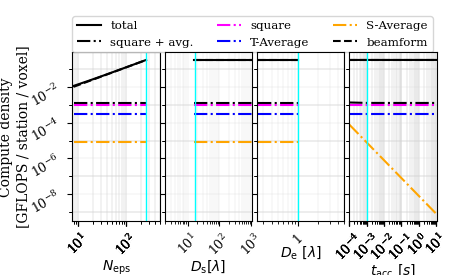

In [89]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, ((flops_beamform_Stokes_intensity_all_stations_per_beam+flops_beamform_Stokes_intensity_tsum_stations_per_beam+flops_beamform_Stokes_intensity_ssum_stations_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='square + avg.')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='magenta', ls='-.', label='square')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_tsum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='blue', ls='-.', label='T-Average')
axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensity_ssum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops).value, color='orange', ls='-.', label='S-Average')
axs[0].plot(nants_in_station, (flops_beamform_voltage_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='beamform')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax0_yticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)
axs[0].set_ylabel('Compute density\n[GFLOPS / station / voxel]', fontsize=10, labelpad=-1)
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].legend(ncol=3, loc=[0.0, 1.0], fontsize=8.5)

axs[1].plot(station_dia, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[1].plot(station_dia, ((flops_beamform_Stokes_intensity_all_stations_per_beam+flops_beamform_Stokes_intensity_tsum_stations_per_beam+flops_beamform_Stokes_intensity_ssum_stations_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', label='square')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_tsum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', label='T-Average')
axs[1].plot(station_dia, (flops_beamform_Stokes_intensity_ssum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[1].plot(station_dia, (flops_beamform_voltage_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='beamform')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_yscale('log')
axs[1].set_xscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax1_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[1].xaxis.set_major_locator(ax1_xticks)
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[1].set_xlabel(r'$D_\mathrm{s} [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, ((flops_beamform_Stokes_intensity_all_stations_per_beam+flops_beamform_Stokes_intensity_tsum_stations_per_beam+flops_beamform_Stokes_intensity_ssum_stations_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', label='square')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_tsum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', label='T-Average')
axs[2].plot(ant_dia, (flops_beamform_Stokes_intensity_ssum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[2].plot(ant_dia, (flops_beamform_voltage_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='beamform')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_yscale('log')
axs[2].set_xscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax2_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[2].xaxis.set_major_locator(ax2_xticks)
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=-1)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].plot(tacc.si, ((flops_beamform_Stokes_intensity_all_stations_per_beam+flops_beamform_Stokes_intensity_tsum_stations_per_beam+flops_beamform_Stokes_intensity_ssum_stations_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='square + avg.')
axs[3].axhline((flops_beamform_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='magenta', ls='-.', label='square')
axs[3].axhline((flops_beamform_Stokes_intensity_tsum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='blue', ls='-.', label='T-Average')
axs[3].plot(tacc.si, (flops_beamform_Stokes_intensity_ssum_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', label='S-Average')
axs[3].axhline((flops_beamform_voltage_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls='--', label='beamform')
axs[3].axvline(tacc.si.value[arr_ind_nominal_tacc], color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_yscale('log')
axs[3].set_xscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)
# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)
axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)
# ax3[0].yaxis.set_major_locator(major_tick_log_locs)
axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.195, right=0.97, left=0.161, top=0.81, wspace=0.05)

PLT.savefig(figdir+'1D_beamformer_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_beamformer_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_epic_cost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_epic_relative_cost_analysis_LAMBDA-I.pdf


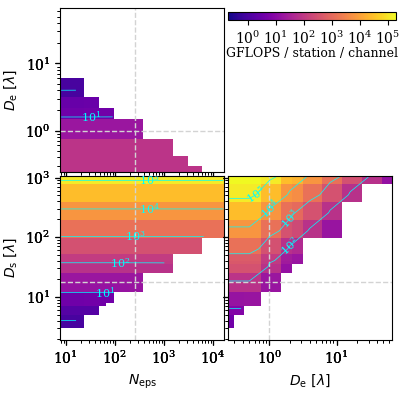

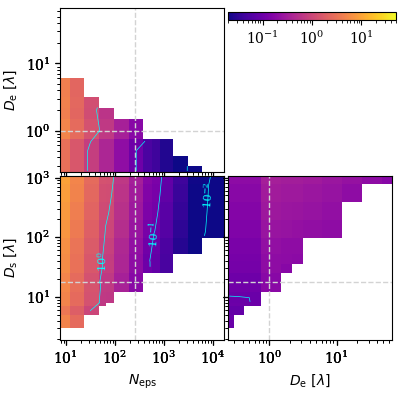

In [90]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_epic:
    yax, xax = slices_compcost_stationwise_epic[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_epic[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr, inline=False, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
    
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_epic:
    yax, xax = slices_compcost_stationwise_epic[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_epic[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ref = slices_compcost_stationwise_beamforming[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ratio = (imgvals / imgvals_ref).decompose()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
    # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    # majorticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
    # ax.xaxis.set_major_locator(majorticks)
    # ax.yaxis.set_major_locator(majorticks)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    # minorticks = ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=11)
    # ax.xaxis.set_minor_locator(minorticks)
    # ax.yaxis.set_minor_locator(minorticks)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

PLT.savefig(figdir+'multidim_epic_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_epic_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))


Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_epic_per_pixel_cost_analysis_LAMBDA-I.pdf


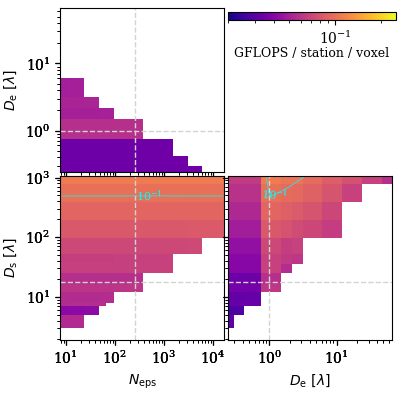

In [91]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_epic_per_pixel:
    yax, xax = slices_compcost_stationwise_epic_per_pixel[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_epic_per_pixel[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    # compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e1), shading='nearest', cmap='plasma')
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-2, vmax=2.5e-1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr, inline=False, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
    
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_epic_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_epic_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

# fig = PLT.figure(figsize=(4,4))
# gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_compcost_stationwise_epic_per_pixel:
#     yax, xax = slices_compcost_stationwise_epic_per_pixel[(r,c)]['axkey']
#     imgvals = slices_compcost_stationwise_epic_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ref = slices_compcost_stationwise_beamforming_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ratio = (imgvals / imgvals_ref).decompose()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
#     ax = fig.add_subplot(gs[r,c])
#     compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

#     try:
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     # fmt = ticker.LogFormatterMathtext()
#     # fmt.create_dummy_axis()
#     cntr_log_fmt.create_dummy_axis()
#     ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
#     # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
# #     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

#     ax.xaxis.set_major_formatter(major_tick_log_fmt)
#     # majorticks = ticker.LogLocator(base=10.0, subs=(1.0,), numticks=7)
#     # ax.xaxis.set_major_locator(majorticks)
#     # ax.yaxis.set_major_locator(majorticks)
#     ax.xaxis.set_major_locator(major_tick_log_locs)
#     ax.yaxis.set_major_locator(major_tick_log_locs)
#     # minorticks = ticker.LogLocator(base=10.0,subs=(0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9),numticks=11)
#     # ax.xaxis.set_minor_locator(minorticks)
#     # ax.yaxis.set_minor_locator(minorticks)
#     ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.xaxis.set_minor_formatter(ticker.NullFormatter())
#     ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()
# #             PLT.setp(ax.spines.values(), visible=False) 
# #             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

# cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
# cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# # cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# # cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

# PLT.savefig(figdir+'multidim_epic_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_epic_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))


Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_epic_cost_analysis_LAMBDA-I.pdf


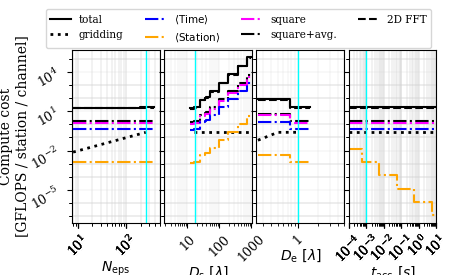

In [92]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[0].plot(nants_in_station, (flops_gridding_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', lw=2, label='gridding')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_ssum/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\langle\mathrm{Station}\rangle$')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[0].plot(nants_in_station, ((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations + flops_epic_pixelwise_Stokes_intensity_ssum)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[0].plot(nants_in_station, (flops_fft_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)

# axs[0].text(0.05, 0.95, r'$\eta_\mathrm{sff}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia]), fontsize=8.5, transform=axs[0].transAxes, ha='left', va='top')
# axs[0].set_xlim(xmin=0.95*nants_in_station.min())
# axs[0].set_xlim(xmax=1.05*nants_in_station.max())

# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax0_yticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)
# axs[0].tick_params(axis='x', labelbottom=False)
# axs[0].set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / channel]', fontsize=10, labelpad=-1)
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].legend(ncol=4, loc=[-0.3, 1.01], fontsize=7.5)

axs[1].plot(station_dia, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[1].plot(station_dia, (flops_fft_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[1].plot(station_dia, (flops_gridding_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[1].plot(station_dia, ((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations+ flops_epic_pixelwise_Stokes_intensity_ssum)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_ssum/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\langle\mathrm{Station}\rangle$')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax1_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[1].xaxis.set_major_locator(ax1_xticks)
axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[2].plot(ant_dia, (flops_fft_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[2].plot(ant_dia, (flops_gridding_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[2].plot(ant_dia, ((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations+ flops_epic_pixelwise_Stokes_intensity_ssum)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_ssum/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Station}\right\rangle$')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax2_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[2].xaxis.set_major_locator(ax2_xticks)
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[3].axhline((flops_fft_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[3].axhline((flops_gridding_voltages_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=':', lw=2, label='grid')
axs[3].plot(tacc.si, ((flops_epic_pixelwise_Stokes_intensity_all_stations + flops_epic_pixelwise_Stokes_intensity_acc_all_stations+ flops_epic_pixelwise_Stokes_intensity_ssum)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[3].axhline((flops_epic_pixelwise_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[3].axhline((flops_epic_pixelwise_Stokes_intensity_acc_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[3].plot(tacc.si, (flops_epic_pixelwise_Stokes_intensity_ssum/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Station}\right\rangle$')
axs[3].axvline(tacc.si.value[arr_ind_nominal_tacc], color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)
# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.16, top=0.82, wspace=0.05)

PLT.savefig(figdir+'1D_epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_epic_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_epic_per_pixel_cost_analysis_LAMBDA-I.pdf


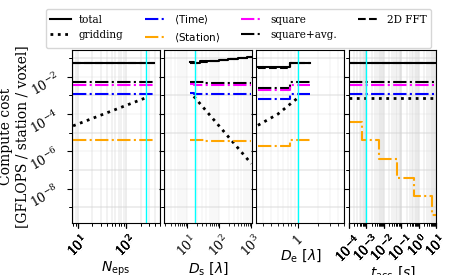

In [93]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[0].plot(nants_in_station, (flops_gridding_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', lw=2, label='gridding')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_ssum_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\langle\mathrm{Station}\rangle$')
axs[0].plot(nants_in_station, (flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[0].plot(nants_in_station, ((flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_ssum_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[0].plot(nants_in_station, (flops_fft_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)

# axs[0].text(0.05, 0.95, r'$\eta_\mathrm{sff}$='+'{0:.2g}'.format(station_dia[arr_ind_nominal_station_dia]), fontsize=8.5, transform=axs[0].transAxes, ha='left', va='top')
# axs[0].set_xlim(xmin=0.95*nants_in_station.min())
# axs[0].set_xlim(xmax=1.05*nants_in_station.max())

# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax0_yticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)
# axs[0].tick_params(axis='x', labelbottom=False)
# axs[0].set_xlabel(r'$N_\mathrm{ants}$ per station', labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / voxel]', fontsize=10, labelpad=-1)
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].legend(ncol=4, loc=[-0.3, 1.01], fontsize=7.5)

axs[1].plot(station_dia, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[1].plot(station_dia, (flops_fft_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[1].plot(station_dia, (flops_gridding_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[1].plot(station_dia, ((flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_ssum_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[1].plot(station_dia, (flops_epic_pixelwise_Stokes_intensity_ssum_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\langle\mathrm{Station}\rangle$')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax1_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[1].xaxis.set_major_locator(ax1_xticks)
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[2].plot(ant_dia, (flops_fft_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[2].plot(ant_dia, (flops_gridding_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[2].plot(ant_dia, ((flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_ssum_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[2].plot(ant_dia, (flops_epic_pixelwise_Stokes_intensity_ssum_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Station}\right\rangle$')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
ax2_xticks = ticker.LogLocator(base=10.0, numticks=7)
axs[2].xaxis.set_major_locator(ax2_xticks)
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[3].axhline((flops_fft_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls='--', drawstyle='steps-mid', label='2D FFT')
axs[3].axhline((flops_gridding_voltages_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=':', lw=2, label='grid')
axs[3].plot(tacc.si, ((flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam + flops_epic_pixelwise_Stokes_intensity_ssum_per_beam)/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', drawstyle='steps-mid', label='square+avg.')
axs[3].axhline((flops_epic_pixelwise_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='magenta', ls='-.', drawstyle='steps-mid', label='square')
axs[3].axhline((flops_epic_pixelwise_Stokes_intensity_acc_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='blue', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Time}\right\rangle$')
axs[3].plot(tacc.si, (flops_epic_pixelwise_Stokes_intensity_ssum_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,0,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='orange', ls='-.', drawstyle='steps-mid', label=r'$\left\langle\mathrm{Station}\right\rangle$')
axs[3].axvline(tacc.si.value[arr_ind_nominal_tacc], color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)
# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.16, top=0.82, wspace=0.05)

PLT.savefig(figdir+'1D_epic_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_epic_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_fft_cost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_fft_relative_cost_analysis_LAMBDA-I.pdf


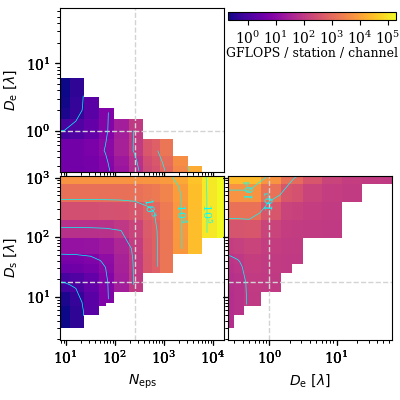

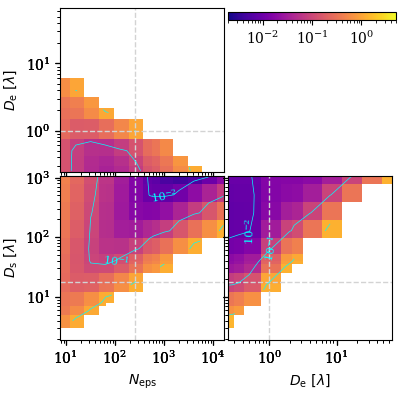

In [94]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_fft:
    yax, xax = slices_compcost_stationwise_xcor_fft[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_fft[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
    # ax.clabel(compcost_cntr, inline=False, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)
    
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_fft:
    yax, xax = slices_compcost_stationwise_xcor_fft[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_fft[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ref = slices_compcost_stationwise_beamforming[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ratio = (imgvals / imgvals_ref).decompose()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
    ax = fig.add_subplot(gs[r,c])
    # compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.002, vmax=5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

PLT.savefig(figdir+'multidim_xcor_fft_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_fft_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

/tmp/ipykernel_945689/2879509877.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = PLT.figure(figsize=(4,4))


Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_fft_per_pixel_cost_analysis_LAMBDA-I.pdf


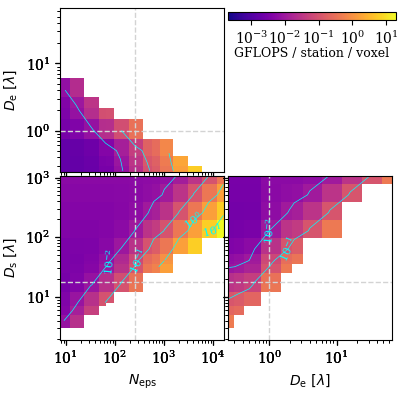

In [95]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_fft_per_pixel:
    yax, xax = slices_compcost_stationwise_xcor_fft_per_pixel[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_fft_per_pixel[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)
    # ax.clabel(compcost_cntr, inline=False, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)
    
    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_fft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_fft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

# fig = PLT.figure(figsize=(4,4))
# gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_compcost_stationwise_xcor_fft_per_pixel:
#     yax, xax = slices_compcost_stationwise_xcor_fft_per_pixel[(r,c)]['axkey']
#     imgvals = slices_compcost_stationwise_xcor_fft_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ref = slices_compcost_stationwise_beamforming_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ratio = (imgvals / imgvals_ref).decompose()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
#     ax = fig.add_subplot(gs[r,c])
#     compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

#     try:
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     # fmt = ticker.LogFormatterMathtext()
#     # fmt.create_dummy_axis()
#     # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
#     cntr_log_fmt.create_dummy_axis()
#     ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
# #     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

#     ax.xaxis.set_major_formatter(major_tick_log_fmt)
#     ax.xaxis.set_major_locator(major_tick_log_locs)
#     ax.yaxis.set_major_locator(major_tick_log_locs)
#     ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.xaxis.set_minor_formatter(ticker.NullFormatter())
#     ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()
# #             PLT.setp(ax.spines.values(), visible=False) 
# #             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

# cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
# cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# # cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# # cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

# PLT.savefig(figdir+'multidim_xcor_fft_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
# print('Saved at: '+figdir+'multidim_xcor_fft_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_xcor_fft_cost_analysis_LAMBDA-I.pdf


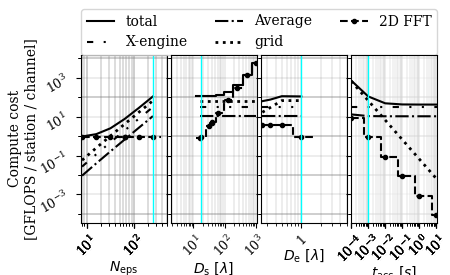

In [96]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[0].plot(nants_in_station, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='Average')
axs[0].plot(nants_in_station, (flops_vis_gridding_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='gray')
# ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / channel]', fontsize=10, labelpad=-1)
axs[0].legend(ncol=3, loc=[0.0, 1.0], fontsize=10)

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)

axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[1].plot(station_dia, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[1].plot(station_dia, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[1].plot(station_dia, (flops_vis_gridding_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[1].plot(station_dia, (flops_vis_fft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='gray')
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[2].plot(ant_dia, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[2].plot(ant_dia, (flops_vis_gridding_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[2].plot(ant_dia, (flops_vis_fft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='gray')
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].axhline((flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[3].plot(tacc.si, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[3].plot(tacc.si, (flops_vis_gridding_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[3].plot(tacc.si, (flops_vis_fft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[3].axvline(tacc[arr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.18, top=0.8, wspace=0.05)

PLT.savefig(figdir+'1D_xcor_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_xcor_fft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_xcor_fft_per_pixel_cost_analysis_LAMBDA-I.pdf


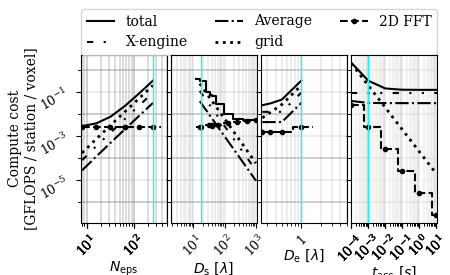

In [97]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[0].plot(nants_in_station, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='Average')
axs[0].plot(nants_in_station, (flops_vis_gridding_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='gray')
# ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
# axs[0].yaxis.set_major_locator(ax0_yticks)
# axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / voxel]', fontsize=10, labelpad=-1)
axs[0].legend(ncol=3, loc=[0.0, 1.0], fontsize=10)

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)

axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', drawstyle='steps-mid', label='total')
axs[1].plot(station_dia, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[1].plot(station_dia, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[1].plot(station_dia, (flops_vis_gridding_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[1].plot(station_dia, (flops_vis_fft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='gray')
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[2].plot(ant_dia, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[2].plot(ant_dia, (flops_vis_gridding_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[2].plot(ant_dia, (flops_vis_fft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='gray')
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].axhline((flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[3].plot(tacc.si, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[3].plot(tacc.si, (flops_vis_gridding_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', lw=2, label='grid')
axs[3].plot(tacc.si, (flops_vis_fft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', drawstyle='steps-mid', marker='o', ms=3, label='2D FFT')
axs[3].axvline(tacc[arr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.si.value.min(), 1.05*tacc.si.value.max())
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.18, top=0.8, wspace=0.05)

PLT.savefig(figdir+'1D_xcor_fft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_xcor_fft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_dft_cost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_dft_relative_cost_analysis_LAMBDA-I.pdf


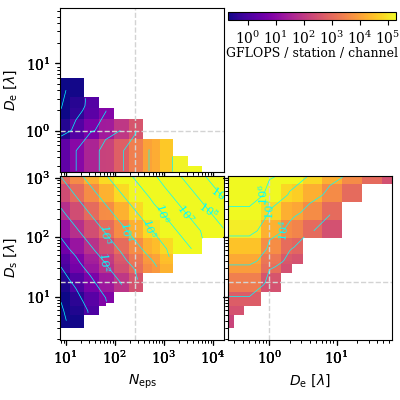

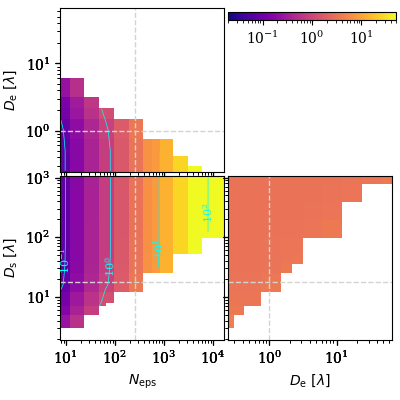

In [98]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_dft:
    yax, xax = slices_compcost_stationwise_xcor_dft[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_dft[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr, inline=False, fmt=ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf)), fontsize=8)
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)

#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_xcor_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_dft:
    yax, xax = slices_compcost_stationwise_xcor_dft[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_dft[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ref = slices_compcost_stationwise_beamforming[(r,c)]['array'].to('gflops').squeeze()
    imgvals_ratio = (imgvals / imgvals_ref).decompose()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

PLT.savefig(figdir+'multidim_xcor_dft_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_xcor_dft_relative_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_xcor_dft_per_pixel_cost_analysis_LAMBDA-I.pdf


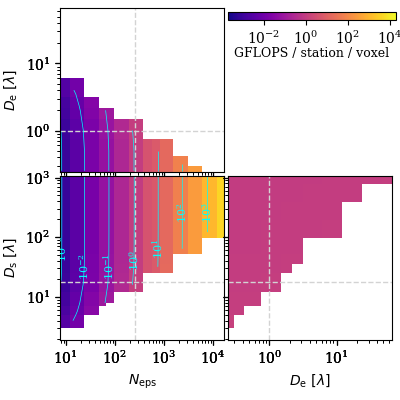

In [99]:
nrows = len(axes_to_plot_img_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_compcost_stationwise_xcor_dft_per_pixel:
    yax, xax = slices_compcost_stationwise_xcor_dft_per_pixel[(r,c)]['axkey']
    imgvals = slices_compcost_stationwise_xcor_dft_per_pixel[(r,c)]['array'].to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e4), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    # fmt = ticker.LogFormatterMathtext()
    # fmt.create_dummy_axis()
    # ax.clabel(compcost_cntr, inline=False, fmt=ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf)), fontsize=8)
    cntr_log_fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=cntr_log_fmt, fontsize=8)

#     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()
#             PLT.setp(ax.spines.values(), visible=False) 
#             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / station / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_xcor_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

################################ 

# fig = PLT.figure(figsize=(4,4))
# gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_compcost_stationwise_xcor_dft_per_pixel:
#     yax, xax = slices_compcost_stationwise_xcor_dft_per_pixel[(r,c)]['axkey']
#     imgvals = slices_compcost_stationwise_xcor_dft_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ref = slices_compcost_stationwise_beamforming_per_pixel[(r,c)]['array'].to('gflops').squeeze()
#     imgvals_ratio = (imgvals / imgvals_ref).decompose()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio).value))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio).value))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)
    
#     ax = fig.add_subplot(gs[r,c])
#     compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio.astype(float), norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='lightgray', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='lightgray', lw=1, ls='--')

#     try:
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(imgvals_ratio).value*NP.nanmax(imgvals_ratio).value)]
#         compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio.value, clevels, linewidths=0.5, colors='cyan')
#     # fmt = ticker.LogFormatterMathtext()
#     # fmt.create_dummy_axis()
#     # ax.clabel(compcost_cntr_ratio, inline=False, fontsize=8)
#     cntr_log_fmt.create_dummy_axis()
#     ax.clabel(compcost_cntr_ratio, inline=False, fmt=cntr_log_fmt, fontsize=8)
# #     ax.clabel(compcost_cntr, clevels, inline=False, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

#     ax.xaxis.set_major_formatter(major_tick_log_fmt)
#     ax.xaxis.set_major_locator(major_tick_log_locs)
#     ax.yaxis.set_major_locator(major_tick_log_locs)
#     ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
#     ax.xaxis.set_minor_formatter(ticker.NullFormatter())
#     ax.yaxis.set_minor_formatter(ticker.NullFormatter())
    
# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()
# #             PLT.setp(ax.spines.values(), visible=False) 
# #             ax.tick_params(axis='both', which='both', left=False, labelleft=False, bottom=False, labelbottom=False)

# cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
# cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# # cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# # cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# # cbar.set_label('GFLOPS / station / channel', labelpad=0, x=0.5, fontsize=8.5)

# PLT.savefig(figdir+'multidim_xcor_dft_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_xcor_dft_relative_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_xcor_dft_cost_analysis_LAMBDA-I.pdf


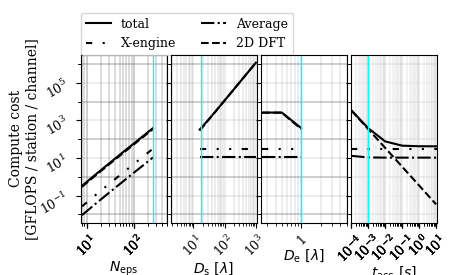

In [100]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[0].plot(nants_in_station, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='Average')
axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='2D DFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='gray')
ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
axs[0].yaxis.set_major_locator(ax0_yticks)
axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / channel]', fontsize=10, labelpad=-1)
axs[0].legend(ncol=2, loc=[0.0, 1.0], fontsize=9)

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)

axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[1].plot(station_dia, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[1].plot(station_dia, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[1].plot(station_dia, (flops_vis_dft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='gray')
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, (flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[2].plot(ant_dia, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[2].plot(ant_dia, (flops_vis_dft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='gray')
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].axhline((flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[3].plot(tacc.si, (flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[3].plot(tacc.si, (flops_vis_dft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[3].axvline(tacc[arr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.18, top=0.8, wspace=0.05)

PLT.savefig(figdir+'1D_xcor_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_xcor_dft_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_xcor_dft_per_pixel_cost_analysis_LAMBDA-I.pdf


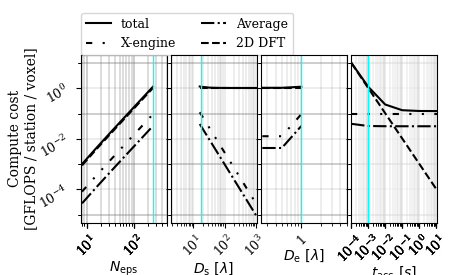

In [101]:
ncols = len(axes_to_plot_img_incoherent) + 1
fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4.5,2.75))

axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-', label='total')
axs[0].plot(nants_in_station, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[0].plot(nants_in_station, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='Average')
axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='2D DFT')
axs[0].axvline(nants_in_station[arr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
# axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
axs[0].set_xlim(0.95*nants_in_station.min(), 500)
axs[0].set_xscale('log')
axs[0].set_yscale('log')
axs[0].grid(axis='both', which='both', lw=0.2, color='gray')
ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
axs[0].yaxis.set_major_locator(ax0_yticks)
axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
axs[0].set_ylabel('Compute cost\n[GFLOPS / station / voxel]', fontsize=10, labelpad=-1)
axs[0].legend(ncol=2, loc=[0.0, 1.0], fontsize=9)

axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
axs[0].xaxis.set_major_locator(major_tick_log_locs)
axs[0].yaxis.set_major_locator(major_tick_log_locs)
axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[0].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[0].tick_params(axis='x', rotation=45, labelsize=9)
axs[0].tick_params(axis='y', rotation=30, labelsize=9)

axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[1].plot(station_dia, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[1].plot(station_dia, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[1].plot(station_dia, (flops_vis_dft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,:,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[1].axvline(station_dia[arr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
axs[1].set_xscale('log')
axs[1].set_yscale('log')
axs[1].grid(axis='both', which='both', lw=0.2, color='gray')
# axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[1].tick_params(axis='x', rotation=45, labelsize=9)

axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[2].plot(ant_dia, (flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[2].plot(ant_dia, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[2].plot(ant_dia, (flops_vis_dft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[2].axvline(ant_dia[arr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
# axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
axs[2].set_xlim(0.95*ant_dia.min(), 5)
axs[2].set_xscale('log')
axs[2].set_yscale('log')
axs[2].grid(axis='both', which='both', lw=0.2, color='gray')
axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
axs[2].tick_params(axis='x', rotation=45, labelsize=9)

axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-', label='total')
axs[3].axhline((flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=(0, (3, 5, 1, 5, 1, 5)), label='X-engine')
axs[3].plot(tacc.si, (flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='Average')
axs[3].plot(tacc.si, (flops_vis_dft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,:,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,arr_ind_nominal_ant_dia,arr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='2D DFT')
axs[3].axvline(tacc[arr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
axs[3].set_xscale('log')
axs[3].set_yscale('log')
axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
# ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
# axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=-1)

axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
axs[3].xaxis.set_major_locator(major_tick_log_locs)

axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
axs[3].tick_params(axis='x', rotation=45, labelsize=9)

PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.18, top=0.8, wspace=0.05)

PLT.savefig(figdir+'1D_xcor_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'1D_xcor_dft_per_pixel_cost_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

In [102]:
print((flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_correlator_stationwise_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_acc_vis_all_stations_method1_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_vis_dft_Stokes_intensity_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))


[1.06163931 1.06163931 1.06163931 1.17226213        nan        nan
        nan        nan        nan        nan        nan] gflops
[0.01278955 0.01278955 0.01278955 0.09524134        nan        nan
        nan        nan        nan        nan        nan] gflops
[0.00436976 0.00436976 0.00436976 0.03254079        nan        nan
        nan        nan        nan        nan        nan] gflops
[1.04448 1.04448 1.04448 1.04448     nan     nan     nan     nan     nan
     nan     nan] gflops


In [103]:
print((flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_correlator_stationwise_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,0,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_acc_vis_all_stations_method1/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))
print((flops_vis_dft_Stokes_intensity_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[arr_ind_nominal_npol,arr_ind_nominal_tacc,arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,arr_ind_nominal_nants_in_station].to(gflops))


[2601.01632 2601.01632 2601.01632  385.67424        nan        nan
        nan        nan        nan        nan        nan] gflops
[31.3344 31.3344 31.3344 31.3344     nan     nan     nan     nan     nan
     nan     nan] gflops
[10.70592 10.70592 10.70592 10.70592      nan      nan      nan      nan
      nan      nan      nan] gflops
[2558.976   2558.976   2558.976    343.63392        nan        nan
        nan        nan        nan        nan        nan] gflops


## Plot 1D slices of total cost comparing different coherent-incoherent imaging architectures

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_AU-VLBA-Low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_compcost_analysis_SKA1-low-core-lb.pdf
Sav

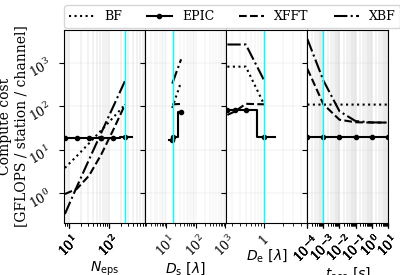

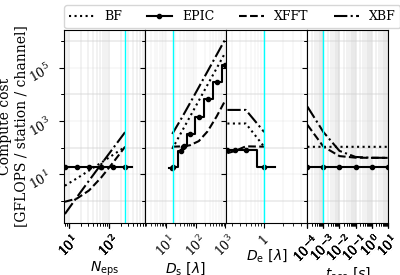

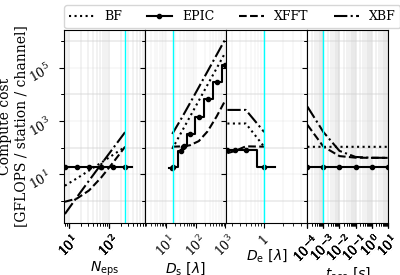

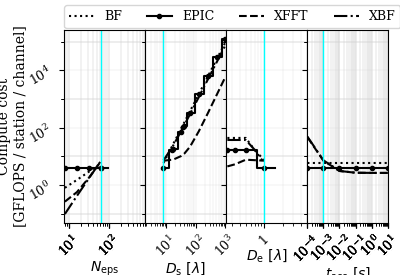

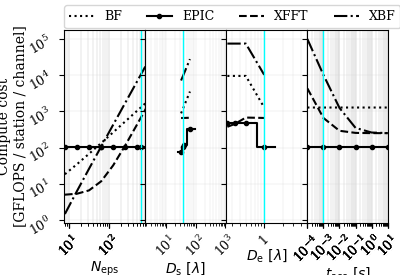

...

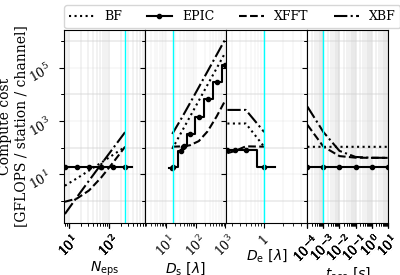

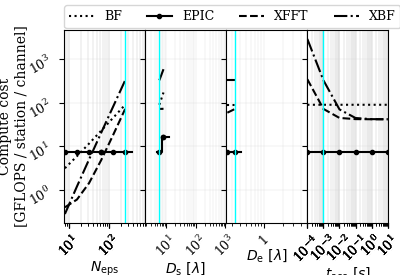

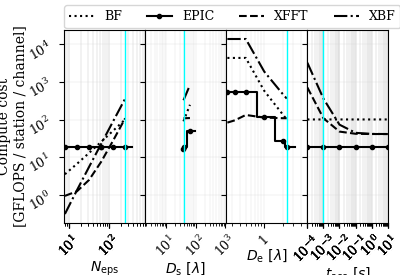

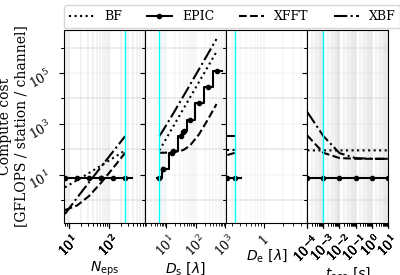

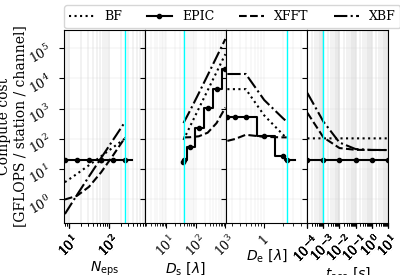

In [175]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)
    
    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.95*NP.nanmin(charr_axv)]
        charr_axs_max += [1.05*NP.nanmax(charr_axv)]

    ncols = len(axes_to_plot_img_incoherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4,2.75))

    axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', label='BF')
    axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='XFFT')
    axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='XBF')
    axs[0].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[0].set_xlim(0.95*nants_in_station.min(), 800)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    # axs[0].yaxis.set_major_locator(ax0_yticks)
    # axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    # axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[GFLOPS / station / channel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01], fontsize=9)

    axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
    axs[0].xaxis.set_major_locator(major_tick_log_locs)
    axs[0].yaxis.set_major_locator(major_tick_log_locs)
    axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[0].yaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
    axs[0].tick_params(axis='x', rotation=45, labelsize=9)
    axs[0].tick_params(axis='y', rotation=30, labelsize=9)

    axs[1].plot(station_dia, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[1].plot(station_dia, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[1].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    axs[1].tick_params(axis='x', rotation=45, labelsize=9)

    axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[2].plot(ant_dia, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[2].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
    axs[2].set_xlim(0.95*ant_dia.min(), 5)
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    axs[2].tick_params(axis='x', rotation=45, labelsize=9)

    axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[3].plot(tacc.si, (flops_epic_Stokes_intensities/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[3].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
    # axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)

    axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
    axs[3].xaxis.set_major_locator(major_tick_log_locs)

    axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
    axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
    axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
    axs[3].tick_params(axis='x', rotation=45, labelsize=9)

    PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.16, top=0.89, wspace=0.0, hspace=0)

    PLT.savefig(figdir+'1D_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_compcost_analysis_{0}.pdf'.format(charr['name']))
    
############################

# for chosenarr in range(len(arrs)):
#     charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)
    
#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         charr_axs_min += [0.95*NP.nanmin(charr_axv)]
#         charr_axs_max += [1.05*NP.nanmax(charr_axv)]
        
#     ncols = len(axes_to_plot_img_incoherent) + 1
#     fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4,2.75))

#     axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='BF')
#     axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
#     axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='XFFT')
#     axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='XBF')
#     axs[0].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
#     axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
#     axs[0].set_xscale('log')
#     axs[0].set_yscale('log')
#     axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     # ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     # axs[0].yaxis.set_major_locator(ax0_yticks)
#     # axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     # axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
#     axs[0].set_ylabel('Relative compute cost', fontsize=10, labelpad=-1)
#     axs[0].legend(ncol=4, loc=[0.0, 1.01], fontsize=9)

    # axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
    # axs[0].xaxis.set_major_locator(major_tick_log_locs)
    # axs[0].yaxis.set_major_locator(major_tick_log_locs)
    # axs[0].yaxis.set_major_locator(major_tick_log_locs)
    # axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
    # axs[0].yaxis.set_minor_locator(minor_tick_log_sublocs)
    # axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[0].tick_params(axis='x', rotation=45, labelsize=9)
    # axs[0].tick_params(axis='y', rotation=30, labelsize=9)

    # axs[1].plot(station_dia, (flops_beamform_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
    # axs[1].plot(station_dia, (flops_epic_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    # axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
    # axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
    # axs[1].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    # axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
    # axs[1].set_xscale('log')
    # axs[1].set_yscale('log')
    # axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # # axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    # axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    # axs[1].tick_params(axis='x', rotation=45, labelsize=9)

    # axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
    # axs[2].plot(ant_dia, (flops_epic_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    # axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
    # axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
    # axs[2].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
    # axs[2].set_xscale('log')
    # axs[2].set_yscale('log')
    # axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    # axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    # axs[2].tick_params(axis='x', rotation=45, labelsize=9)

    # axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
    # axs[3].plot(tacc.si, (flops_epic_Stokes_intensities/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    # axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
    # axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations/flops_beamform_Stokes_intensities)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
    # axs[3].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    # axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
    # axs[3].set_xscale('log')
    # axs[3].set_yscale('log')
    # axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # # ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
    # # axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    # axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)

    # axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
    # axs[3].xaxis.set_major_locator(major_tick_log_locs)

    # axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
    # axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
    # axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[3].tick_params(axis='x', rotation=45, labelsize=9)

    # PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.14, top=0.89, wspace=0.0, hspace=0)

    # PLT.savefig(figdir+'1D_relative_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    # print('Saved at: '+figdir+'1D_relative_compcost_analysis_{0}.pdf'.format(charr['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_per_pixel_compcost_analysis_AU-VLBA-Low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-ar

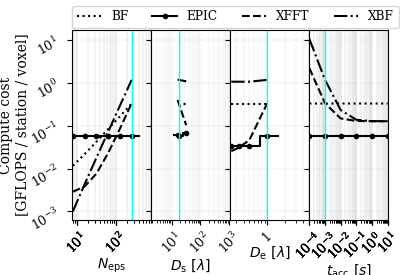

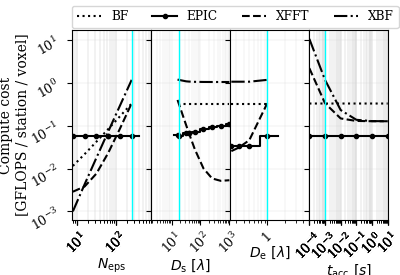

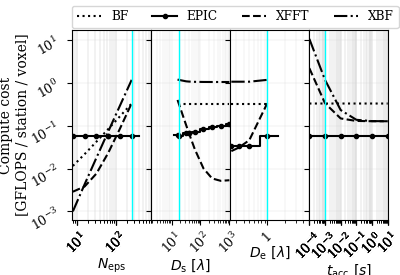

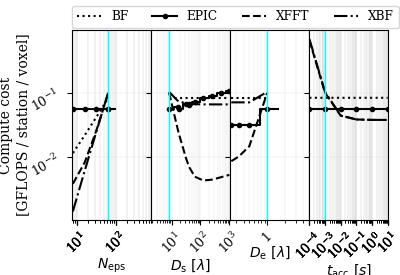

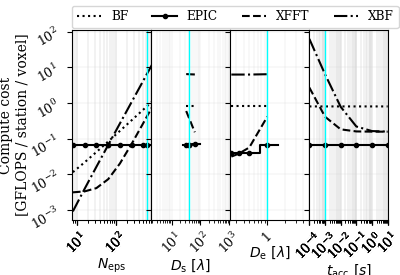

...

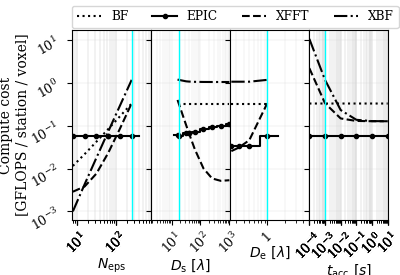

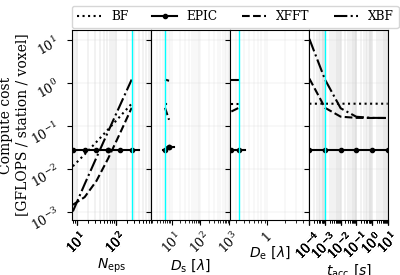

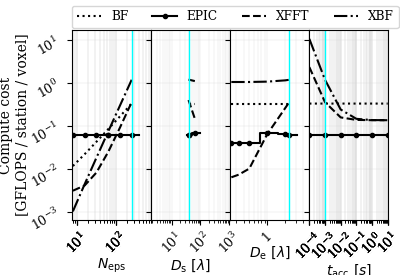

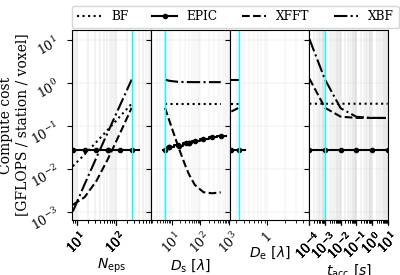

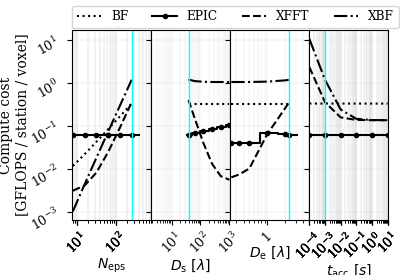

In [174]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)
    
    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.95*NP.nanmin(charr_axv)]
        charr_axs_max += [1.05*NP.nanmax(charr_axv)]
     
    ncols = len(axes_to_plot_img_incoherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4,2.75))

    axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', label='BF')
    axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='XFFT')
    axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='XBF')
    axs[0].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[0].set_xlim(0.95*nants_in_station.min(), 800)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    # axs[0].yaxis.set_major_locator(ax0_yticks)
    # axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    # axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[GFLOPS / station / voxel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01], fontsize=8.75)

    axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
    axs[0].xaxis.set_major_locator(major_tick_log_locs)
    axs[0].yaxis.set_major_locator(major_tick_log_locs)
    axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[0].yaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
    # axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
    axs[0].tick_params(axis='x', rotation=45, labelsize=9)
    axs[0].tick_params(axis='y', rotation=30, labelsize=9)

    axs[1].plot(station_dia, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[1].plot(station_dia, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[1].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    axs[1].tick_params(axis='x', rotation=45, labelsize=9)

    axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[2].plot(ant_dia, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[2].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
    axs[2].set_xlim(0.95*ant_dia.min(), 5)
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    axs[2].tick_params(axis='x', rotation=45, labelsize=9)

    axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='BF')
    axs[3].plot(tacc.si, (flops_epic_Stokes_intensities_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
    axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='XFFT')
    axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/nstations.reshape(1,1,1,-1,1,1,1))[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='XBF')
    axs[3].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    # ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
    # axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)

    axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
    axs[3].xaxis.set_major_locator(major_tick_log_locs)

    axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
    axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
    axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
    axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
    axs[3].tick_params(axis='x', rotation=45, labelsize=9)

    PLT.subplots_adjust(bottom=0.2, right=0.97, left=0.18, top=0.89, wspace=0.0, hspace=0)

    PLT.savefig(figdir+'1D_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']))
    
############################

# for chosenarr in range(len(arrs)):
#     charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)
    
#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         charr_axs_min += [0.95*NP.nanmin(charr_axv)]
#         charr_axs_max += [1.05*NP.nanmax(charr_axv)]
        
#     ncols = len(axes_to_plot_img_incoherent) + 1
#     fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(4,2.75))

#     axs[0].plot(nants_in_station, (flops_beamform_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='BF')
#     axs[0].plot(nants_in_station, (flops_epic_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
#     axs[0].plot(nants_in_station, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='XFFT')
#     axs[0].plot(nants_in_station, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='XBF')
#     axs[0].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
#     axs[0].set_xlim(0.95*nants_in_station.min(), 1.05*nants_in_station.max())
#     axs[0].set_xscale('log')
#     axs[0].set_yscale('log')
#     axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     # ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     # axs[0].yaxis.set_major_locator(ax0_yticks)
#     # axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     # axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[0].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)
#     axs[0].set_ylabel('Relative compute cost', fontsize=10, labelpad=-1)
#     axs[0].legend(ncol=4, loc=[0.0, 1.01], fontsize=9)

#     axs[0].xaxis.set_major_formatter(major_tick_log_fmt)
#     axs[0].xaxis.set_major_locator(major_tick_log_locs)
#     axs[0].yaxis.set_major_locator(major_tick_log_locs)
#     axs[0].yaxis.set_major_locator(major_tick_log_locs)
#     axs[0].xaxis.set_minor_locator(minor_tick_log_sublocs)
#     axs[0].yaxis.set_minor_locator(minor_tick_log_sublocs)
#     axs[0].xaxis.set_minor_formatter(ticker.NullFormatter())
#     axs[0].yaxis.set_minor_formatter(ticker.NullFormatter())
#     axs[0].tick_params(axis='x', rotation=45, labelsize=9)
#     axs[0].tick_params(axis='y', rotation=30, labelsize=9)

#     axs[1].plot(station_dia, (flops_beamform_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
#     axs[1].plot(station_dia, (flops_epic_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
#     axs[1].plot(station_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
#     axs[1].plot(station_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
#     axs[1].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
#     axs[1].set_xlim(0.95*station_dia.min(), 1.05*station_dia.max())
#     axs[1].set_xscale('log')
#     axs[1].set_yscale('log')
#     axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     # axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[1].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
#     axs[1].tick_params(axis='x', rotation=45, labelsize=9)

#     axs[2].plot(ant_dia, (flops_beamform_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
#     axs[2].plot(ant_dia, (flops_epic_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
#     axs[2].plot(ant_dia, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
#     axs[2].plot(ant_dia, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
#     axs[2].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
#     axs[2].set_xlim(0.95*ant_dia.min(), 1.05*ant_dia.max())
#     axs[2].set_xscale('log')
#     axs[2].set_yscale('log')
#     axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
#     axs[2].tick_params(axis='x', rotation=45, labelsize=9)

#     axs[3].plot(tacc.si, (flops_beamform_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='BF')
#     axs[3].plot(tacc.si, (flops_epic_Stokes_intensities_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-mid', label='EPIC')
#     axs[3].plot(tacc.si, (flops_vis_fft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='XFFT')
#     axs[3].plot(tacc.si, (flops_vis_dft_Stokes_imaging_all_stations_per_beam/flops_beamform_Stokes_intensities_per_beam)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='XBF')
#     axs[3].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
#     axs[3].set_xlim(0.95*tacc.min().si.value, 1.05*tacc.max().si.value)
#     axs[3].set_xscale('log')
#     axs[3].set_yscale('log')
#     axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     # ax3_xticks = ticker.LogLocator(base=10.0, numticks=5)
#     # axs[3].xaxis.set_major_locator(ax3_xticks)# axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[3].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)

#     axs[3].xaxis.set_major_formatter(major_tick_log_fmt)
#     axs[3].xaxis.set_major_locator(major_tick_log_locs)

#     axs[3].xaxis.set_minor_locator(minor_tick_log_sublocs)
#     axs[3].yaxis.set_minor_locator(minor_tick_log_baselocs)
#     axs[3].xaxis.set_minor_formatter(ticker.NullFormatter())
#     axs[3].yaxis.set_minor_formatter(ticker.NullFormatter())
#     axs[3].tick_params(axis='x', rotation=45, labelsize=9)

#     PLT.subplots_adjust(bottom=0.19, right=0.97, left=0.14, top=0.89, wspace=0.0, hspace=0)

#     PLT.savefig(figdir+'1D_relative_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
#     print('Saved at: '+figdir+'1D_relative_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']))

# Coherent processing analysis

## Array gridding parameters

In [106]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(zcut.size, npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

In [107]:
station_cell_size = NP.clip(ant_dia, 0.5, None) * wl
station_cell_area = station_cell_size**2 
array_cell_size = NP.clip(station_dia, 0.5, None) * wl
array_cell_area = array_cell_size**2 
array_ngrid_stacell = (array_area.reshape(1,-1,1,1,1,1) / array_cell_area.reshape(1,1,1,-1,1,1)).decompose() * mask_arr_sta_ant
array_ngrid_antcell = (array_area.reshape(1,-1,1,1,1,1) / station_cell_area.reshape(1,1,1,1,-1,1)).decompose() * mask_arr_sta_ant
station_kernsize_stacell = (station_area / array_cell_area).decompose()
station_kernsize_antcell = (station_area.reshape(1,1,1,-1,1,1) / station_cell_area.reshape(1,1,1,1,-1,1)).decompose()  * mask_arr_sta_ant
print(NP.log10(NP.nanmax(array_ngrid_stacell)))
print(NP.log10(NP.nanmax(array_ngrid_antcell)))

13.245319809215173
14.449439791871097


### Round station_ngrid to the next power of 4 (power of 2 on either side)

In [108]:
is_pow2 = False
if is_pow2:
    pow4_array = NP.ceil(0.5*NP.log2(array_ngrid_stacell)) * mask_arr_sta_ant
    array_ngrid_stacell = 4**pow4_array
    array_ngrid_stacell = array_ngrid_stacell.astype(int)
    array_nside_stacell = NP.ceil(NP.sqrt(array_ngrid_stacell)).astype(int) * mask_arr_sta_ant
array_ngrid_stacell = NP.ceil(array_ngrid_stacell).astype(int) * mask_arr_sta_ant
array_nside_stacell = NP.ceil(NP.sqrt(array_ngrid_stacell)).astype(int) * mask_arr_sta_ant

# Recalculate cell size after adjustments above => Solid angle imaged may be greater than station_fov_sa
array_cell_size = array_dia.reshape(1,-1,1,1,1,1) / array_nside_stacell
array_cell_area = array_cell_size**2

/tmp/ipykernel_945689/1075006697.py:7: RuntimeWarning: invalid value encountered in cast
  array_ngrid_stacell = NP.ceil(array_ngrid_stacell).astype(int) * mask_arr_sta_ant
/tmp/ipykernel_945689/1075006697.py:8: RuntimeWarning: invalid value encountered in cast
  array_nside_stacell = NP.ceil(NP.sqrt(array_ngrid_stacell)).astype(int) * mask_arr_sta_ant


In [109]:
# pow4_array = NP.ceil(0.5*NP.log2(array_ngrid_stacell)) * mask_arr_sta_ant
# array_ngrid_stacell = 4**pow4_array
# array_ngrid_stacell = array_ngrid_stacell.astype(int)
# array_nside_stacell = NP.ceil(NP.sqrt(array_ngrid_stacell)).astype(int) * mask_arr_sta_ant



In [110]:
print(NP.log10(NP.nanmax(array_ngrid_stacell)))
print(array_dia)
print(station_dia)

13.245319809215173
[1.75121150e+02 5.12000000e+02 5.25000000e+02 6.77027500e+02
 1.02400000e+03 1.22584805e+03 2.04800000e+03 4.09600000e+03
 8.19200000e+03 1.16747433e+04 1.63840000e+04 3.27680000e+04
 3.50000000e+04 4.61880215e+04 6.55360000e+04 8.17232033e+04
 1.31072000e+05 2.62144000e+05 5.24288000e+05 1.04857600e+06
 2.09715200e+06 3.90000000e+06 4.19430400e+06 8.38860800e+06] wl
[   2.            4.            5.83737167    8.            8.08
   16.           17.5          32.           38.5          40.86160166
   64.          128.          256.          512.         1024.        ] wl


### Apply padding

In [111]:
array_nside_stacell = array_nside_stacell * fftpad_factor
array_ngrid_stacell = array_nside_stacell**2
print(array_ngrid_stacell.shape)

(1, 24, 11, 15, 11, 14)


In [112]:
print(NP.log10(NP.nanmax(array_ngrid_stacell)))

13.847379800543134


In [113]:
nbeams_per_sta_fov = NP.ceil(station_fov_sa.reshape(1,1,1,-1,1,1).astype(NP.float128) / array_res_sa.reshape(1,-1,1,1,1,1)) * mask_arr_sta_ant

In [114]:
print(nbeams_per_sta_fov.shape)
print(NP.nanargmax(nbeams_per_sta_fov))
print(NP.unravel_index(NP.nanargmax(nbeams_per_sta_fov), nbeams_per_sta_fov.shape))

(1, 24, 11, 15, 11, 14)
584430
(np.int64(0), np.int64(23), np.int64(0), np.int64(0), np.int64(0), np.int64(0))


### Calculate array image FoV and resolution in direction cosine units

In [115]:
array_img_fov_l = 1/array_cell_size
array_img_fov_lm = array_img_fov_l**2

array_img_res_l = 1/(array_nside_stacell*array_cell_size)
array_img_res_lm = array_img_res_l**2

In [116]:
print(NP.nanmin(array_img_res_lm))

3.552713678800501e-15


## Inter-station DFT beamforming

In [117]:
flops_array_beamform_voltage_per_beam_in_sta_fov = npol.reshape(-1,1,1,1,1,1,1)**2 * nstations.reshape(1,1,1,-1,1,1,1) * cmac / dt 
flops_array_beamform_Stokes_intensity_per_beam_in_sta_fov = npol.reshape(-1,1,1,1,1,1,1)**2 * cmult / dt 
flops_array_beamform_Stokes_intensity_tsum_per_beam_in_sta_fov = npol.reshape(-1,1,1,1,1,1,1)**2 * cadd / dt  
flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov = flops_array_beamform_voltage_per_beam_in_sta_fov + flops_array_beamform_Stokes_intensity_per_beam_in_sta_fov + flops_array_beamform_Stokes_intensity_tsum_per_beam_in_sta_fov
flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov = flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov * mask_pol_arr_sta_ant

In [118]:
print(flops_array_beamform_Stokes_intensity_per_beam_in_sta_fov.shape)

(2, 1, 1, 1, 1, 1, 1)


## Inter-station EPIC

In [119]:
flops_array_epic_gridding_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * station_kernsize_stacell.reshape(1,1,1,1,-1,1,1) * nstations.reshape(1,1,1,-1,1,1,1) * cmult / dt
flops_array_fft_voltages_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1) * flo_fft(array_ngrid_stacell[NP.newaxis,...], rdx) / dt
flops_array_epic_pixelwise_Stokes_intensity_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * array_ngrid_stacell[NP.newaxis,...] * cmult / dt
flops_array_epic_pixelwise_Stokes_intensity_tsum_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * array_ngrid_stacell[NP.newaxis,...] * cadd / dt
flops_array_epic_Stokes_imaging_per_sta_beam = flops_array_epic_gridding_per_sta_beam + flops_array_fft_voltages_per_sta_beam + flops_array_epic_pixelwise_Stokes_intensity_per_sta_beam + flops_array_epic_pixelwise_Stokes_intensity_tsum_per_sta_beam
flops_array_epic_Stokes_imaging_per_sta_beam = flops_array_epic_Stokes_imaging_per_sta_beam * mask_pol_arr_sta_ant

## Inter-station Correlation

In [120]:
ncorr_inter_station_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * nstations.reshape(1,1,1,-1,1,1,1) * (nstations.reshape(1,1,1,-1,1,1,1)-1)/2
flo_correlator_inter_station_per_sta_beam = ncorr_inter_station_per_sta_beam * cmult
flo_acc_vis_inter_station_per_sta_beam = ncorr_inter_station_per_sta_beam * cadd
flops_correlator_inter_station_per_sta_beam = flo_correlator_inter_station_per_sta_beam / dt
flops_acc_vis_inter_station_per_sta_beam = flo_acc_vis_inter_station_per_sta_beam / dt

## Inter-station Correlation + DFT beamforming

In [121]:
flo_vis_dft_Stokes_intensity_inter_station_per_beam_in_sta_fov = flo_dft(1, ncorr_inter_station_per_sta_beam)
flops_vis_dft_Stokes_intensity_inter_station_per_beam_in_sta_fov = flo_vis_dft_Stokes_intensity_inter_station_per_beam_in_sta_fov / tacc.reshape(1,-1,1,1,1,1,1) * mask_pol_arr_sta_ant
flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam = flops_correlator_inter_station_per_sta_beam + flops_acc_vis_inter_station_per_sta_beam + nbeams_per_sta_fov[NP.newaxis,...] * flops_vis_dft_Stokes_intensity_inter_station_per_beam_in_sta_fov
flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam = flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam * mask_pol_arr_sta_ant

## Inter-station Correlation + FFT imaging

In [122]:
rho = 1.0 # A factor for denoting the number of snapshots when unique visibilities have to be gridded, 1<=rho<=tacc/dt
# rho = tacc / dt # Number of accumulations

In [123]:
flo_vis_gridproj_inter_station_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**4 * 4*station_kernsize_stacell.reshape(1,1,1,1,-1,1,1) * ncorr_inter_station_per_sta_beam * rho * cmult
flo_vis_uvcell_sum_inter_station_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**4 * (ncorr_inter_station_per_sta_beam / array_ngrid_stacell[NP.newaxis,...]) * rho * cadd
flo_vis_fft_Stokes_intensity_inter_station_per_sta_beam = npol.reshape(-1,1,1,1,1,1,1)**2 * flo_fft(array_ngrid_stacell[NP.newaxis,...], rdx)
flops_vis_gridproj_inter_station_per_sta_beam = flo_vis_gridproj_inter_station_per_sta_beam / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_uvcell_sum_inter_station_per_sta_beam = flo_vis_uvcell_sum_inter_station_per_sta_beam / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_gridding_inter_station_per_sta_beam = flops_vis_gridproj_inter_station_per_sta_beam + flops_vis_uvcell_sum_inter_station_per_sta_beam
flops_vis_fft_Stokes_intensity_inter_station_per_sta_beam = flo_vis_fft_Stokes_intensity_inter_station_per_sta_beam / tacc.reshape(1,-1,1,1,1,1,1)
flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam = flops_correlator_inter_station_per_sta_beam + flops_acc_vis_inter_station_per_sta_beam + flops_vis_gridding_inter_station_per_sta_beam + flops_vis_fft_Stokes_intensity_inter_station_per_sta_beam
flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam = flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam * mask_pol_arr_sta_ant

## Intra-station BF + Inter-station BF

In [124]:
flops_1BF_2BF = nbeams_fov[NP.newaxis,...] * (flops_beamform_voltage_all_stations_per_beam + nbeams_per_sta_fov[NP.newaxis,...] * flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov)
flops_1BF_2BF_per_beam_in_sta_fov = flops_1BF_2BF / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

In [125]:
print(flops_beamform_voltage_all_stations_per_beam.shape)
print(nbeams_per_sta_fov.shape)
print(nbeams_fov.shape)
print(flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov.shape)
print(flops_1BF_2BF.shape)

(2, 1, 24, 11, 15, 11, 14)
(1, 24, 11, 15, 11, 14)
(1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


In [126]:
print(flops_vis_fft_Stokes_intensity_inter_station_per_sta_beam.shape)

(2, 6, 24, 11, 15, 11, 14)


## Intra-station BF + Inter-station EPIC

In [127]:
print(flops_beamform_Stokes_intensities.shape)
print(flops_array_epic_Stokes_imaging_per_sta_beam.shape)

(2, 6, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


In [128]:
flops_1BF_2EPIC = nbeams_fov[NP.newaxis,...] * (flops_beamform_voltage_all_stations_per_beam + flops_array_epic_Stokes_imaging_per_sta_beam)
flops_1BF_2EPIC_per_beam_in_sta_fov = flops_1BF_2EPIC / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station BF + Inter-station XBF

In [129]:
print(flops_beamform_voltage_all_stations_per_beam.shape)
print(flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


In [130]:
flops_1BF_2XBF = nbeams_fov[NP.newaxis,...] * (flops_beamform_voltage_all_stations_per_beam + flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam)
flops_1BF_2XBF_per_beam_in_sta_fov = flops_1BF_2XBF / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station BF + Inter-station XFFT

In [131]:
print(flops_beamform_voltage_all_stations_per_beam.shape)
print(flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


In [132]:
flops_1BF_2XFFT = nbeams_fov[NP.newaxis,...] * (flops_beamform_voltage_all_stations_per_beam + flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam)
flops_1BF_2XFFT_per_beam_in_sta_fov = flops_1BF_2XFFT / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station EPIC + Inter-station BF

In [133]:
print((flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations).shape)
print(flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


In [134]:
flops_1EPIC_2BF = flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations + nbeams_per_sta_fov[NP.newaxis,...] * nbeams_fov[NP.newaxis,...] * flops_array_beamform_Stokes_intensities_per_beam_in_sta_fov
flops_1EPIC_2BF_per_beam_in_sta_fov = flops_1EPIC_2BF / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station EPIC + Inter-station EPIC

In [135]:
print((flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations).shape)
print(flops_array_epic_Stokes_imaging_per_sta_beam.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


In [136]:
flops_1EPIC_2EPIC = flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations + nbeams_fov[NP.newaxis,...] * flops_array_epic_Stokes_imaging_per_sta_beam
flops_1EPIC_2EPIC_per_beam_in_sta_fov = flops_1EPIC_2EPIC / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station EPIC + Inter-station XBF

In [137]:
print((flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations).shape)
print(flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


In [138]:
flops_1EPIC_2XBF = flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations + nbeams_fov[NP.newaxis,...] * flops_vis_dft_Stokes_imaging_inter_station_per_sta_beam
flops_1EPIC_2XBF_per_beam_in_sta_fov = flops_1EPIC_2XBF / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

## Intra-station EPIC + Inter-station XFFT

In [139]:
print((flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations).shape)
print(flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam.shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


In [140]:
flops_1EPIC_2XFFT = flops_gridding_voltages_all_stations + flops_fft_voltages_all_stations + nbeams_fov[NP.newaxis,...] * flops_vis_fft_Stokes_imaging_inter_station_per_sta_beam
flops_1EPIC_2XFFT_per_beam_in_sta_fov = flops_1EPIC_2XFFT / (nbeams_fov[NP.newaxis,...] * nbeams_per_sta_fov[NP.newaxis,...])

In [141]:
print((flops_1BF_2BF/nelements_in_array).shape)
print((flops_1BF_2EPIC/nelements_in_array).shape)
print((flops_1BF_2XBF/nelements_in_array).shape)
print((flops_1BF_2XFFT/nelements_in_array).shape)
print((flops_1EPIC_2BF/nelements_in_array).shape)
print((flops_1EPIC_2EPIC/nelements_in_array).shape)
print((flops_1EPIC_2XBF/nelements_in_array).shape)
print((flops_1EPIC_2XFFT/nelements_in_array).shape)

(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)


(2, 6, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)
(2, 1, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)
(2, 6, 24, 11, 15, 11, 14)


In [142]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(zcut.size, npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

In [143]:
axs_labels = [r'$n_\mathrm{p}$', r'$t_\mathrm{acc}$'+' [s]', r'$D_\mathrm{A}\,\, [\lambda]$', r'$N_\mathrm{s}$', r'$D_\mathrm{s}\,\, [\lambda]$', r'$D_\mathrm{e}\,\, [\lambda]$', r'$N_\mathrm{eps}$']
axs_scales = ['linear', 'log', 'log', 'log', 'log', 'log', 'log']
axs_vals = [npol, tacc.si.value.astype(float), array_dia.value.astype(float), nstations, station_dia.value.astype(float), ant_dia.value.astype(float), nants_in_station]
axs_fmt = ['%d', '%.5g', '%.5g', '%d', '%.3g', '%.3g', '%d']

axes_to_plot_coherent = NP.array([2,3,4,5,6])

In [144]:
slices_1BF_2BF_per_pixel_per_element = multidim_corner_plot_info(flops_1BF_2BF_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2EPIC_per_pixel_per_element = multidim_corner_plot_info(flops_1BF_2EPIC_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XBF_per_pixel_per_element = multidim_corner_plot_info(flops_1BF_2XBF_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XFFT_per_pixel_per_element = multidim_corner_plot_info(flops_1BF_2XFFT_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2BF_per_pixel_per_element = multidim_corner_plot_info(flops_1EPIC_2BF_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2EPIC_per_pixel_per_element = multidim_corner_plot_info(flops_1EPIC_2EPIC_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XBF_per_pixel_per_element = multidim_corner_plot_info(flops_1EPIC_2XBF_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XFFT_per_pixel_per_element = multidim_corner_plot_info(flops_1EPIC_2XFFT_per_beam_in_sta_fov/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)

In [145]:
slices_1BF_2BF_per_pixel = multidim_corner_plot_info(flops_1BF_2BF_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2EPIC_per_pixel = multidim_corner_plot_info(flops_1BF_2EPIC_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XBF_per_pixel = multidim_corner_plot_info(flops_1BF_2XBF_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XFFT_per_pixel = multidim_corner_plot_info(flops_1BF_2XFFT_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2BF_per_pixel = multidim_corner_plot_info(flops_1EPIC_2BF_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2EPIC_per_pixel = multidim_corner_plot_info(flops_1EPIC_2EPIC_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XBF_per_pixel = multidim_corner_plot_info(flops_1EPIC_2XBF_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XFFT_per_pixel = multidim_corner_plot_info(flops_1EPIC_2XFFT_per_beam_in_sta_fov, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)

In [146]:
slices_1BF_2BF_per_element = multidim_corner_plot_info(flops_1BF_2BF/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2EPIC_per_element = multidim_corner_plot_info(flops_1BF_2EPIC/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XBF_per_element = multidim_corner_plot_info(flops_1BF_2XBF/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XFFT_per_element = multidim_corner_plot_info(flops_1BF_2XFFT/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2BF_per_element = multidim_corner_plot_info(flops_1EPIC_2BF/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2EPIC_per_element = multidim_corner_plot_info(flops_1EPIC_2EPIC/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XBF_per_element = multidim_corner_plot_info(flops_1EPIC_2XBF/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XFFT_per_element = multidim_corner_plot_info(flops_1EPIC_2XFFT/nelements_in_array, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)

In [147]:
slices_1BF_2BF = multidim_corner_plot_info(flops_1BF_2BF, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2EPIC = multidim_corner_plot_info(flops_1BF_2EPIC, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XBF = multidim_corner_plot_info(flops_1BF_2XBF, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1BF_2XFFT = multidim_corner_plot_info(flops_1BF_2XFFT, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2BF = multidim_corner_plot_info(flops_1EPIC_2BF, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2EPIC = multidim_corner_plot_info(flops_1EPIC_2EPIC, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XBF = multidim_corner_plot_info(flops_1EPIC_2XBF, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)
slices_1EPIC_2XFFT = multidim_corner_plot_info(flops_1EPIC_2XFFT, axes=axes_to_plot_coherent, nominal_inds=arr_nominal_inds)

In [148]:
print(arr_nominal_inds)
for key in slices_1BF_2BF_per_pixel: print(NP.nanmin(slices_1BF_2BF_per_pixel[key]['array'].to(gflops).squeeze()))

[np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]
0.011520000001649098 gflops
0.011520000000085837 gflops
0.011520000002746774 gflops
0.005120000000618412 gflops
0.005120000019789193 gflops
0.005120000016541487 gflops
0.011520000000356448 gflops
0.011520000011406373 gflops
0.011520000009534414 gflops
0.00512000000427739 gflops


## Parameter space plot

/tmp/ipykernel_945689/953643465.py:38: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=90)
/tmp/ipykernel_945689/953643465.py:38: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=90)
/tmp/ipykernel_945689/953643465.py:38: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=90)
/tmp/ipykernel_945689/953643465.py:38: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=90)
/tmp/ipykernel_945689/953643465.py:38: UserWarning: set_ticklabels() should only

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_parameter_space.pdf


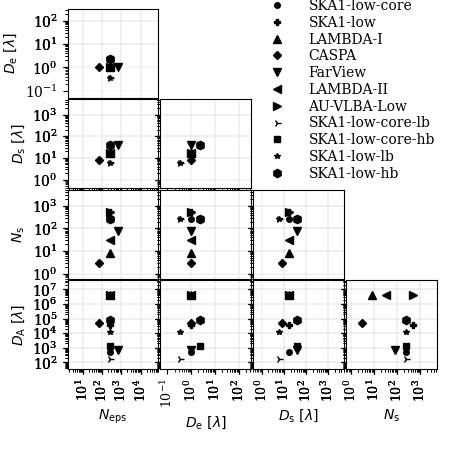

In [149]:
arr_symbs = ['o', 'P', '^', 'D', 'v', '<', '>', '4', 's', '*', 'h', 'x']
symsizes = [4,4,6,4,6,6,6,6,4,4,6,4,6,6,6,6]

nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.18, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2BF_per_pixel:
    yax, xax = slices_1BF_2BF_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2BF_per_pixel[(r,c)]['array']).squeeze()
    imgvals.fill(NP.nan)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), shading='nearest', cmap='plasma')
    ax.grid(axis='both', which='major', lw=0.05, color='gray')
    for chosenarr in range(len(arrs)):
        charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)
        ax.plot(axs_vals[xax][charr_nominal_inds[xax]], axs_vals[yax][charr_nominal_inds[yax]], color='black', ls='none', marker=arr_symbs[chosenarr], ms=symsizes[chosenarr], label=charr['name'])
#         ax.axvline(axs_vals[xax][charr_nominal_inds[xax]], color='black', lw=1, ls=':')
#         ax.axhline(axs_vals[yax][charr_nominal_inds[yax]], color='black', lw=1, ls=':')

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(0.2*axs_vals[yax].min(), 5*axs_vals[yax].max())
    ax.set_xlim(0.2*axs_vals[xax].min(), 5*axs_vals[xax].max())
    ax_yticks = ticker.LogLocator(base=10.0, numticks=11)
    ax.yaxis.set_major_locator(ax_yticks)
    ax_xticks = ticker.LogLocator(base=10.0, numticks=11)
    ax.xaxis.set_major_locator(ax_xticks)
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=90)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
    if (r==0) and (c==0):
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles=handles, labels=labels, loc=[2.01, -1], handlelength=3, labelspacing=0.2, fontsize=10, frameon=False, fancybox=False, shadow=False, borderaxespad=0)

    ax.xaxis.set_major_formatter(major_tick_log_fmt)
    ax.xaxis.set_major_locator(major_tick_log_locs)
    ax.yaxis.set_major_locator(major_tick_log_locs)
    ax.xaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.yaxis.set_minor_locator(minor_tick_log_sublocs)
    ax.xaxis.set_minor_formatter(ticker.NullFormatter())
    ax.yaxis.set_minor_formatter(ticker.NullFormatter())

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

PLT.savefig(figdir+'multidim_parameter_space.pdf', bbox_inches='tight')
print('Saved at: '+figdir+'multidim_parameter_space.pdf')

## Plot coherent-coherent computational costs

In [150]:
print(arr_nominal_inds)

[np.int64(1), np.int64(1), np.int64(21), np.int64(2), np.int64(6), np.int64(3), np.int64(6)]


### 1) Intra-station BF + Inter-station BF

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2BF_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2BF_relative_cost_LAMBDA-I.pdf


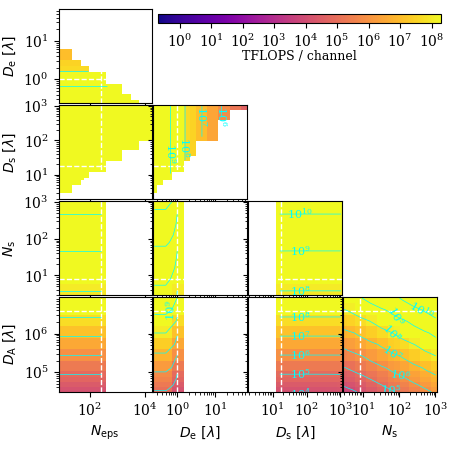

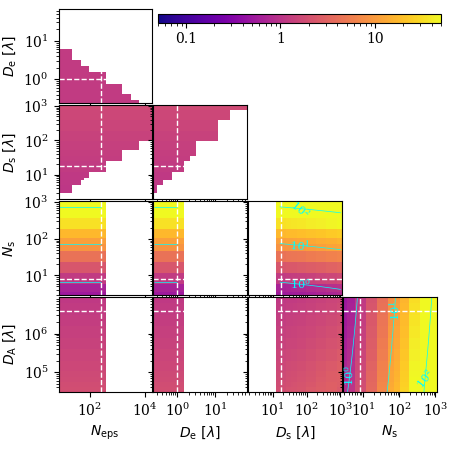

In [151]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2BF:
    yax, xax = slices_1BF_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2BF[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=0.2, vmax=2e8), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)
    
    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2BF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2BF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2BF:
    yax, xax = slices_1BF_2BF[(r,c)]['axkey']
    arr = NP.copy(slices_1BF_2BF[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
#     ax.clabel(compcost_cntr, inline=False, fmt='%.7g', fontsize=8)
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1BF_2BF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2BF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2BF_per_pixel_cost_LAMBDA-I.pdf


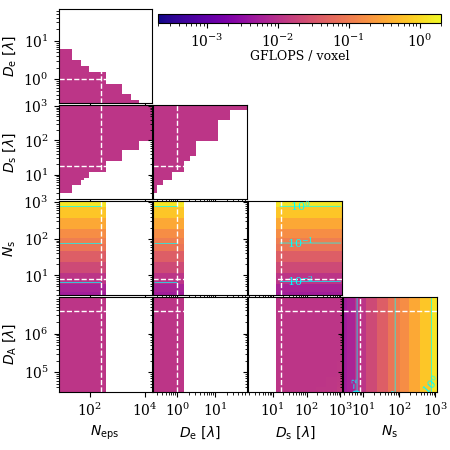

In [152]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2BF_per_pixel:
    yax, xax = slices_1BF_2BF_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2BF_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)
    
    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('GFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2BF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2BF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1BF_2BF_per_pixel:
#     yax, xax = slices_1BF_2BF_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1BF_2BF_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
# #     ax.clabel(compcost_cntr, inline=False, fmt='%.7g', fontsize=8)
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1BF_2BF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1BF_2BF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

In [153]:
print(axs_min)
print(axs_max)
print(array_dia[charr_ind_nominal_array_dia])

[np.float64(0.95), np.float64(9.5e-05), <Quantity 31347.874985 wl>, np.float64(2.8499999999999996), np.float64(1.9), np.float64(0.2375), np.float64(7.6)]
[np.float64(2.1), np.float64(10.5), np.float64(8808038.4), np.float64(1075.2), np.float64(1075.2), np.float64(67.2), np.float64(17203.2)]
81723.20332354725 wl


## Intra-station BF + Inter-station EPIC

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2EPIC_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2EPIC_relative_cost_LAMBDA-I.pdf


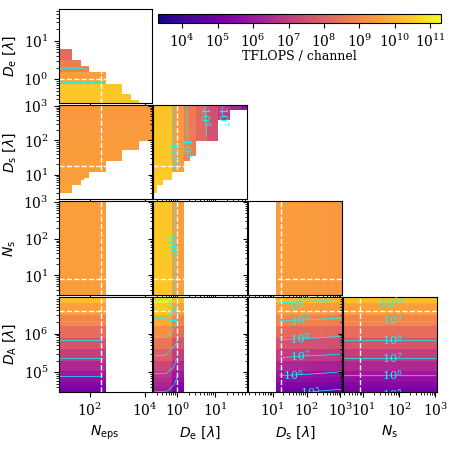

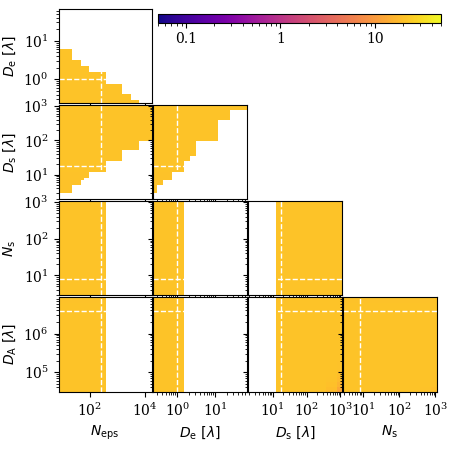

In [154]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2EPIC:
    yax, xax = slices_1BF_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2EPIC[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e3, vmax=2e11), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2EPIC_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2EPIC_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2EPIC:
    yax, xax = slices_1BF_2EPIC[(r,c)]['axkey']
    arr = NP.copy(slices_1BF_2EPIC[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1BF_2EPIC_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2EPIC_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_per_pixel_2EPIC_cost_LAMBDA-I.pdf


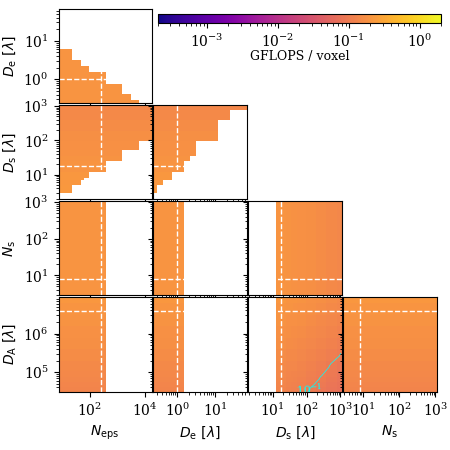

In [155]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2EPIC_per_pixel:
    yax, xax = slices_1BF_2EPIC_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2EPIC_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('GFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2EPIC_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_per_pixel_2EPIC_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1BF_2EPIC_per_pixel:
#     yax, xax = slices_1BF_2EPIC_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1BF_2EPIC_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1BF_2EPIC_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1BF_2EPIC_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station BF + Inter-station XBF

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XBF_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XBF_relative_cost_LAMBDA-I.pdf


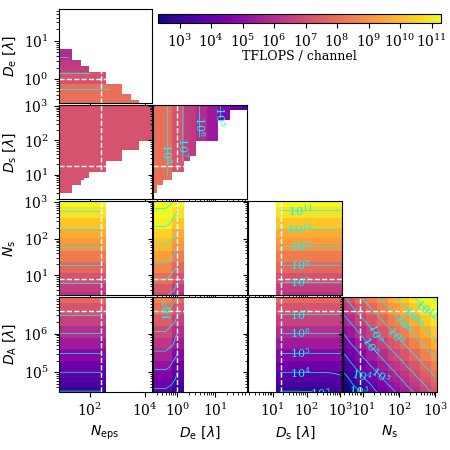

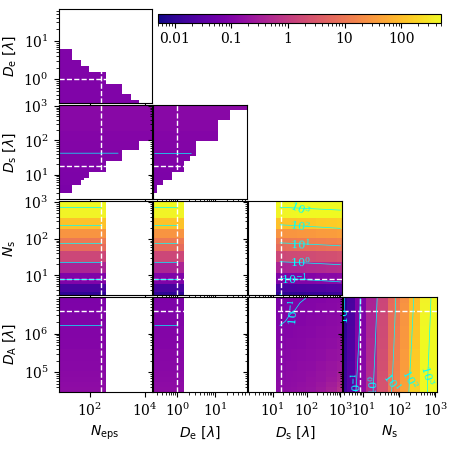

In [156]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XBF:
    yax, xax = slices_1BF_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2XBF[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e2, vmax=2e11), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XBF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XBF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XBF:
    yax, xax = slices_1BF_2XBF[(r,c)]['axkey']
    arr = NP.copy(slices_1BF_2XBF[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=5e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1BF_2XBF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XBF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XBF_per_pixel_cost_LAMBDA-I.pdf


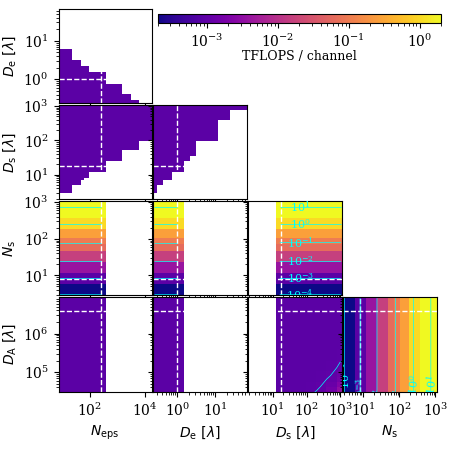

In [157]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XBF_per_pixel:
    yax, xax = slices_1BF_2XBF_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2XBF_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XBF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XBF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1BF_2XBF_per_pixel:
#     yax, xax = slices_1BF_2XBF_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1BF_2XBF_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1BF_2XBF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1BF_2XBF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station BF + Inter-station XFFT

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XFFT_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XFFT_relative_cost_LAMBDA-I.pdf


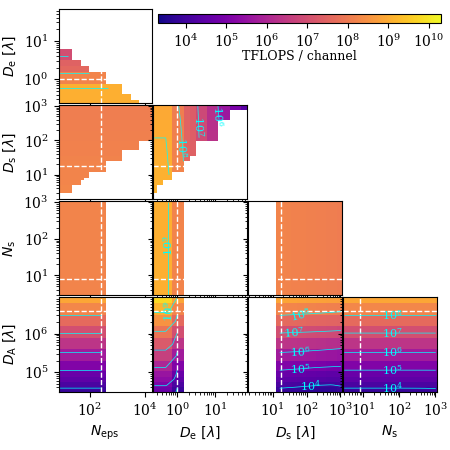

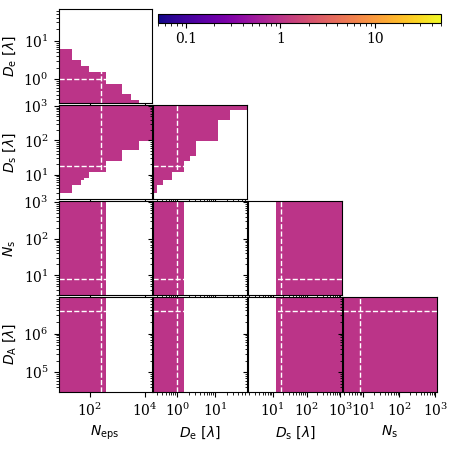

In [158]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XFFT:
    yax, xax = slices_1BF_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2XFFT[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e3, vmax=2e10), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XFFT_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XFFT_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XFFT:
    yax, xax = slices_1BF_2XFFT[(r,c)]['axkey']
    arr = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1BF_2XFFT_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XFFT_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1BF_2XFFT_per_pixel_cost_LAMBDA-I.pdf


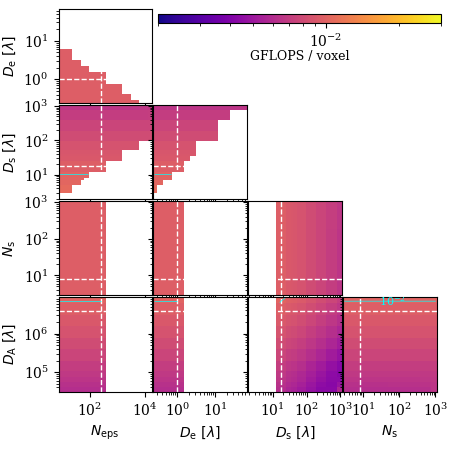

In [159]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1BF_2XFFT_per_pixel:
    yax, xax = slices_1BF_2XFFT_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-3, vmax=3e-2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('GFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XFFT_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1BF_2XFFT_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1BF_2XFFT_per_pixel:
#     yax, xax = slices_1BF_2XFFT_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1BF_2XFFT_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1BF_2XFFT_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station EPIC + Inter-station BF

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2BF_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2BF_relative_cost_LAMBDA-I.pdf


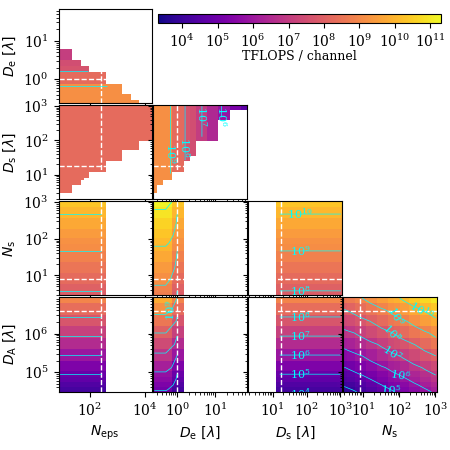

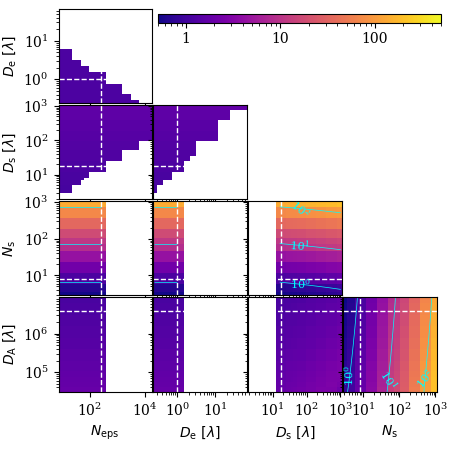

In [160]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2BF:
    yax, xax = slices_1EPIC_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2BF[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e3, vmax=2e11), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2BF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2BF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2BF:
    yax, xax = slices_1EPIC_2BF[(r,c)]['axkey']
    arr = NP.copy(slices_1EPIC_2BF[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-1, vmax=5e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
           
PLT.savefig(figdir+'multidim_1EPIC_2BF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2BF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2BF_per_pixel_cost_LAMBDA-I.pdf


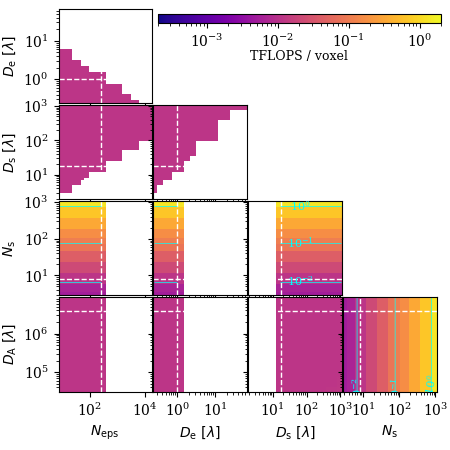

In [161]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2BF_per_pixel:
    yax, xax = slices_1EPIC_2BF_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2BF_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2BF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2BF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1EPIC_2BF_per_pixel:
#     yax, xax = slices_1EPIC_2BF_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1EPIC_2BF_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
           
# # PLT.savefig(figdir+'multidim_1EPIC_2BF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1EPIC_2BF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station EPIC + Inter-station EPIC

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2EPIC_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2EPIC_relative_cost_LAMBDA-I.pdf


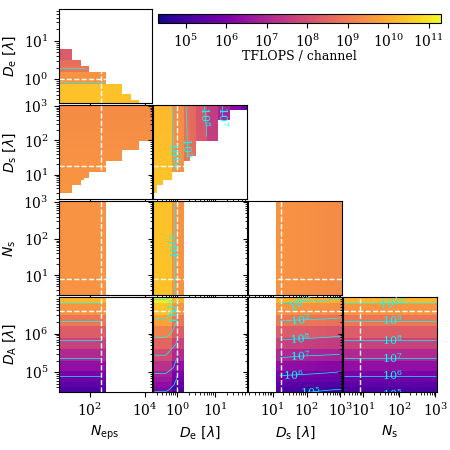

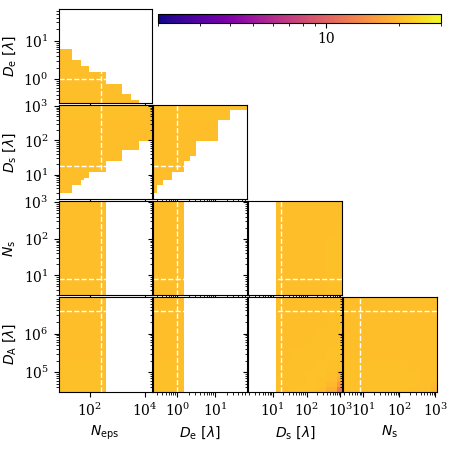

In [162]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2EPIC:
    yax, xax = slices_1EPIC_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2EPIC[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e4, vmax=2e11), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2EPIC_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2EPIC:
    yax, xax = slices_1EPIC_2EPIC[(r,c)]['axkey']
    arr = NP.copy(slices_1EPIC_2EPIC[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=2e0, vmax=3e1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1EPIC_2EPIC_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2EPIC_per_pixel_cost_LAMBDA-I.pdf


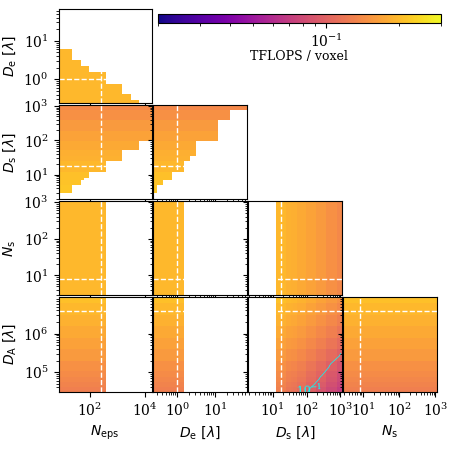

In [163]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2EPIC_per_pixel:
    yax, xax = slices_1EPIC_2EPIC_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2EPIC_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-2, vmax=3e-1), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2EPIC_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1EPIC_2EPIC_per_pixel:
#     yax, xax = slices_1EPIC_2EPIC_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1EPIC_2EPIC_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1EPIC_2EPIC_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station EPIC + Inter-station XBF

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XBF_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XBF_relative_cost_LAMBDA-I.pdf


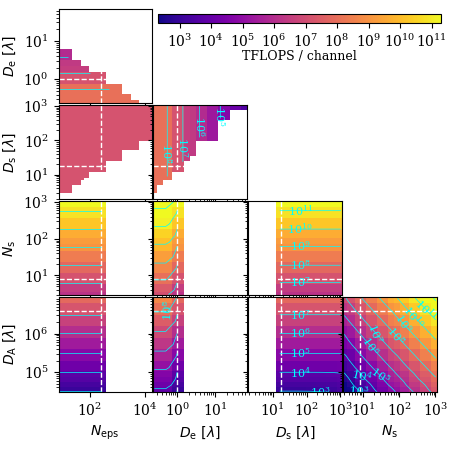

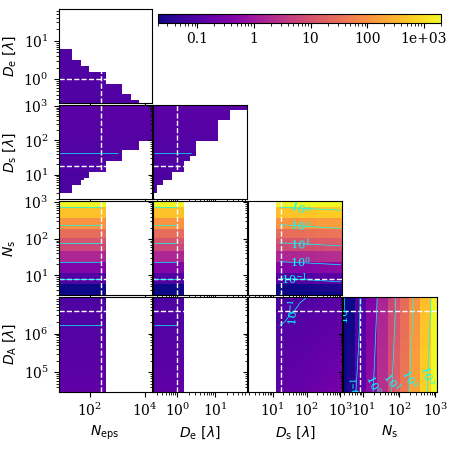

In [164]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XBF:
    yax, xax = slices_1EPIC_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2XBF[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e2, vmax=2e11), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XBF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XBF_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XBF:
    yax, xax = slices_1EPIC_2XBF[(r,c)]['axkey']
    arr = NP.copy(slices_1EPIC_2XBF[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=2e-2, vmax=2e3), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1EPIC_2XBF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XBF_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XBF_per_pixel_cost_LAMBDA-I.pdf


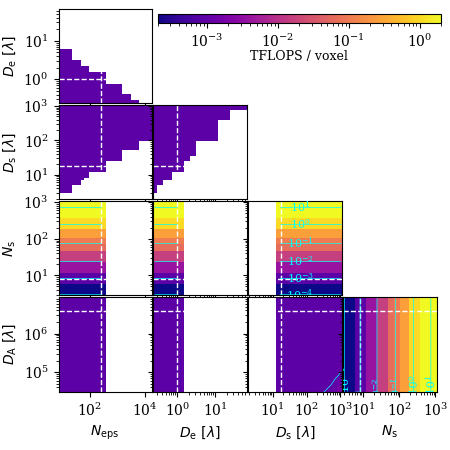

In [165]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XBF_per_pixel:
    yax, xax = slices_1EPIC_2XBF_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2XBF_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-4, vmax=2e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XBF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XBF_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1EPIC_2XBF_per_pixel:
#     yax, xax = slices_1EPIC_2XBF_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1EPIC_2XBF_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1EPIC_2XBF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1EPIC_2XBF_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Intra-station EPIC + Inter-station XFFT

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XFFT_cost_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XFFT_relative_cost_LAMBDA-I.pdf


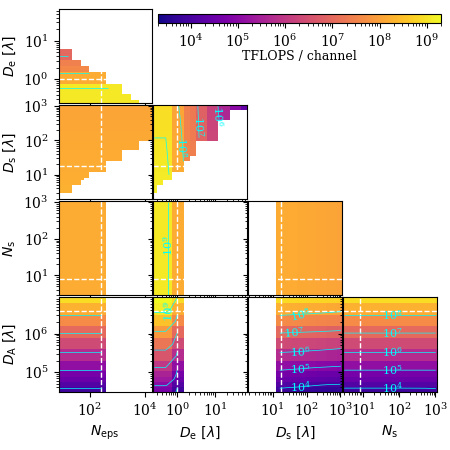

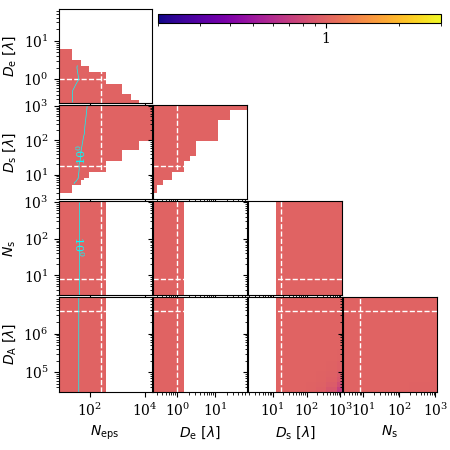

In [166]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XFFT:
    yax, xax = slices_1EPIC_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2XFFT[(r,c)]['array']).to('tflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e3, vmax=2e9), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XFFT_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XFFT:
    yax, xax = slices_1EPIC_2XFFT[(r,c)]['axkey']
    arr = NP.copy(slices_1EPIC_2XFFT[(r,c)]['array'])
    arr_ref = NP.copy(slices_1BF_2XFFT[(r,c)]['array'])
    ratio = (arr / arr_ref).decompose().value.squeeze()
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=2e-1, vmax=3e0), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
PLT.savefig(figdir+'multidim_1EPIC_2XFFT_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_relative_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/multidim_1EPIC_2XFFT_per_pixel_cost_LAMBDA-I.pdf


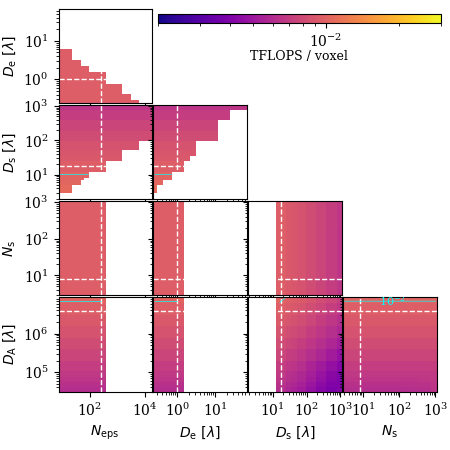

In [167]:
nrows = len(axes_to_plot_coherent)-1
ncols = nrows

fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_1EPIC_2XFFT_per_pixel:
    yax, xax = slices_1EPIC_2XFFT_per_pixel[(r,c)]['axkey']
    imgvals = NP.copy(slices_1EPIC_2XFFT_per_pixel[(r,c)]['array']).to('gflops').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.value.astype(float), norm=PLTC.LogNorm(vmin=2e-3, vmax=3e-2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
#     fmt = ticker.LogFormatterMathtext()
    fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
#     if yax>axes_to_plot_coherent[0]:
#         ax.tick_params(axis='x', labelbottom=False)
#     if xax<axes_to_plot_coherent[-1]:
#         ax.tick_params(axis='y', labelleft=False)
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
#     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=11)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
cbar.set_label('TFLOPS / voxel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XFFT_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

########################

# fig = PLT.figure(figsize=(4.5,4.5))
# gs = fig.add_gridspec(nrows, ncols, left=0.13, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

# for r,c in slices_1EPIC_2XFFT_per_pixel:
#     yax, xax = slices_1EPIC_2XFFT_per_pixel[(r,c)]['axkey']
#     arr = NP.copy(slices_1EPIC_2XFFT_per_pixel[(r,c)]['array'])
#     arr_ref = NP.copy(slices_1BF_2XFFT_per_pixel[(r,c)]['array'])
#     ratio = (arr / arr_ref).decompose().value.squeeze()
#     log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
#     log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
#     nlevs = int(log10_max_ratio - log10_min_ratio) + 1
#     clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

#     ax = fig.add_subplot(gs[r,c])
#     compcost_ratio_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=5e-2, vmax=5e1), shading='nearest', cmap='plasma')
#     ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
#     ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

#     try:
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
#     except Exception as err:
#         print(repr(err))
#         clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
#         compcost_ratio_cntr = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
# #     fmt = ticker.LogFormatterMathtext()
#     fmt = ticker.LogFormatterSciNotation(minor_thresholds=(NP.inf, NP.inf))
#     fmt.create_dummy_axis()
#     ax.clabel(compcost_ratio_cntr, inline=False, fmt=fmt, fontsize=8)

#     ax.set_xscale(axs_scales[xax])
#     ax.set_yscale(axs_scales[yax])
# #     if yax>axes_to_plot_coherent[0]:
# #         ax.tick_params(axis='x', labelbottom=False)
# #     if xax<axes_to_plot_coherent[-1]:
# #         ax.tick_params(axis='y', labelleft=False)
#     if r<nrows-1:
#         ax.tick_params(axis='x', labelbottom=False)
#     if c>0:
#         ax.tick_params(axis='y', labelleft=False)
# #     ax.yaxis.set_major_locator(ticker.MaxNLocator(2))
# #     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# #     ax.locator_params(axis='x', nbins=3)
#     ax.set_ylim(axs_min[yax], axs_max[yax])
#     ax.set_xlim(axs_min[xax], axs_max[xax])
#     if c==0:
#         ax.set_ylabel(axs_labels[yax])
#     if r==nrows-1:
#         ax.set_xlabel(axs_labels[xax])
# #     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
# #     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

# for r in range(nrows):
#     for c in range(ncols):
#         if c>r:
#             ax = fig.add_subplot(gs[r,c])
#             ax.remove()

# cbax = fig.add_axes([0.35, 0.95, 0.63, 0.02])
# cbar = PLT.colorbar(compcost_ratio_img, cax=cbax, orientation='horizontal')
# cbax.xaxis.set_ticks_position('bottom')
# cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
# cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
            
# # PLT.savefig(figdir+'multidim_1EPIC_2XFFT_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches='tight')
# print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_relative_per_pixel_cost_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Plot 1D slices of total cost comparing different coherent-coherent imaging architectures

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_compcost_analysis_AU-VLBA-Low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architect

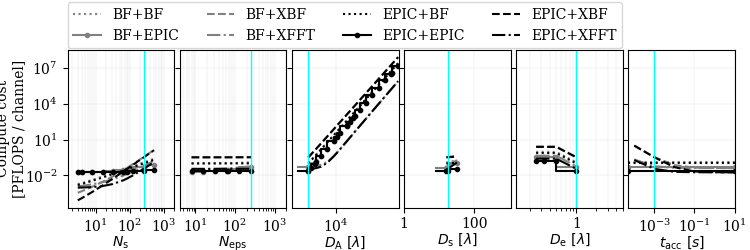

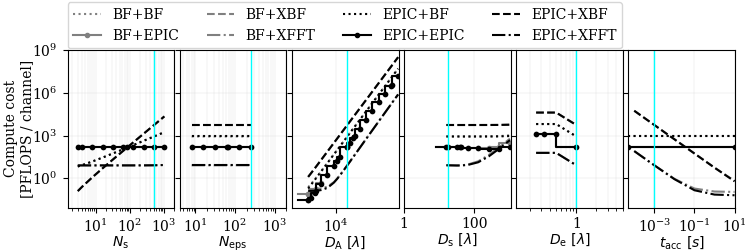

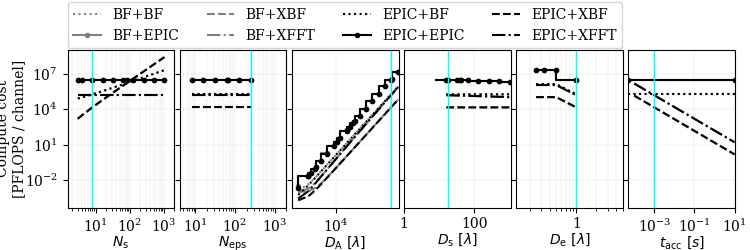

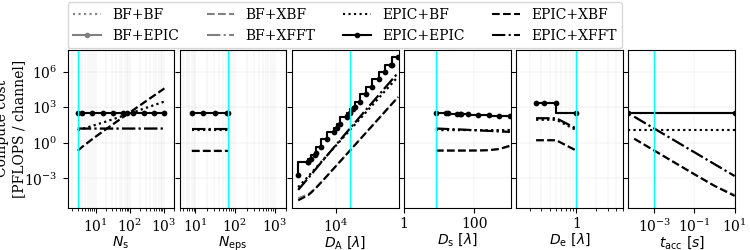

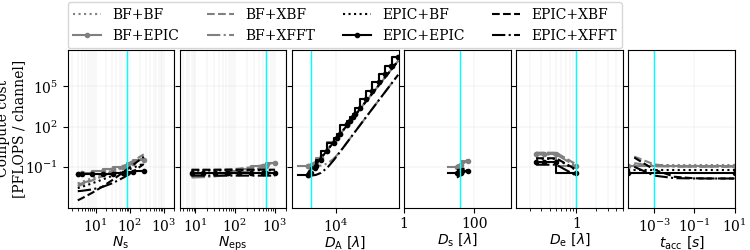

...

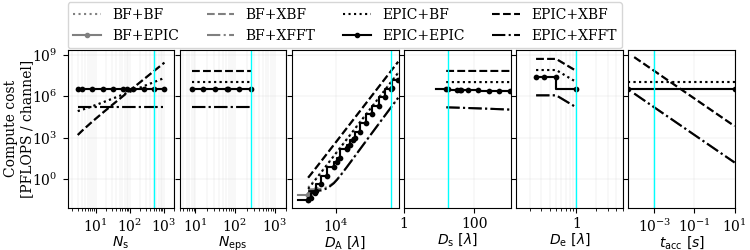

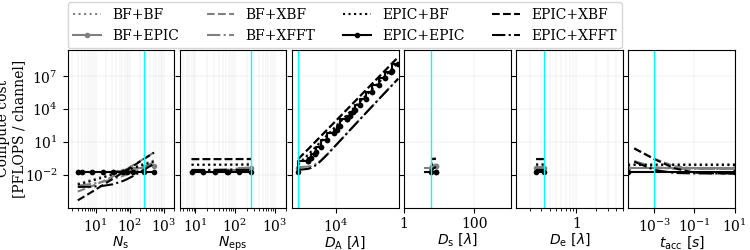

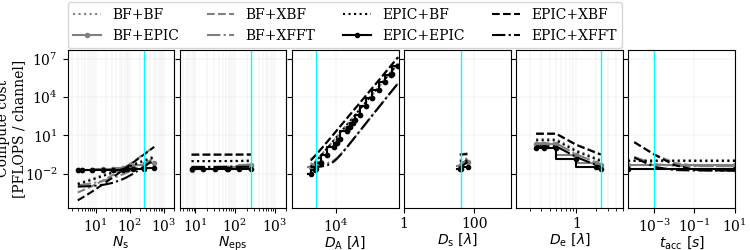

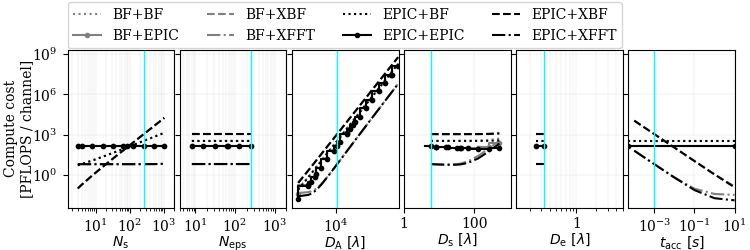

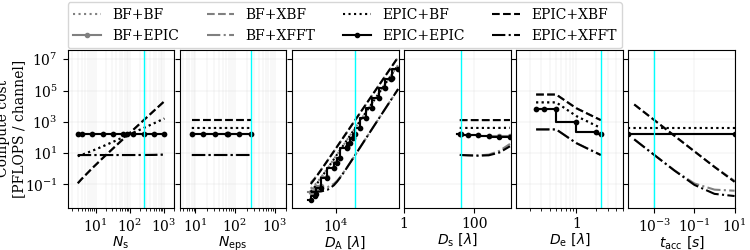

In [168]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.5*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]

#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.5*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.5*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,2.5))

    axs[0].plot(nstations, flops_1BF_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, flops_1BF_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[0].plot(nstations, flops_1BF_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, flops_1BF_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, flops_1EPIC_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[0].plot(nstations, flops_1EPIC_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, flops_1EPIC_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xlim(0.5*nstations.min(), 2000)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[PFLOPS / channel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, flops_1BF_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, flops_1BF_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[1].plot(nants_in_station, flops_1BF_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, flops_1BF_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, flops_1EPIC_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, flops_1EPIC_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, flops_1EPIC_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xlim(0.5*nants_in_station.min(), 2000)
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[1].set_xticklabels(axs[1].get_xticks(), fontsize=9, rotation=60)
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, flops_1BF_2BF[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, flops_1BF_2EPIC[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[2].plot(array_dia, flops_1BF_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, flops_1BF_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, flops_1EPIC_2BF[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[2].plot(array_dia, flops_1EPIC_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, flops_1EPIC_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, flops_1BF_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, flops_1BF_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[3].plot(station_dia, flops_1BF_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, flops_1BF_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, flops_1EPIC_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[3].plot(station_dia, flops_1EPIC_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, flops_1EPIC_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, flops_1BF_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, flops_1BF_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[4].plot(ant_dia, flops_1BF_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, flops_1BF_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, flops_1EPIC_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[4].plot(ant_dia, flops_1EPIC_2XBF[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, flops_1EPIC_2XFFT[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xlim(0.5*ant_dia.min(), 5)
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[5].axhline(flops_1BF_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='gray', ls=':', label='BF+BF')
    axs[5].axhline(flops_1BF_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[5].plot(tacc, flops_1BF_2XBF[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[5].plot(tacc, flops_1BF_2XFFT[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[5].axhline(flops_1EPIC_2BF[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='black', ls=':', label='EPIC+BF')
    axs[5].axhline(flops_1EPIC_2EPIC[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[5].plot(tacc, flops_1EPIC_2XBF[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[5].plot(tacc, flops_1EPIC_2XFFT[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[5].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[5].set_xlim(0.5*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[5].set_xscale('log')
    axs[5].set_yscale('log')
    axs[5].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax5_xticks = ticker.LogLocator(base=10.0, numticks=5)
    axs[5].xaxis.set_major_locator(ax5_xticks)
    axs[5].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.17, right=0.98, left=0.09, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_coherent_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_coherent_compcost_analysis_{0}.pdf'.format(charr['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_pixel_compcost_analysis_AU-VLBA-Low.pdf
S

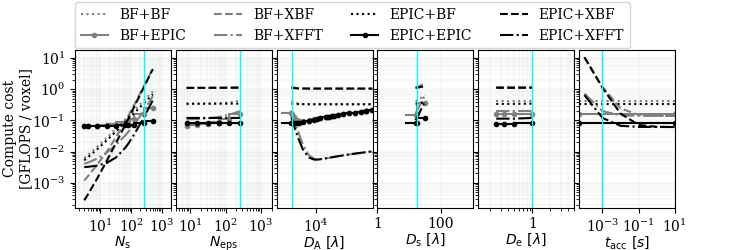

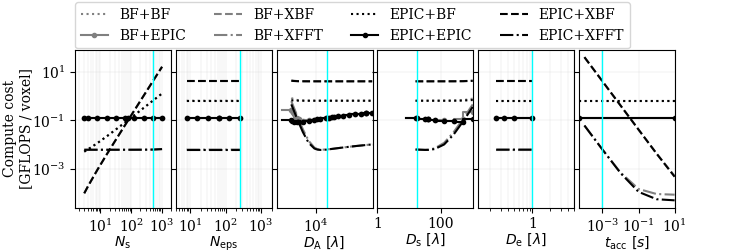

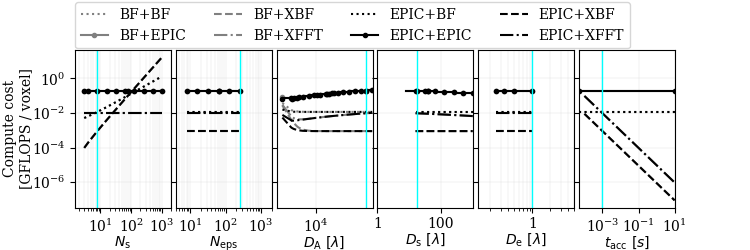

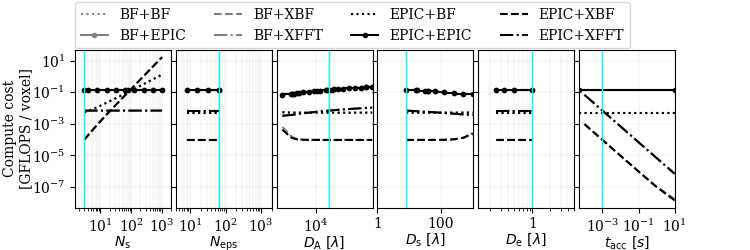

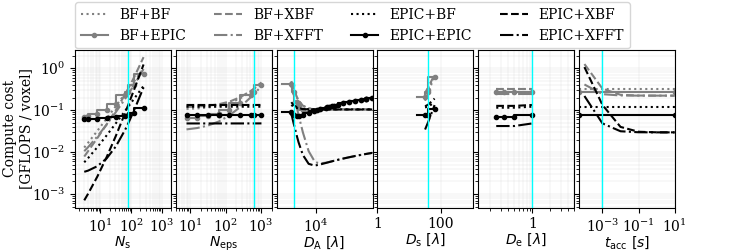

...

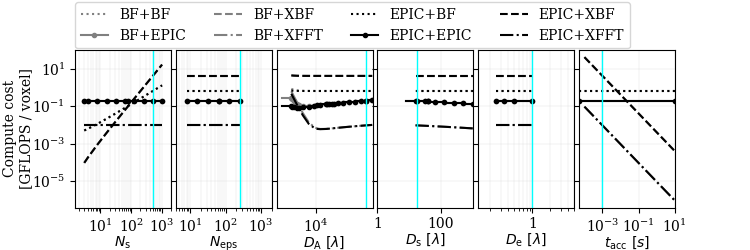

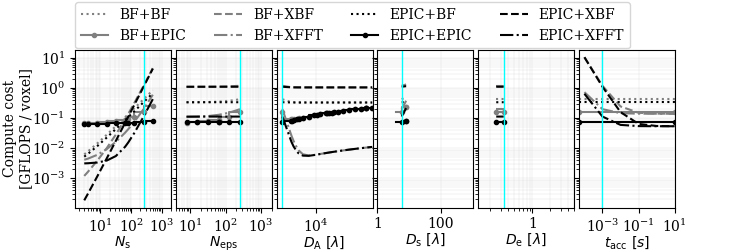

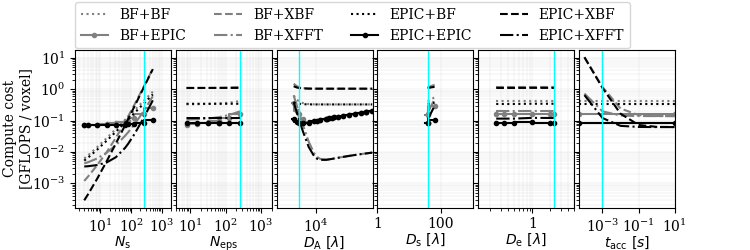

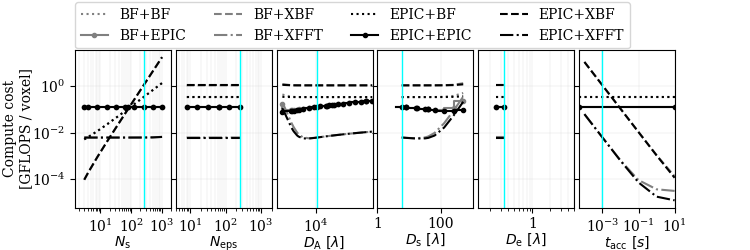

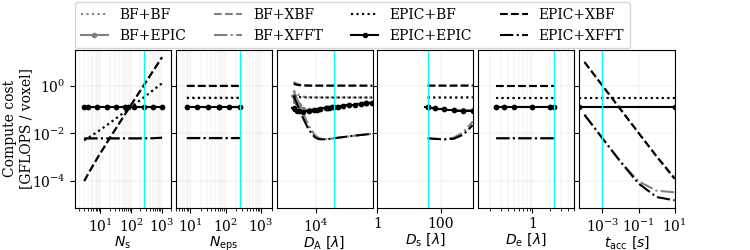

In [169]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.5*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]

#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.5*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.5*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,2.5))

    axs[0].plot(nstations, flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[0].plot(nstations, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[0].plot(nstations, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xlim(0.5*nstations.min(), 2000)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[GFLOPS / voxel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[1].plot(nants_in_station, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xlim(0.5*nants_in_station.min(), 2000)
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[1].set_xticklabels(axs[1].get_xticks(), fontsize=9, rotation=60)
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[2].plot(array_dia, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[2].plot(array_dia, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[3].plot(station_dia, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[3].plot(station_dia, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[4].plot(ant_dia, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[4].plot(ant_dia, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xlim(0.5*ant_dia.min(), 5)
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[5].axhline(flops_1BF_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops).value, color='gray', ls=':', label='BF+BF')
    axs[5].axhline(flops_1BF_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops).value, color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[5].plot(tacc, flops_1BF_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='--', label='BF+XBF')
    axs[5].plot(tacc, flops_1BF_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='gray', ls='-.', label='BF+XFFT')
    axs[5].axhline(flops_1EPIC_2BF_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops).value, color='black', ls=':', label='EPIC+BF')
    axs[5].axhline(flops_1EPIC_2EPIC_per_beam_in_sta_fov[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops).value, color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[5].plot(tacc, flops_1EPIC_2XBF_per_beam_in_sta_fov[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='--', label='EPIC+XBF')
    axs[5].plot(tacc, flops_1EPIC_2XFFT_per_beam_in_sta_fov[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(gflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[5].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[5].set_xlim(0.5*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[5].set_xscale('log')
    axs[5].set_yscale('log')
    axs[5].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax5_xticks = ticker.LogLocator(base=10.0, numticks=5)
    axs[5].xaxis.set_major_locator(ax5_xticks)
    axs[5].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.17, right=0.9, left=0.1, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_coherent_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_coherent_per_pixel_compcost_analysis_{0}.pdf'.format(charr['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_per_element_compcost_analysis_AU-

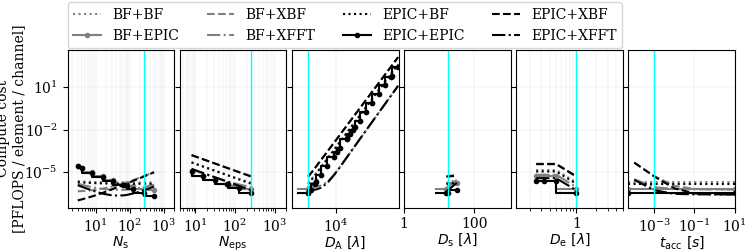

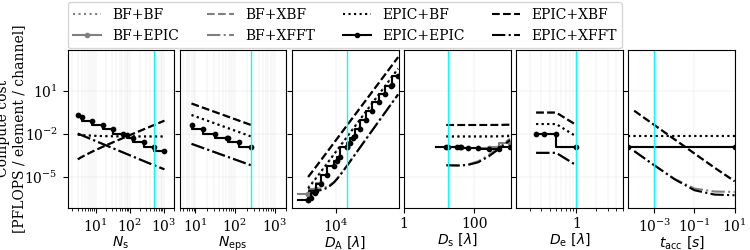

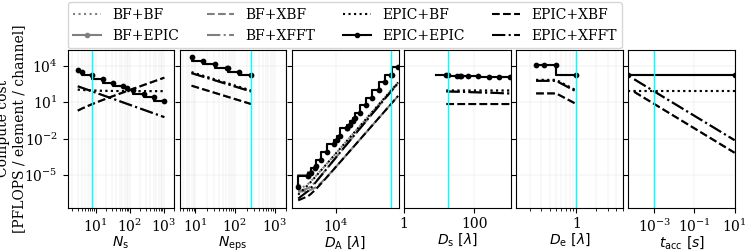

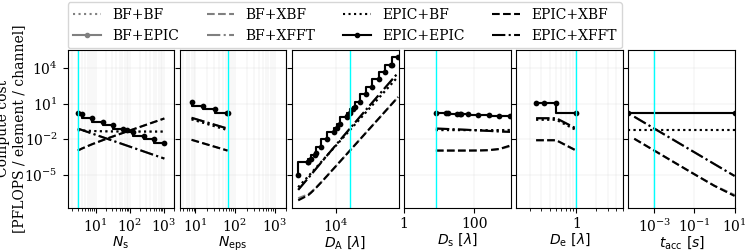

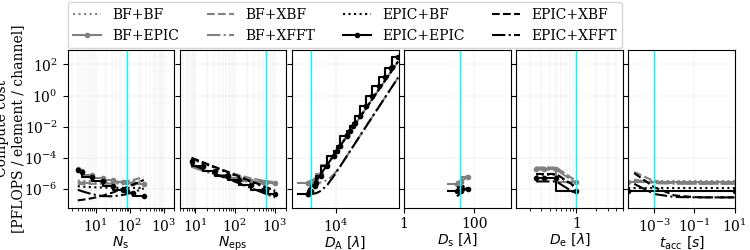

...

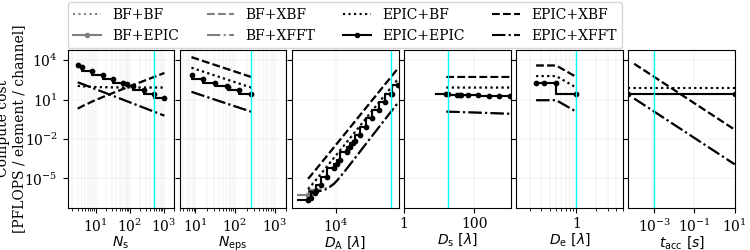

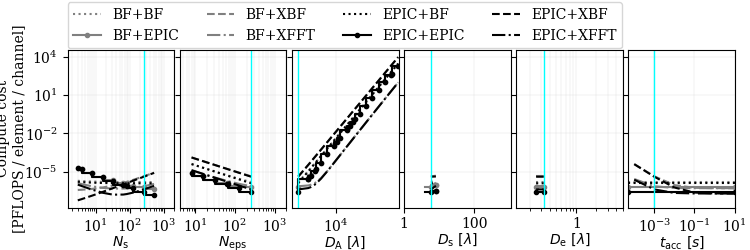

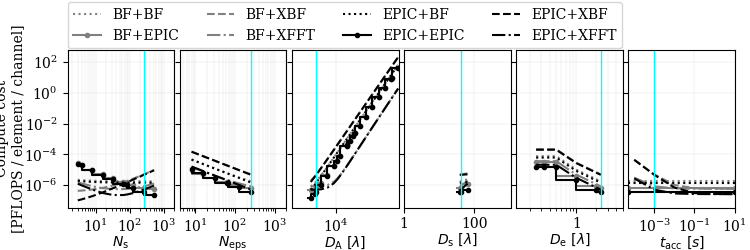

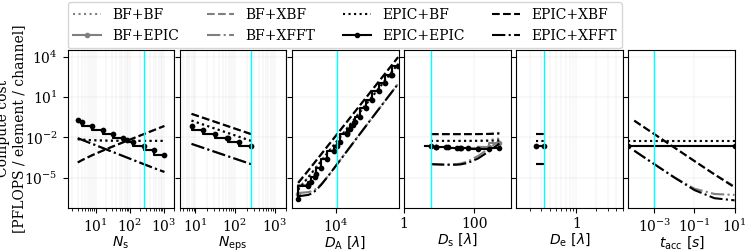

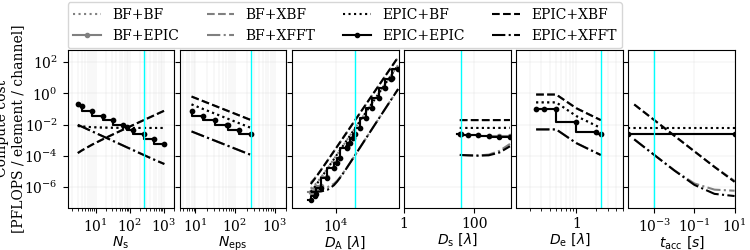

In [170]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.5*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]

#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.5*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.5*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,2.5))

    axs[0].plot(nstations, (flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, (flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[0].plot(nstations, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, (flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, (flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[0].plot(nstations, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xlim(0.5*nstations.min(), 2000)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[PFLOPS / element / channel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, (flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, (flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[1].plot(nants_in_station, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, (flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, (flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xlim(0.5*nants_in_station.min(), 2000)
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[1].set_xticklabels(axs[1].get_xticks(), fontsize=9, rotation=60)
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, (flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, (flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[2].plot(array_dia, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, (flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, (flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[2].plot(array_dia, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, (flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, (flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[3].plot(station_dia, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, (flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, (flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[3].plot(station_dia, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, (flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, (flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[4].plot(ant_dia, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, (flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, (flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[4].plot(ant_dia, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xlim(0.5*ant_dia.min(), 5)
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[5].axhline((flops_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='gray', ls=':', label='BF+BF')
    axs[5].axhline((flops_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[5].plot(tacc, (flops_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='--', label='BF+XBF')
    axs[5].plot(tacc, (flops_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='gray', ls='-.', label='BF+XFFT')
    axs[5].axhline((flops_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='black', ls=':', label='EPIC+BF')
    axs[5].axhline((flops_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,0,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops).value, color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[5].plot(tacc, (flops_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='--', label='EPIC+XBF')
    axs[5].plot(tacc, (flops_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflops), color='black', ls='-.', label='EPIC+XFFT')
    axs[5].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[5].set_xlim(0.5*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[5].set_xscale('log')
    axs[5].set_yscale('log')
    axs[5].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax5_xticks = ticker.LogLocator(base=10.0, numticks=5)
    axs[5].xaxis.set_major_locator(ax5_xticks)
    axs[5].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.17, right=0.98, left=0.09, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_coherent_per_element_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_coherent_per_element_compcost_analysis_{0}.pdf'.format(charr['name']))

Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_SKA1-low-core.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_SKA1-low.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_LAMBDA-I.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_CASPA.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_FarView.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_LAMBDA-II.pdf
Saved at: /mnt/data/users/thy009/projects/multi-scale-imaging-architectures/figures/v3.5/1D_coherent_relative_compcost_analysis_AU-VLBA-Low.pdf
Saved at

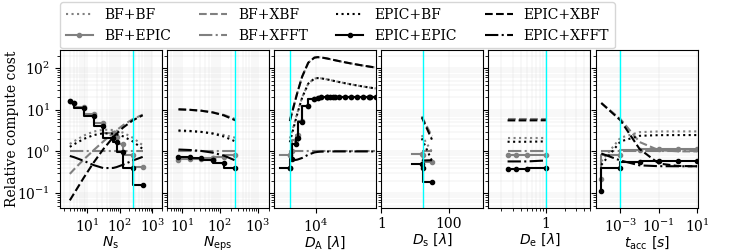

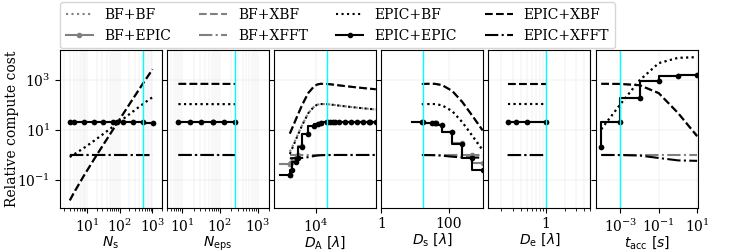

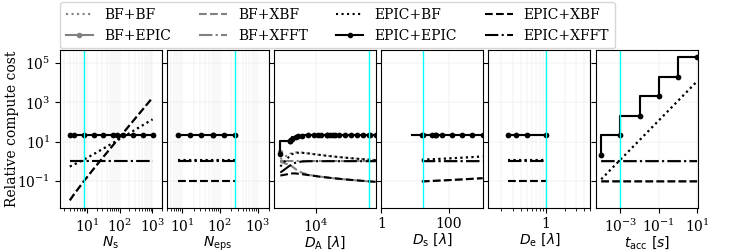

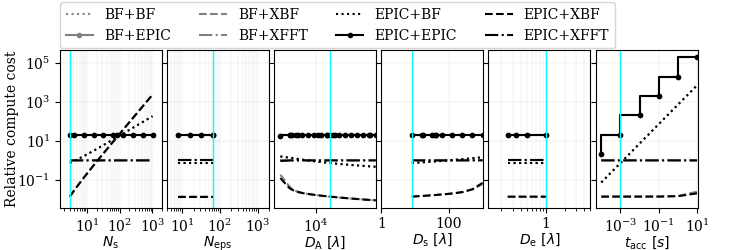

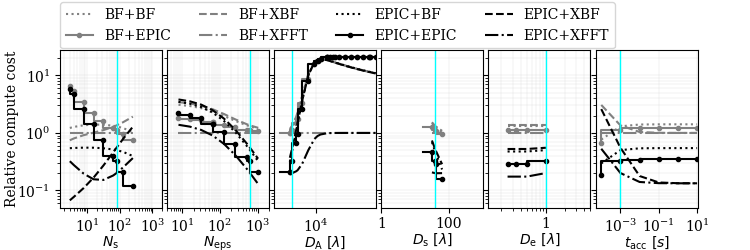

...

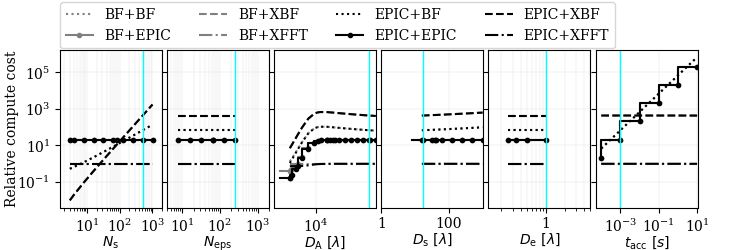

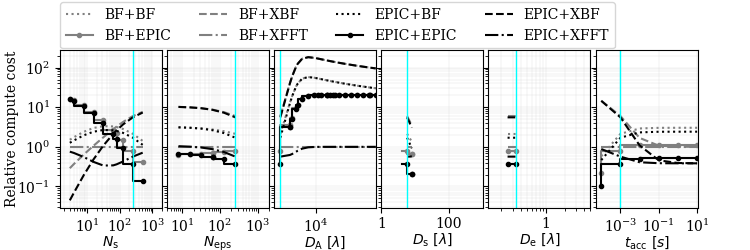

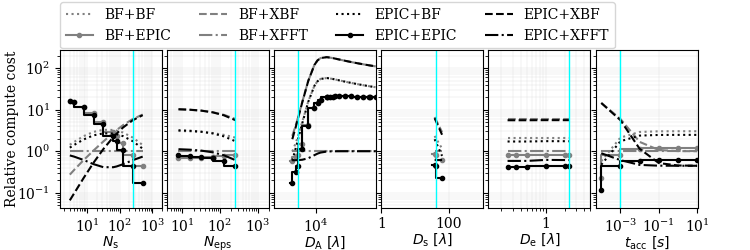

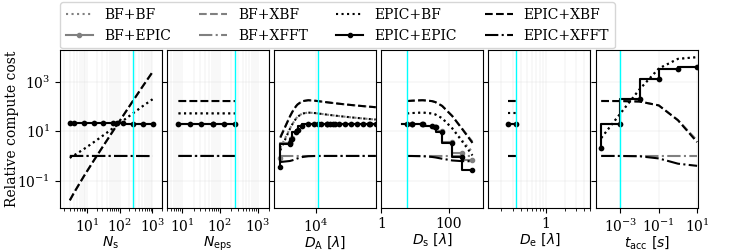

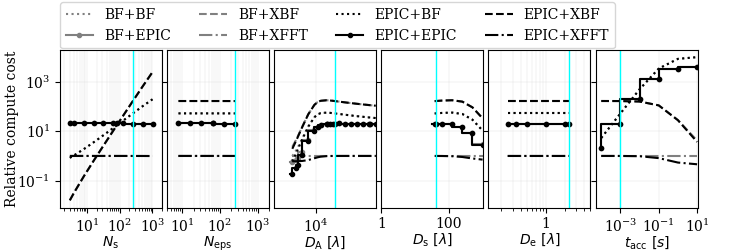

In [171]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_zcut, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.5*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]

#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.5*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.5*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent) + 1
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,2.5))

    axs[0].plot(nstations, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[0].plot(nstations, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[0].plot(nstations, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    # axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xlim(0.5*nstations.min(), 2000)
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Relative compute cost', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[1].plot(nants_in_station, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    # axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xlim(0.5*nants_in_station.min(), 2000)
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[1].set_xticklabels(axs[1].get_xticks(), fontsize=9, rotation=60)
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[2].plot(array_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[2].plot(array_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[3].plot(station_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[3].plot(station_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[4].plot(ant_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[4].plot(ant_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    # axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xlim(0.5*ant_dia.min(), 5)
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[5].plot(tacc, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[5].plot(tacc, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
    axs[5].plot(tacc, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[5].plot(tacc, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[5].plot(tacc, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[5].plot(tacc, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
    axs[5].plot(tacc, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[5].plot(tacc, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[5].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
    axs[5].set_xlim(0.5*tacc.min().si.value, 1.05*tacc.max().si.value)
    axs[5].set_xscale('log')
    axs[5].set_yscale('log')
    axs[5].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax5_xticks = ticker.LogLocator(base=10.0, numticks=5)
    axs[5].xaxis.set_major_locator(ax5_xticks)
    axs[5].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.17, right=0.93, left=0.08, top=0.8, wspace=0.05, hspace=0)

    # PLT.savefig(figdir+'1D_coherent_relative_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
    print('Saved at: '+figdir+'1D_coherent_relative_compcost_analysis_{0}.pdf'.format(charr['name']))

In [172]:
# for chosenarr in range(len(arrs)):
#     charr, charr_nominal_vals, charr_ind_nominal_npol, charr_ind_nominal_tacc, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

#     charr_axs_min = []*len(charr_nominal_vals)
#     charr_axs_max = []*len(charr_nominal_vals)
#     for charr_axi,charr_axv in enumerate(axs_vals):
#         charr_axs_min += [0.5*charr_axv.min()]
#         charr_axs_max += [1.05*charr_axv.max()]

# #     charr_axs_min = []*len(charr_nominal_vals)
# #     charr_axs_max = []*len(charr_nominal_vals)
# #     for charr_axi,charr_axv in enumerate(axs_vals):
# #         if charr_axi == 1:
# #             if chosenarr in [2,3]:
# #                 charr_axs_min += [0.5*charr_axv.min()]
# #                 charr_axs_max += [1.05e4*charr_axv.min()]
# #             else:
# #                 charr_axs_min += [0.95e-4*charr_axv.max()]
# #                 charr_axs_max += [1.05*charr_axv.max()]
# #         else:
# #             charr_axs_min += [0.5*charr_axv.min()]
# #             charr_axs_max += [1.05*charr_axv.max()]

#     ncols = len(axes_to_plot_coherent) + 1
#     fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,2.5))

#     axs[0].plot(nstations, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[0].plot(nstations, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[0].plot(nstations, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[0].plot(nstations, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[0].plot(nstations, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[0].plot(nstations, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[0].plot(nstations, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[0].plot(nstations, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
#     axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
#     axs[0].set_ylim(0.9993, 1.0003)
#     axs[0].set_xscale('log')
#     axs[0].set_yscale('log')
#     axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     axs[0].yaxis.set_major_locator(ax0_yticks)
# #     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
# #     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
#     axs[0].set_ylabel('Relative compute cost', fontsize=10, labelpad=-1)
#     axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
#     axs[1].plot(nants_in_station, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[1].plot(nants_in_station, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[1].plot(nants_in_station, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[1].plot(nants_in_station, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[1].plot(nants_in_station, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[1].plot(nants_in_station, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[1].plot(nants_in_station, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[1].plot(nants_in_station, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
#     axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
#     axs[1].set_xscale('log')
#     axs[1].set_yscale('log')
#     axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     axs[1].yaxis.set_major_locator(ax1_yticks)
# #     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# #     axs[1].set_xticklabels(axs[1].get_xticks(), fontsize=9, rotation=60)
#     axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

#     axs[2].plot(array_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[2].plot(array_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[2].plot(array_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[2].plot(array_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[2].plot(array_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[2].plot(array_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[2].plot(array_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[2].plot(array_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
#     axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
#     axs[2].set_xscale('log')
#     axs[2].set_yscale('log')
#     axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     axs[2].yaxis.set_major_locator(ax2_yticks)
# #     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# #     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
#     axs[3].plot(station_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[3].plot(station_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[3].plot(station_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[3].plot(station_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[3].plot(station_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[3].plot(station_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[3].plot(station_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[3].plot(station_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
#     axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
#     axs[3].set_xscale('log')
#     axs[3].set_yscale('log')
#     axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
#     axs[3].yaxis.set_major_locator(ax3_yticks)
#     axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
#     axs[4].plot(ant_dia, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[4].plot(ant_dia, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[4].plot(ant_dia, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[4].plot(ant_dia, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[4].plot(ant_dia, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[4].plot(ant_dia, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[4].plot(ant_dia, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[4].plot(ant_dia, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_tacc,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
#     axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
#     axs[4].set_xscale('log')
#     axs[4].set_yscale('log')
#     axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
#     axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
#     axs[5].plot(tacc, (flops_1BF_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
#     axs[5].plot(tacc, (flops_1BF_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-pre', label='BF+EPIC')
#     axs[5].plot(tacc, (flops_1BF_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
#     axs[5].plot(tacc, (flops_1BF_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
#     axs[5].plot(tacc, (flops_1EPIC_2BF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
#     axs[5].plot(tacc, (flops_1EPIC_2EPIC/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-pre', label='EPIC+EPIC')
#     axs[5].plot(tacc, (flops_1EPIC_2XBF/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
#     axs[5].plot(tacc, (flops_1EPIC_2XFFT/flops_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
#     axs[5].axvline(tacc[charr_ind_nominal_tacc].si.value, color='cyan', ls='-', lw=1)
#     axs[5].set_xlim(0.5*tacc.min().si.value, 1.05*tacc.max().si.value)
#     axs[5].set_xscale('log')
#     axs[5].set_yscale('log')
#     axs[5].grid(axis='both', which='both', lw=0.2, color='lightgray')
#     ax5_xticks = ticker.LogLocator(base=10.0, numticks=5)
#     axs[5].xaxis.set_major_locator(ax5_xticks)
#     axs[5].set_xlabel(r'$t_\mathrm{acc}\,\, [s]$', fontsize=10, labelpad=0)
    
#     PLT.subplots_adjust(bottom=0.17, right=0.98, left=0.1, top=0.8, wspace=0.05, hspace=0)

# #     PLT.savefig(figdir+'1D_coherent_relative_compcost_analysis_{0}.pdf'.format(charr['name']), bbox_inches='tight')
# #     print('Saved at: '+figdir+'1D_coherent_relative_compcost_analysis_{0}.pdf'.format(charr['name']))

## Define transient parameters

In [137]:
psd_pulse_typical = 1e33 * U.erg / U.s / U.Hz # at L-band from Bochenek et al (2020), Nature, 587, 59 [fig. 3]
pulse_duration_typical = 1 * U.ms # at L-band from Bochenek et al (2020), Nature, 587, 59 [fig. 3] 
freq_typical = 1.4 * U.GHz 
bw_pulse = 40 * U.MHz # at 150 MHz
twidth_pulse = 100 * U.ms # at 150 MHz
spindex_pulse = 0.0 # spectral index of pulse
plindex = -1.5 # power law of luminosity function
lum_pulse_typical = psd_pulse_typical * bw_pulse # bolometric at L-band
esd_pulse_typical = psd_pulse_typical * pulse_duration_typical # at L-band
energy_pulse_typical = esd_pulse_typical * bw_pulse # at L-band
detection_snr = 5.0

In [207]:
psd_pulse = psd_pulse_typical * (freq_obs / freq_typical)**spindex_pulse
lum_pulse = lum_pulse_typical * (freq_obs / freq_typical)**spindex_pulse
esd_pulse = esd_pulse_typical * (freq_obs / freq_typical)**spindex_pulse

phi_ = 339 / (1e6*U.kpc)**3 / U.year # From Luo et al. (2020), MNRAS, 494, 665
lum_ = 10**44.46 * U.erg / U.s # From Luo et al. (2020), MNRAS, 494, 665
rate_Luo2020 = frb_vol_rate_Luo_et_al_2020(lum_pulse, plindex=plindex)

In [139]:
print(lum_pulse.to('erg s-1'))
print(rate_Luo2020.to('Gpc-3 yr-1'))

3.9999999999999996e+40 erg / s
56376.72064293789 1 / (Gpc3 yr)


## Calculate sensitivity

In [156]:
per_element_per_pol_Aeff_over_Tsys = 1.7 / (NP.sqrt(2.0)*256) * (ant_area.reshape(1,1,1,1,-1,1)/ant_area[ind_nominal_ant_dia]) * U.m**2 / U.K # Based on Sokolowski+2022 calculator for AAVS2 station Stokes I (at 45deg elevation) for SKA-low dipole element
per_element_per_pol_Aeff_over_Tsys_masked = per_element_per_pol_Aeff_over_Tsys * mask_arr_sta_ant
per_station_per_pol_Aeff_over_Tsys = per_element_per_pol_Aeff_over_Tsys * nants_in_station.reshape(1,1,1,1,1,-1)
per_station_per_pol_Aeff_over_Tsys_masked = per_station_per_pol_Aeff_over_Tsys * mask_arr_sta_ant
# per_station_per_pol_Aeff_over_Tsys = Masked(per_station_per_pol_Aeff_over_Tsys, mask=mask_arr_sta_ant[arr_ind_nominal_array_dia,arr_ind_nominal_nstations,arr_ind_nominal_station_dia,:,:])

In [157]:
print(per_element_per_pol_Aeff_over_Tsys)
print(per_element_per_pol_Aeff_over_Tsys_masked.shape)
print(per_station_per_pol_Aeff_over_Tsys_masked.shape)
print(ant_area/ant_area[ind_nominal_ant_dia])

[[[[[[1.17390774e-03]
     [4.69563097e-03]
     [1.87825239e-02]
     [7.51300955e-02]
     [3.00520382e-01]
     [1.20208153e+00]
     [4.80832611e+00]
     [1.92333044e+01]]]]]] m2 / K
(1, 19, 8, 10, 8, 7)
(1, 19, 8, 10, 8, 7)
[2.500e-01 1.000e+00 4.000e+00 1.600e+01 6.400e+01 2.560e+02 1.024e+03
 4.096e+03] wl2


### Incoherent combination (coherent only at intra-station level, incoherent at inter-station level)

In [158]:
# visrms_stationwise_beamforming = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys.reshape(1,-1,1), df, tacc, npol=npol.reshape(-1,1,1), n_meas=0.5*nstations.reshape(1,-1,1)*nants_in_station.reshape(1,1,-1)**2, efficiency=1.0)
# visrms_stationwise_epic = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys.reshape(1,-1,1), df, tacc, npol=npol.reshape(-1,1,1), n_meas=0.5*nstations.reshape(1,-1,1)*nants_in_station.reshape(1,1,-1)**2, efficiency=1.0)
# visrms_stationwise_xcor = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys.reshape(1,-1,1), df, tacc, npol=npol.reshape(-1,1,1), n_meas=0.5*nstations.reshape(1,-1,1)*(nants_in_station.reshape(1,1,-1)*(nants_in_station.reshape(1,1,-1)-1)), efficiency=1.0)
# visrms_fullcorr = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys.reshape(1,-1,1), df, tacc, npol=npol.reshape(-1,1,1), n_meas=0.5*(nstations.reshape(1,-1,1)*nants_in_station.reshape(1,1,-1))**2, efficiency=1.0)

visrms_stationwise_beamforming = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys_masked, df, tacc.reshape(1,-1,1,1,1,1,1), npol=npol.reshape(-1,1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,1,-1,1,1,1)*nants_in_station.reshape(1,1,1,1,1,1,-1)**2, efficiency=1.0)
visrms_stationwise_epic = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys_masked, df, tacc.reshape(1,-1,1,1,1,1,1), npol=npol.reshape(-1,1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,1,-1,1,1,1)*nants_in_station.reshape(1,1,1,1,1,1,-1)**2, efficiency=1.0)
visrms_stationwise_xcor = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys_masked, df, tacc.reshape(1,-1,1,1,1,1,1), npol=npol.reshape(-1,1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,1,-1,1,1,1)*(nants_in_station.reshape(1,1,1,1,1,1,-1)*(nants_in_station.reshape(1,1,1,1,1,1,-1)-1)), efficiency=1.0)
visrms_fullcorr = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys_masked, df, tacc.reshape(1,-1,1,1,1,1,1), npol=npol.reshape(-1,1,1,1,1,1,1), n_meas=0.5*(nstations.reshape(1,1,-1,1,1,1)*nants_in_station.reshape(1,1,1,1,1,-1))**2, efficiency=1.0)

bolo_visrms_stationwise_beamforming = visrms_stationwise_beamforming * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_stationwise_epic = visrms_stationwise_epic * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_stationwise_xcor = visrms_stationwise_xcor * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_fullcorr = visrms_fullcorr * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df

fluence_rms_stationwise_beamforming = visrms_stationwise_beamforming * NP.sqrt(twidth_pulse*tacc.reshape(1,-1,1,1,1,1,1)) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_stationwise_epic = visrms_stationwise_epic * NP.sqrt(twidth_pulse*tacc.reshape(1,-1,1,1,1,1,1)) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_stationwise_xcor = visrms_stationwise_xcor * NP.sqrt(twidth_pulse*tacc.reshape(1,-1,1,1,1,1,1)) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_fullcorr = visrms_fullcorr * NP.sqrt(twidth_pulse*tacc.reshape(1,-1,1,1,1,1,1)) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc

bolo_fluence_rms_stationwise_beamforming = fluence_rms_stationwise_beamforming * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_stationwise_epic = fluence_rms_stationwise_epic * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_stationwise_xcor = fluence_rms_stationwise_xcor * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_fullcorr = fluence_rms_fullcorr * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df

In [159]:
print(tacc)
print(per_element_per_pol_Aeff_over_Tsys)
print(per_element_per_pol_Aeff_over_Tsys_masked.shape)
print(mask_pol_arr_sta_ant.shape)

[1.e-04 1.e-03 1.e-02 1.e-01 1.e+00 1.e+01] s
[[[[[[1.17390774e-03]
     [4.69563097e-03]
     [1.87825239e-02]
     [7.51300955e-02]
     [3.00520382e-01]
     [1.20208153e+00]
     [4.80832611e+00]
     [1.92333044e+01]]]]]] m2 / K
(1, 19, 8, 10, 8, 7)
(2, 1, 19, 8, 10, 8, 7)


In [220]:
zmin_stationwise_beamforming_density = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(psd_pulse / (detection_snr*visrms_stationwise_beamforming)), zmax=500000)[0]
zmax_stationwise_beamforming_density = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(psd_pulse / (detection_snr*visrms_stationwise_beamforming)), zmax=500000)[0]
zmin_stationwise_beamforming_bolo = Cosmo.z_at_value(surface_area_modulus_function_alternate, NP.nanmin(lum_pulse / (detection_snr*bolo_visrms_stationwise_beamforming)), zmax=500000)[0]
zmax_stationwise_beamforming_bolo = Cosmo.z_at_value(surface_area_modulus_function_alternate, NP.nanmax(lum_pulse / (detection_snr*bolo_visrms_stationwise_beamforming)), zmax=500000)[0]
print(zmin_stationwise_beamforming_density, zmax_stationwise_beamforming_density)
print(zmin_stationwise_beamforming_bolo, zmax_stationwise_beamforming_bolo)

0.0004046847250088021 17.516921627748946
0.0022720008933329802 22.325794079760087


In [211]:
print(NP.nanmin(psd_pulse / visrms_stationwise_beamforming))
print(NP.nanmin(lum_pulse_typical / bolo_visrms_stationwise_beamforming))

6.083950399284869e+52 erg kHz(1/2) m2 / (Hz J s(1/2))
6.083950399284869e+52 erg m2 MHz(1/2) / (Hz J s(1/2))


In [222]:
# zmin_stationwise_beamforming = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_stationwise_beamforming), zmax=500000)[0]
# zmax_stationwise_beamforming = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_stationwise_beamforming), zmax=500000)[0]
zmin_stationwise_beamforming = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(psd_pulse / (detection_snr*visrms_stationwise_beamforming)), zmax=500)[0]
zmax_stationwise_beamforming = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(psd_pulse / (detection_snr*visrms_stationwise_beamforming)), zmax=500)[0]
zgrid_stationwise_beamforming = NP.geomspace(zmin_stationwise_beamforming, zmax_stationwise_beamforming, num=100)
area_grid_stationwise_beamforming = surface_area_modulus_function(zgrid_stationwise_beamforming)
area_vals_stationwise_beamforming = lum_pulse_typical / bolo_visrms_stationwise_beamforming
zvals_stationwise_beamforming = NP.interp(area_vals_stationwise_beamforming.to('Mpc2').value.astype(NP.float64), area_grid_stationwise_beamforming.to('Mpc2').value.astype(NP.float64), zgrid_stationwise_beamforming)
print(bolo_visrms_stationwise_beamforming.shape)
print(zvals_stationwise_beamforming.shape)
print(zmin_stationwise_beamforming, zmax_stationwise_beamforming)
print(NP.nanmin(zvals_stationwise_beamforming), NP.nanmax(zvals_stationwise_beamforming))

(2, 6, 19, 8, 10, 8, 7)
(2, 6, 19, 8, 10, 8, 7)
0.0004046847250088021 17.516921627748946
0.0050749674783237995 17.516921627748946


In [223]:
# zmin_stationwise_epic = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_stationwise_epic), zmax=500000.0)[0]
# zmax_stationwise_epic = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_stationwise_epic), zmax=500000.0)[0]
zmin_stationwise_epic = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(psd_pulse / (detection_snr*visrms_stationwise_epic)), zmax=500.0)[0]
zmax_stationwise_epic = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(psd_pulse / (detection_snr*visrms_stationwise_epic)), zmax=500.0)[0]
zgrid_stationwise_epic = NP.geomspace(zmin_stationwise_epic, zmax_stationwise_epic, num=100)
area_grid_stationwise_epic = surface_area_modulus_function(zgrid_stationwise_epic)
area_vals_stationwise_epic = lum_pulse_typical / bolo_visrms_stationwise_epic
zvals_stationwise_epic = NP.interp(area_vals_stationwise_epic.to('Mpc2').value.astype(NP.float64), area_grid_stationwise_epic.to('Mpc2').value.astype(NP.float64), zgrid_stationwise_epic)

In [224]:
# zmin_stationwise_xcor = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_stationwise_xcor), zmax=500000.0)[0]
# zmax_stationwise_xcor = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_stationwise_xcor), zmax=500000.0)[0]
zmin_stationwise_xcor = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(psd_pulse / (detection_snr*visrms_stationwise_xcor)), zmax=500.0)[0]
zmax_stationwise_xcor = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(psd_pulse / (detection_snr*visrms_stationwise_xcor)), zmax=500.0)[0]
zgrid_stationwise_xcor = NP.geomspace(zmin_stationwise_xcor, zmax_stationwise_xcor, num=100)
area_grid_stationwise_xcor = surface_area_modulus_function(zgrid_stationwise_xcor)
area_vals_stationwise_xcor = lum_pulse_typical / bolo_visrms_stationwise_xcor
zvals_stationwise_xcor = NP.interp(area_vals_stationwise_xcor.to('Mpc2').value.astype(NP.float64), area_grid_stationwise_xcor.to('Mpc2').value.astype(NP.float64), zgrid_stationwise_xcor)
print(zvals_stationwise_xcor.shape)
print(zgrid_stationwise_xcor)

(2, 6, 19, 8, 10, 8, 7)
[3.91399585e-04 4.36085193e-04 4.85872501e-04 5.41343965e-04
 6.03148538e-04 6.72009263e-04 7.48731731e-04 8.34213509e-04
 9.29454636e-04 1.03556933e-03 1.15379900e-03 1.28552681e-03
 1.43229381e-03 1.59581703e-03 1.77800949e-03 1.98100264e-03
 2.20717127e-03 2.45916129e-03 2.73992070e-03 3.05273407e-03
 3.40126095e-03 3.78957872e-03 4.22223025e-03 4.70427706e-03
 5.24135857e-03 5.83975801e-03 6.50647598e-03 7.24931232e-03
 8.07695736e-03 8.99909362e-03 1.00265090e-02 1.11712232e-02
 1.24466280e-02 1.38676441e-02 1.54508959e-02 1.72149057e-02
 1.91803102e-02 2.13701026e-02 2.38099008e-02 2.65282478e-02
 2.95569451e-02 3.29314251e-02 3.66911653e-02 4.08801504e-02
 4.55473867e-02 5.07474756e-02 5.65412523e-02 6.29964973e-02
 7.01887297e-02 7.82020904e-02 8.71303265e-02 9.70778884e-02
 1.08161151e-01 1.20509776e-01 1.34268229e-01 1.49597467e-01
 1.66676825e-01 1.85706113e-01 2.06907950e-01 2.30530376e-01
 2.56849744e-01 2.86173963e-01 3.18846091e-01 3.55248356e-01


In [226]:
# zmin_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_fullcorr), zmax=500000.0)[0]
# zmax_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_fullcorr), zmax=500000.0)[0]
zmin_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(psd_pulse / (detection_snr*visrms_fullcorr)), zmax=500.0)[0]
zmax_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(psd_pulse / (detection_snr*visrms_fullcorr)), zmax=500.0)[0]
zgrid_fullcorr = NP.linspace(zmin_fullcorr, zmax_fullcorr, num=100)
area_grid_fullcorr = surface_area_modulus_function(zgrid_fullcorr)
area_vals_fullcorr = (lum_pulse_typical / bolo_visrms_fullcorr).to('Gpc2')
zvals_fullcorr = NP.interp(area_vals_fullcorr.to('Mpc2').value.astype(NP.float64), area_grid_fullcorr.to('Mpc2').value.astype(NP.float64), zgrid_fullcorr)

In [227]:
print(NP.nanmin(bolo_visrms_stationwise_beamforming.to('Jy Hz')))
print(NP.nanmax(bolo_visrms_stationwise_beamforming.to('Jy Hz')))
print(zmin_fullcorr)
print(zmin_stationwise_epic)
print(zmin_stationwise_xcor)
print(zmin_stationwise_beamforming)

print(zmax_fullcorr)
print(zmax_stationwise_epic)
print(zmax_stationwise_xcor)
print(zmax_stationwise_beamforming)

print(visrms_stationwise_beamforming.shape)
print(zvals_stationwise_epic.shape)

99.13897346047794 Hz Jy
65746755602.57977 Hz Jy
0.0006805458838035433
0.0004046847250088021
0.00039139958518687374
0.0004046847250088021
369.74182025475284
17.516921627748946
17.408740143518592
17.516921627748946
(2, 6, 19, 8, 10, 8, 7)
(2, 6, 19, 8, 10, 8, 7)


## Calculate event rates

In [168]:
# fullvol_cmv_stationwise_beamforming = cosmoparm.comoving_volume(zvals_stationwise_beamforming) * mask_pol_arr_sta_ant
# fullvol_cmv_stationwise_epic = cosmoparm.comoving_volume(zvals_stationwise_epic) * mask_pol_arr_sta_ant
# fullvol_cmv_stationwise_xcor = cosmoparm.comoving_volume(zvals_stationwise_xcor) * mask_pol_arr_sta_ant
# fullvol_cmv_fullcorr = cosmoparm.comoving_volume(zvals_fullcorr) * mask_pol_arr_sta_ant

In [173]:
# print(fullvol_cmv_stationwise_beamforming.shape)
# print(vol_cmv_stationwise_beamforming.shape)
# volratio = vol_cmv_stationwise_beamforming / fullvol_cmv_stationwise_beamforming[NP.newaxis,...]
# print(NP.nanmin(volratio))

(2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)
0.10095700957803463


In [175]:
# cmv1700 = cosmoparm.comoving_volume(1720).to('Gpc3')
# cmvzcut = cosmoparm.comoving_volume(zcut).to('Gpc3')
# print((cmvzcut/cmv1700).decompose())

[0.10097145 0.21947315 0.30510932 0.36912448]


In [166]:
# rate_stationwise_beamforming_sta_fov = station_fov_sa.reshape(1,1,1,-1,1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_beamforming
# rate_stationwise_beamforming_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_beamforming
# rate_stationwise_epic_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_epic
# rate_stationwise_xcor_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_xcor
# rate_fullcorr_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_fullcorr

In [176]:
vol_cmv_stationwise_beamforming = uniform_redshift_weighted_comoving_volume(zvals_stationwise_beamforming, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_stationwise_epic = uniform_redshift_weighted_comoving_volume(zvals_stationwise_epic, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_stationwise_xcor = uniform_redshift_weighted_comoving_volume(zvals_stationwise_xcor, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_fullcorr = uniform_redshift_weighted_comoving_volume(zvals_fullcorr, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant

In [177]:
rate_stationwise_beamforming_sta_fov = station_fov_sa.reshape(1,1,1,1,1,-1,1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_beamforming
rate_stationwise_beamforming_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_beamforming
rate_stationwise_epic_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_epic
rate_stationwise_xcor_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_stationwise_xcor
rate_fullcorr_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_fullcorr

In [178]:
print(zvals_stationwise_beamforming.shape)
print(vol_cmv_stationwise_beamforming.shape)
print(station_fov_sa.shape)
print(ant_fov_sa.shape)
print(rate_Luo2020)
print(NP.nanmin(rate_stationwise_epic_ant_fov.to('d-1')))

(2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)
(10,)
(8,)
5.637672064293788e-14 1 / (kpc3 yr)
0.003678559654279514 1 / d


In [179]:
print(NP.nanmin(rate_stationwise_beamforming_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_beamforming_ant_fov.to('yr-1')))
print(NP.nanmin(rate_stationwise_epic_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_epic_ant_fov.to('yr-1')))
print(NP.nanmin(rate_stationwise_xcor_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_xcor_ant_fov.to('yr-1')))

1.3435939137255926 1 / yr 31724859.704590987 1 / yr
1.3435939137255926 1 / yr 31724859.704590987 1 / yr
1.2158558399061468 1 / yr 31701363.18966763 1 / yr


In [180]:
print(rate_Luo2020)
print(station_fov_sa.shape)
print(ant_fov_sa.shape)
print(vol_cmv_fullcorr.shape)
print(rate_stationwise_beamforming_sta_fov.shape)
print(rate_stationwise_epic_ant_fov.shape)
print(rate_stationwise_xcor_ant_fov.shape)
print(rate_fullcorr_ant_fov.shape)

5.637672064293788e-14 1 / (kpc3 yr)
(10,)
(8,)
(4, 2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)
(4, 2, 6, 19, 8, 10, 8, 7)


## Plot expected event rate for coherent-incoherent detection mode

In [1143]:
# 6-dim: shape=(tacc,size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 8-dim: shape=(zcut.size, npol.size, tacc.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

axs_labels = [r'$z_\mathrm{th}$', r'$n_\mathrm{p}$', r'$D_\mathrm{A}$\,\, [\lambda]', r'$N_\mathrm{s}$', r'$D_\mathrm{s}\,\, [\lambda]$', r'$D_\mathrm{e}\,\, [\lambda]$', r'$N_\mathrm{eps}$']
axs_scales = ['log', 'linear', 'log', 'log', 'log', 'log', 'log']
axs_vals = [zcut, npol, array_dia, nstations, station_dia, ant_dia, nants_in_station]

# axes_to_plot = NP.arange(1,7)

axes_to_plot_epe_incoherent = NP.array([2,3,4,5,])
axes_to_plot_eventrate_incoherent = NP.array([2,4,5])

In [1144]:
print(arr_nominal_inds)

[1, 16, 6, 4, 1, 5]


In [1145]:
slices_eventrate_stationwise_beamforming = multidim_corner_plot_info(rate_stationwise_beamforming_ant_fov, axes=axes_to_plot_eventrate_incoherent, nominal_inds=arr_nominal_inds)
slices_eventrate_stationwise_epic = multidim_corner_plot_info(rate_stationwise_epic_ant_fov, axes=axes_to_plot_eventrate_incoherent, nominal_inds=arr_nominal_inds)
slices_eventrate_stationwise_xcor = multidim_corner_plot_info(rate_stationwise_xcor_ant_fov, axes=axes_to_plot_eventrate_incoherent, nominal_inds=arr_nominal_inds)

In [1146]:
print(rate_stationwise_beamforming_ant_fov / rate_stationwise_epic_ant_fov)

[[[[[[ 1.  1. nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     ...
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]]

    [[ 1.  1.  1. ... nan nan nan]
     [ 1.  1. nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     ...
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]]

    [[ 1.  1.  1. ...  1.  1. nan]
     [ 1.  1.  1. ... nan nan nan]
     [ 1.  1. nan ... nan nan nan]
     ...
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]]

    ...

    [[ 1.  1.  1. ...  1.  1.  1.]
     [ 1.  1.  1. ...  1.  1.  1.]
     [ 1.  1.  1. ...  1.  1.  1.]
     ...
     [ 1.  1.  1. ... nan nan nan]
     [ 1. nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]]

    [[nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
     [nan nan nan ... nan nan nan]
  

In [1147]:
print(NP.nanmin(rate_stationwise_epic_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_epic_ant_fov.to('yr-1')))
print(NP.nanmin(rate_stationwise_xcor_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_xcor_ant_fov.to('yr-1')))
print(NP.nanmin(rate_stationwise_beamforming_ant_fov.to('yr-1')), NP.nanmax(rate_stationwise_beamforming_ant_fov.to('yr-1')))
print(arr_nominal_inds)
print(axes_to_plot_eventrate_incoherent)

0.7235707888400876 1 / yr 169463.699885795 1 / yr
0.6402278157848015 1 / yr 169353.61383119266 1 / yr
0.7235707888400876 1 / yr 169463.699885795 1 / yr
[1, 16, 6, 4, 1, 5]
[2 4 5]


### Station-level beamforming

<IPython.core.display.Javascript object>


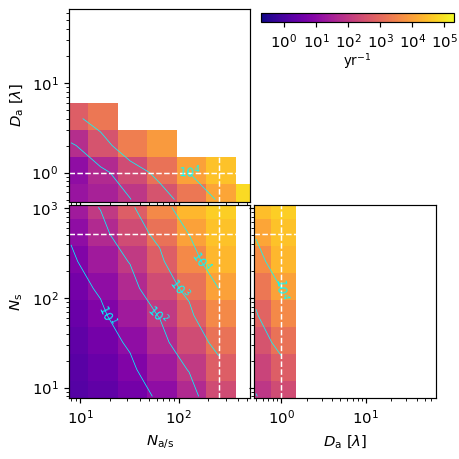

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_beamforming_eventrate_analysis_IC-VLBA-low.pdf


In [1149]:
nrows = len(axes_to_plot_eventrate_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.95, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_eventrate_stationwise_beamforming:
    yax, xax = slices_eventrate_stationwise_beamforming[(r,c)]['axkey']
    imgvals = NP.copy(slices_eventrate_stationwise_beamforming[(r,c)]['array']).to('yr-1').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('yr-1'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label(r'yr$^{-1}$', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_beamforming_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_beamforming_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Station-level EPIC

<IPython.core.display.Javascript object>


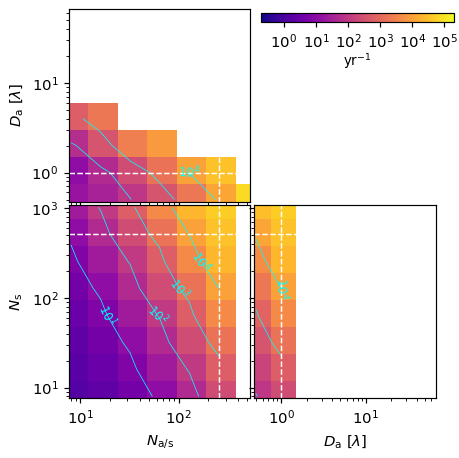

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_epic_eventrate_analysis_IC-VLBA-low.pdf


In [1150]:
nrows = len(axes_to_plot_eventrate_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.95, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_eventrate_stationwise_epic:
    yax, xax = slices_eventrate_stationwise_epic[(r,c)]['axkey']
    imgvals = NP.copy(slices_eventrate_stationwise_epic[(r,c)]['array']).to('yr-1').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('yr-1'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label(r'yr$^{-1}$', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_epic_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_epic_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Station-level correlations

<IPython.core.display.Javascript object>


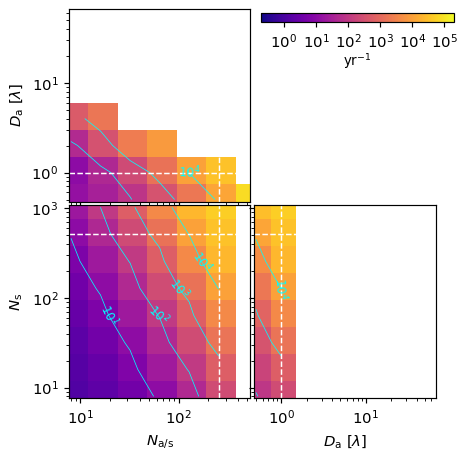

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_xcor_eventrate_analysis_IC-VLBA-low.pdf


In [1151]:
nrows = len(axes_to_plot_eventrate_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.95, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_eventrate_stationwise_xcor:
    yax, xax = slices_eventrate_stationwise_xcor[(r,c)]['axkey']
    imgvals = NP.copy(slices_eventrate_stationwise_xcor[(r,c)]['array']).to('yr-1').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('yr-1'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label(r'yr$^{-1}$', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_eventrate_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

## Calculate computational effort per event

In [1152]:
epe_stationwise_beamforming_per_beam = flops_beamform_Stokes_intensities_per_beam / rate_stationwise_beamforming_sta_fov
epe_stationwise_beamforming = flops_beamform_Stokes_intensities / rate_stationwise_beamforming_ant_fov
epe_stationwise_epic = flops_epic_Stokes_intensities / rate_stationwise_epic_ant_fov
epe_stationwise_xcor = flops_vis_fft_Stokes_imaging_all_stations / rate_stationwise_xcor_ant_fov
# epe_fullcorr = flops_vis_fft_Stokes_imaging_stationwise_all_stations / rate_fullcorr_ant_fov

In [1153]:
print(epe_stationwise_beamforming_per_beam.shape)
# print(rate_stationwise_beamforming_ant_fov / rate_stationwise_epic_ant_fov)
print(NP.nanmax(flops_beamform_Stokes_intensities / flops_epic_Stokes_intensities))
print(NP.nanmin(flops_beamform_Stokes_intensities / flops_epic_Stokes_intensities))

(2, 19, 8, 10, 8, 7)
19.589728338618578
0.015458988240760477


In [1154]:
print(flops_beamform_Stokes_intensities.shape)
print(rate_stationwise_beamforming_sta_fov.shape)
print(flops_epic_Stokes_intensities.shape)
print(rate_stationwise_epic_ant_fov.shape)
print(epe_stationwise_beamforming.to('pflo').shape)
print(epe_stationwise_epic.to('pflo').shape)
print(NP.nanmin(epe_stationwise_beamforming.to('pflo')/epe_stationwise_epic.to('pflo')))
print(NP.nanmax(epe_stationwise_beamforming.to('pflo')/epe_stationwise_epic.to('pflo')))
print(NP.nanmin(epe_stationwise_xcor.to('pflo')/epe_stationwise_epic.to('pflo')))
print(NP.nanmax(epe_stationwise_xcor.to('pflo')/epe_stationwise_epic.to('pflo')))
# print(flops_beamform_Stokes_intensities.to(flo/U.s))

(2, 19, 8, 10, 8, 7)
(2, 19, 8, 10, 8, 7)
(2, 19, 8, 10, 8, 7)
(2, 19, 8, 10, 8, 7)
(2, 19, 8, 10, 8, 7)
(2, 19, 8, 10, 8, 7)
0.015458988240760477
19.589728338618578
0.024371917047389634
6.512020815495142


### Plot coherent-incoherent computational cost per event

In [1155]:
slices_epe_stationwise_beamforming = multidim_corner_plot_info(epe_stationwise_beamforming, axes=axes_to_plot_epe_incoherent, nominal_inds=arr_nominal_inds)
slices_epe_stationwise_epic = multidim_corner_plot_info(epe_stationwise_epic, axes=axes_to_plot_epe_incoherent, nominal_inds=arr_nominal_inds)
slices_epe_stationwise_xcor = multidim_corner_plot_info(epe_stationwise_xcor, axes=axes_to_plot_epe_incoherent, nominal_inds=arr_nominal_inds)

In [1156]:
print(NP.nanmin(epe_stationwise_beamforming.to('pflo')), NP.nanmax(epe_stationwise_beamforming.to('pflo')))
print(NP.nanmin(epe_stationwise_epic.to('pflo')), NP.nanmax(epe_stationwise_epic.to('pflo')))
print(NP.nanmin(epe_stationwise_xcor.to('pflo')), NP.nanmax(epe_stationwise_xcor.to('pflo')))

0.06864997414775266 pflo 34285260.26875157 pflo
0.30099104948525573 pflo 175114225.00760385 pflo
0.034104442596916404 pflo 9465388.30556705 pflo


### Stationwise beamforming

In [1157]:
print(axes_to_plot_epe_incoherent)

[2 3 4 5]


<IPython.core.display.Javascript object>


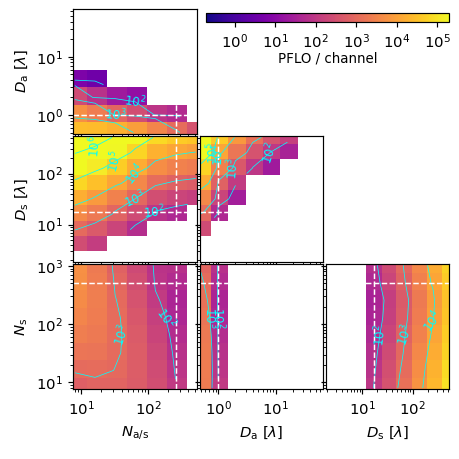

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_beamforming_epe_analysis_IC-VLBA-low.pdf


In [1158]:
nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.16, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_beamforming:
    yax, xax = slices_epe_stationwise_beamforming[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_beamforming[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('pflo'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.45, 0.95, 0.53, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_beamforming_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_beamforming_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Stationwise EPIC

<IPython.core.display.Javascript object>


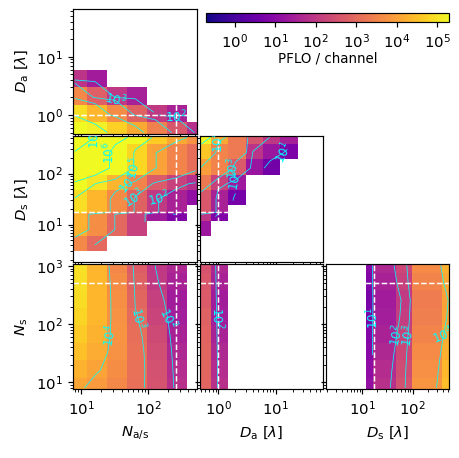

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_epic_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


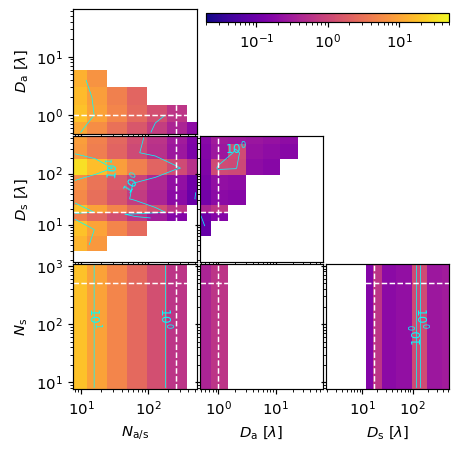

/tmp/ipykernel_611350/2926586316.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_epic_relative_epe_analysis_IC-VLBA-low.pdf


In [1159]:
nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.16, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_epic:
    yax, xax = slices_epe_stationwise_epic[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_epic[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('pflo'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.45, 0.95, 0.53, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_epic_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_epic_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

#########################################

nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.16, right=0.98, bottom=0.15, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_epic:
    yax, xax = slices_epe_stationwise_epic[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_epic[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_stationwise_beamforming[(r,c)]['array']).to('pflo').squeeze()
    ratio = (imgvals / imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=0.02, vmax=50), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.45, 0.95, 0.53, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_epic_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_epic_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Stationwise XCorr

<IPython.core.display.Javascript object>


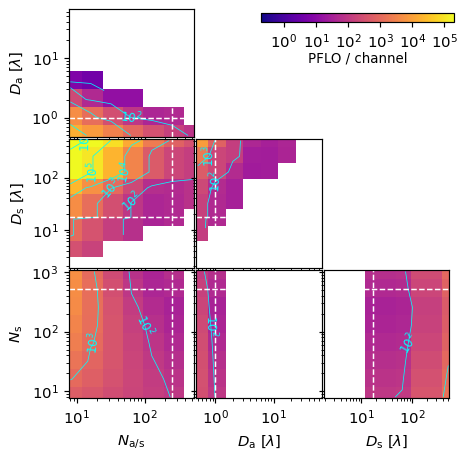

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_xcor_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


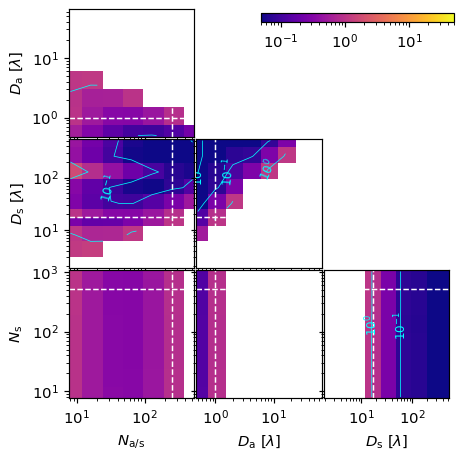

/tmp/ipykernel_611350/3141343202.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_xcor_relative_epe_analysis_IC-VLBA-low.pdf


In [1160]:
nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_xcor:
    yax, xax = slices_epe_stationwise_xcor[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_xcor[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals.to('pflo'), norm=PLTC.LogNorm(vmin=0.2, vmax=2e5), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

#########################################

nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_xcor:
    yax, xax = slices_epe_stationwise_xcor[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_xcor[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_stationwise_beamforming[(r,c)]['array']).to('pflo').squeeze()
    ratio = (imgvals / imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=0.05, vmax=50), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_xcor_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_xcor_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

<IPython.core.display.Javascript object>


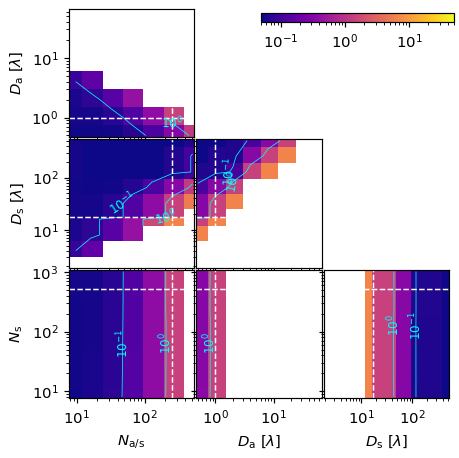

In [1161]:
#########################################

nrows = len(axes_to_plot_epe_incoherent)-1
ncols = nrows
fig = PLT.figure(figsize=(4,4))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.98, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_stationwise_xcor:
    yax, xax = slices_epe_stationwise_xcor[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_stationwise_xcor[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_stationwise_epic[(r,c)]['array']).to('pflo').squeeze()
    ratio = (imgvals / imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], ratio, norm=PLTC.LogNorm(vmin=0.05, vmax=50), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(ratio).value*NP.nanmax(ratio).value)]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], ratio.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.57, 0.95, 0.42, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

# PLT.savefig(figdir+'multidim_epic_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
# print('Saved at: '+figdir+'multidim_epic_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Coherent combination (coherent both at intra-station and inter-station levels)

In [1163]:
print(per_station_per_pol_Aeff_over_Tsys_masked.shape)

(2, 19, 8, 10, 8, 7)


In [1164]:
visrms_1BF_2BF = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)**2, efficiency=1.0)
visrms_1BF_2EPIC = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)**2, efficiency=1.0)
visrms_1BF_2XBF = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)*(nstations.reshape(1,1,-1,1,1,1)-1), efficiency=1.0)
visrms_1BF_2XFFT = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)*(nstations.reshape(1,1,-1,1,1,1)-1), efficiency=1.0)
visrms_1EPIC_2BF = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)**2, efficiency=1.0)
visrms_1EPIC_2EPIC = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)**2, efficiency=1.0)
visrms_1EPIC_2XBF = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)*(nstations.reshape(1,1,-1,1,1,1)-1), efficiency=1.0)
visrms_1EPIC_2XFFT = vis_noise_from_sensitivity(per_station_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*nstations.reshape(1,1,-1,1,1,1)*(nstations.reshape(1,1,-1,1,1,1)-1), efficiency=1.0)
visrms_fullcorr = vis_noise_from_sensitivity(per_element_per_pol_Aeff_over_Tsys_masked, df, tacc, npol=npol.reshape(-1,1,1,1,1,1), n_meas=0.5*(nstations.reshape(1,1,-1,1,1,1)*nants_in_station.reshape(1,1,1,1,1,-1))*(nstations.reshape(1,1,-1,1,1,1)*nants_in_station.reshape(1,1,1,1,1,-1)-1), efficiency=1.0)

bolo_visrms_1BF_2BF = visrms_1BF_2BF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1BF_2EPIC = visrms_1BF_2EPIC * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1BF_2XBF = visrms_1BF_2XBF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1BF_2XFFT = visrms_1BF_2XFFT * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1EPIC_2BF = visrms_1EPIC_2BF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1EPIC_2EPIC = visrms_1EPIC_2EPIC * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1EPIC_2XBF = visrms_1EPIC_2XBF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_1EPIC_2XFFT = visrms_1EPIC_2XFFT * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_visrms_fullcorr = visrms_fullcorr * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df

fluence_rms_1BF_2BF = visrms_1BF_2BF * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1BF_2EPIC = visrms_1BF_2EPIC * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1BF_2XBF = visrms_1BF_2XBF * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1BF_2XFFT = visrms_1BF_2XFFT * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1EPIC_2BF = visrms_1EPIC_2BF * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1EPIC_2EPIC = visrms_1EPIC_2EPIC * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1EPIC_2XBF = visrms_1EPIC_2XBF * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_1EPIC_2XFFT = visrms_1EPIC_2XFFT * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc
fluence_rms_fullcorr = visrms_fullcorr * NP.sqrt(twidth_pulse*tacc) # NP.sqrt(twidth_pulse*tacc) = NP.sqrt(Nacc_in_pulse) * tacc

bolo_fluence_rms_1BF_2BF = fluence_rms_1BF_2BF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1BF_2EPIC = fluence_rms_1BF_2EPIC * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1BF_2XBF = fluence_rms_1BF_2XBF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1BF_2XFFT = fluence_rms_1BF_2XFFT * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1EPIC_2BF = fluence_rms_1EPIC_2BF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1EPIC_2EPIC = fluence_rms_1EPIC_2EPIC * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1EPIC_2XBF = fluence_rms_1EPIC_2XBF * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_1EPIC_2XFFT = fluence_rms_1EPIC_2XFFT * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df
bolo_fluence_rms_fullcorr = fluence_rms_fullcorr * NP.sqrt(bw_pulse*df) # NP.sqrt(bw_pulse*df) = NP.sqrt(Nchan) * df

In [1165]:
zmin_1BF_2BF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1BF_2BF), zmax=5000)[0]
zmax_1BF_2BF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1BF_2BF), zmax=5000)[0]
print(zmin_1BF_2BF, zmax_1BF_2BF)
zgrid_1BF_2BF = NP.linspace(zmin_1BF_2BF, zmax_1BF_2BF, num=100)
area_grid_1BF_2BF = surface_area_modulus_function(zgrid_1BF_2BF)
area_vals_1BF_2BF = lum_pulse_typical / bolo_visrms_1BF_2BF
zvals_1BF_2BF = NP.interp(area_vals_1BF_2BF.to('Mpc2').value.astype(float), area_grid_1BF_2BF.to('Mpc2').value.astype(float), zgrid_1BF_2BF.astype(float))

0.015159950893366811 572.284645267092


In [1166]:
zmin_1BF_2EPIC = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1BF_2EPIC), zmax=5000)[0]
zmax_1BF_2EPIC = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1BF_2EPIC), zmax=5000)[0]
zgrid_1BF_2EPIC = NP.linspace(zmin_1BF_2EPIC, zmax_1BF_2EPIC, num=100)
area_grid_1BF_2EPIC = surface_area_modulus_function(zgrid_1BF_2EPIC)
area_vals_1BF_2EPIC = lum_pulse_typical / bolo_visrms_1BF_2EPIC
zvals_1BF_2EPIC = NP.interp(area_vals_1BF_2EPIC.to('Mpc2').value.astype(float), area_grid_1BF_2EPIC.to('Mpc2').value.astype(float), zgrid_1BF_2EPIC.astype(float))
print(zmin_1BF_2EPIC, zmax_1BF_2EPIC)
print(zvals_1BF_2EPIC.shape)

0.015159950893366811 572.284645267092
(2, 19, 8, 10, 8, 7)


In [1167]:
zmin_1BF_2XBF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1BF_2XBF), zmax=5000)[0]
zmax_1BF_2XBF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1BF_2XBF), zmax=5000)[0]
zgrid_1BF_2XBF = NP.linspace(zmin_1BF_2XBF, zmax_1BF_2XBF, num=100)
area_grid_1BF_2XBF = surface_area_modulus_function(zgrid_1BF_2XBF)
area_vals_1BF_2XBF = lum_pulse_typical / bolo_visrms_1BF_2XBF
zvals_1BF_2XBF = NP.interp(area_vals_1BF_2XBF.to('Mpc2').value.astype(float), area_grid_1BF_2XBF.to('Mpc2').value.astype(float), zgrid_1BF_2XBF.astype(float))
print(zmin_1BF_2XBF, zmax_1BF_2XBF)
print(zvals_1BF_2XBF.shape)

0.014664091730711228 572.0166613003729
(2, 19, 8, 10, 8, 7)


In [1168]:
zmin_1BF_2XFFT = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1BF_2XFFT), zmax=5000)[0]
zmax_1BF_2XFFT = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1BF_2XFFT), zmax=5000)[0]
zgrid_1BF_2XFFT = NP.linspace(zmin_1BF_2XFFT, zmax_1BF_2XFFT, num=100)
area_grid_1BF_2XFFT = surface_area_modulus_function(zgrid_1BF_2XFFT)
area_vals_1BF_2XFFT = lum_pulse_typical / bolo_visrms_1BF_2XFFT
zvals_1BF_2XFFT = NP.interp(area_vals_1BF_2XFFT.to('Mpc2').value.astype(float), area_grid_1BF_2XFFT.to('Mpc2').value.astype(float), zgrid_1BF_2XFFT.astype(float))
print(zmin_1BF_2XFFT, zmax_1BF_2XFFT)
print(zvals_1BF_2XFFT.shape)

0.014664091730711228 572.0166613003729
(2, 19, 8, 10, 8, 7)


In [1169]:
zmin_1EPIC_2BF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1EPIC_2BF), zmax=5000)[0]
zmax_1EPIC_2BF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1EPIC_2BF), zmax=5000)[0]
zgrid_1EPIC_2BF = NP.linspace(zmin_1EPIC_2BF, zmax_1EPIC_2BF, num=100)
area_grid_1EPIC_2BF = surface_area_modulus_function(zgrid_1EPIC_2BF)
area_vals_1EPIC_2BF = lum_pulse_typical / bolo_visrms_1EPIC_2BF
zvals_1EPIC_2BF = NP.interp(area_vals_1EPIC_2BF.to('Mpc2').value.astype(float), area_grid_1EPIC_2BF.to('Mpc2').value.astype(float), zgrid_1EPIC_2BF.astype(float))
print(zmin_1EPIC_2BF, zmax_1EPIC_2BF)
print(zvals_1EPIC_2BF.shape)

0.015159950893366811 572.284645267092
(2, 19, 8, 10, 8, 7)


In [1170]:
zmin_1EPIC_2EPIC = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1EPIC_2EPIC), zmax=5000)[0]
zmax_1EPIC_2EPIC = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1EPIC_2EPIC), zmax=5000)[0]
zgrid_1EPIC_2EPIC = NP.linspace(zmin_1EPIC_2EPIC, zmax_1EPIC_2EPIC, num=100)
area_grid_1EPIC_2EPIC = surface_area_modulus_function(zgrid_1EPIC_2EPIC)
area_vals_1EPIC_2EPIC = lum_pulse_typical / bolo_visrms_1EPIC_2EPIC
zvals_1EPIC_2EPIC = NP.interp(area_vals_1EPIC_2EPIC.to('Mpc2').value.astype(float), area_grid_1EPIC_2EPIC.to('Mpc2').value.astype(float), zgrid_1EPIC_2EPIC.astype(float))
print(zvals_1EPIC_2EPIC.shape)

(2, 19, 8, 10, 8, 7)


In [1171]:
zmin_1EPIC_2XBF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1EPIC_2XBF), zmax=5000)[0]
zmax_1EPIC_2XBF = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1EPIC_2XBF), zmax=5000)[0]
zgrid_1EPIC_2XBF = NP.linspace(zmin_1EPIC_2XBF, zmax_1EPIC_2XBF, num=100)
area_grid_1EPIC_2XBF = surface_area_modulus_function(zgrid_1EPIC_2XBF)
area_vals_1EPIC_2XBF = lum_pulse_typical / bolo_visrms_1EPIC_2XBF
zvals_1EPIC_2XBF = NP.interp(area_vals_1EPIC_2XBF.to('Mpc2').value.astype(float), area_grid_1EPIC_2XBF.to('Mpc2').value.astype(float), zgrid_1EPIC_2XBF.astype(float))
print(zvals_1EPIC_2XBF.shape)

(2, 19, 8, 10, 8, 7)


In [1172]:
zmin_1EPIC_2XFFT = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_1EPIC_2XFFT), zmax=5000)[0]
zmax_1EPIC_2XFFT = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_1EPIC_2XFFT), zmax=5000)[0]
zgrid_1EPIC_2XFFT = NP.linspace(zmin_1EPIC_2XFFT, zmax_1EPIC_2XFFT, num=100)
area_grid_1EPIC_2XFFT = surface_area_modulus_function(zgrid_1EPIC_2XFFT)
area_vals_1EPIC_2XFFT = lum_pulse_typical / bolo_visrms_1EPIC_2XFFT
zvals_1EPIC_2XFFT = NP.interp(area_vals_1EPIC_2XFFT.to('Mpc2').value.astype(float), area_grid_1EPIC_2XFFT.to('Mpc2').value.astype(float), zgrid_1EPIC_2XFFT.astype(float))
print(zvals_1EPIC_2XFFT.shape)

(2, 19, 8, 10, 8, 7)


In [1173]:
zmin_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmin(lum_pulse_typical / bolo_visrms_fullcorr), zmax=5000)[0]
zmax_fullcorr = Cosmo.z_at_value(surface_area_modulus_function, NP.nanmax(lum_pulse_typical / bolo_visrms_fullcorr), zmax=5000)[0]
zgrid_fullcorr = NP.linspace(zmin_fullcorr, zmax_fullcorr, num=100)
area_grid_fullcorr = surface_area_modulus_function(zgrid_fullcorr)
area_vals_fullcorr = lum_pulse_typical / bolo_visrms_fullcorr
zvals_fullcorr = NP.interp(area_vals_fullcorr.to('Mpc2').value.astype(float), area_grid_fullcorr.to('Mpc2').value.astype(float), zgrid_fullcorr.astype(float))
print(zvals_fullcorr.shape)

(2, 19, 8, 10, 8, 7)


## Calculate event rates

In [1174]:
# vol_cmv_1BF_2BF = cosmoparm.comoving_volume(zvals_1BF_2BF) * mask_pol_arr_sta_ant
# vol_cmv_1BF_2EPIC = cosmoparm.comoving_volume(zvals_1BF_2EPIC) * mask_pol_arr_sta_ant
# vol_cmv_1BF_2XBF = cosmoparm.comoving_volume(zvals_1BF_2XBF) * mask_pol_arr_sta_ant
# vol_cmv_1BF_2XFFT = cosmoparm.comoving_volume(zvals_1BF_2XFFT) * mask_pol_arr_sta_ant
# vol_cmv_1EPIC_2BF = cosmoparm.comoving_volume(zvals_1EPIC_2BF) * mask_pol_arr_sta_ant
# vol_cmv_1EPIC_2EPIC = cosmoparm.comoving_volume(zvals_1EPIC_2EPIC) * mask_pol_arr_sta_ant
# vol_cmv_1EPIC_2XBF = cosmoparm.comoving_volume(zvals_1EPIC_2XBF) * mask_pol_arr_sta_ant
# vol_cmv_1EPIC_2XFFT = cosmoparm.comoving_volume(zvals_1EPIC_2XFFT) * mask_pol_arr_sta_ant
# vol_cmv_fullcorr = cosmoparm.comoving_volume(zvals_fullcorr) * mask_pol_arr_sta_ant 

In [1176]:
# rate_1BF_2BF_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2BF
# rate_1BF_2EPIC_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2EPIC
# rate_1BF_2XBF_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2XBF
# rate_1BF_2XFFT_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2XFFT
# rate_1EPIC_2BF_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2BF
# rate_1EPIC_2EPIC_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2EPIC
# rate_1EPIC_2XBF_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2XBF
# rate_1EPIC_2XFFT_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2XFFT
# rate_fullcorr_ant_fov = ant_fov_sa.reshape(1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_fullcorr

In [ ]:
vol_cmv_1BF_2BF = uniform_redshift_weighted_comoving_volume(zvals_1BF_2BF, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1BF_2EPIC = uniform_redshift_weighted_comoving_volume(zvals_1BF_2EPIC, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1BF_2XBF = uniform_redshift_weighted_comoving_volume(zvals_1BF_2XBF, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1BF_2XFFT = uniform_redshift_weighted_comoving_volume(zvals_1BF_2XFFT, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1EPIC_2BF = uniform_redshift_weighted_comoving_volume(zvals_1EPIC_2BF, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1EPIC_2EPIC = uniform_redshift_weighted_comoving_volume(zvals_1EPIC_2EPIC, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1EPIC_2XBF = uniform_redshift_weighted_comoving_volume(zvals_1EPIC_2XBF, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_1EPIC_2XFFT = uniform_redshift_weighted_comoving_volume(zvals_1EPIC_2XFFT, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant
vol_cmv_fullcorr = uniform_redshift_weighted_comoving_volume(zvals_fullcorr, zcut, zmin=0.0, cosmo=cosmoparm) * mask_pol_arr_sta_ant

In [1175]:
print(vol_cmv_1BF_2BF)

[[[[[[1.25607756e+06 1.26991722e+06            nan ...            nan
                 nan            nan]
     [           nan            nan            nan ...            nan
                 nan            nan]
     [           nan            nan            nan ...            nan
                 nan            nan]
     ...
     [           nan            nan            nan ...            nan
                 nan            nan]
     [           nan            nan            nan ...            nan
                 nan            nan]
     [           nan            nan            nan ...            nan
                 nan            nan]]

    [[1.25607756e+06 1.26991722e+06 1.29789965e+06 ...            nan
                 nan            nan]
     [1.29789965e+06 1.35508707e+06            nan ...            nan
                 nan            nan]
     [           nan            nan            nan ...            nan
                 nan            nan]
     ...
     [           

In [ ]:
rate_1BF_2BF_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2BF
rate_1BF_2EPIC_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2EPIC
rate_1BF_2XBF_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2XBF
rate_1BF_2XFFT_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1BF_2XFFT
rate_1EPIC_2BF_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2BF
rate_1EPIC_2EPIC_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2EPIC
rate_1EPIC_2XBF_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2XBF
rate_1EPIC_2XFFT_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_1EPIC_2XFFT
rate_fullcorr_ant_fov = ant_fov_sa.reshape(1,1,1,1,1,-1,1)/(4*NP.pi*U.sr) * rate_Luo2020 * vol_cmv_fullcorr

In [1177]:
print(NP.nanmin(rate_1BF_2BF_ant_fov.to('yr-1')), NP.nanmax(rate_1BF_2BF_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1BF_2EPIC_ant_fov.to('yr-1')), NP.nanmax(rate_1BF_2EPIC_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1BF_2XBF_ant_fov.to('yr-1')), NP.nanmax(rate_1BF_2XBF_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1BF_2XFFT_ant_fov.to('yr-1')), NP.nanmax(rate_1BF_2XFFT_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1EPIC_2BF_ant_fov.to('yr-1')), NP.nanmax(rate_1EPIC_2BF_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1EPIC_2EPIC_ant_fov.to('yr-1')), NP.nanmax(rate_1EPIC_2EPIC_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1EPIC_2XBF_ant_fov.to('yr-1')), NP.nanmax(rate_1EPIC_2XBF_ant_fov.to('yr-1')))
print(NP.nanmin(rate_1EPIC_2XFFT_ant_fov.to('yr-1')), NP.nanmax(rate_1EPIC_2XFFT_ant_fov.to('yr-1')))

0.4976277895081237 1 / yr 3550890.374745492 1 / yr
0.4976277895081237 1 / yr 3550890.374745492 1 / yr
0.4298282175944842 1 / yr 3549170.8705555857 1 / yr
0.4298282175944842 1 / yr 3549170.8705555857 1 / yr
0.4976277895081237 1 / yr 3550890.374745492 1 / yr
0.4976277895081237 1 / yr 3550890.374745492 1 / yr
0.4298282175944842 1 / yr 3549170.8705555857 1 / yr
0.4298282175944842 1 / yr 3549170.8705555857 1 / yr


## Calculate computational effort per event

In [1178]:
epe_1BF_2BF = flops_1BF_2BF / rate_1BF_2BF_ant_fov
epe_1BF_2EPIC = flops_1BF_2EPIC / rate_1BF_2EPIC_ant_fov
epe_1BF_2XBF = flops_1BF_2XBF / rate_1BF_2XBF_ant_fov
epe_1BF_2XFFT = flops_1BF_2XFFT / rate_1BF_2XFFT_ant_fov
epe_1EPIC_2BF = flops_1EPIC_2BF / rate_1EPIC_2BF_ant_fov
epe_1EPIC_2EPIC = flops_1EPIC_2EPIC / rate_1EPIC_2EPIC_ant_fov
epe_1EPIC_2XBF = flops_1EPIC_2XBF / rate_1EPIC_2XBF_ant_fov
epe_1EPIC_2XFFT = flops_1EPIC_2XFFT / rate_1EPIC_2XFFT_ant_fov
# epe_fullcorr = flops_vis_fft_Stokes_imaging_stationwise_all_stations / rate_fullcorr_ant_fov[:,NP.newaxis,NP.newaxis,NP.newaxis,NP.newaxis,:,:]

## Plot effort-per-event for coherent-coherent combinations

In [1179]:
# 5-dim: shape=(array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 6-dim: shape=(npol.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)
# 7-dim: shape=(npol.size, nbeams.size, array_dia.size, nstations.size, station_dia.size, ant_area.size, nants_in_station.size)

axs_labels = [r'$n_\mathrm{p}$', r'$D_\mathrm{A}\,\, [\lambda]$', r'$N_\mathrm{s}$', r'$D_\mathrm{s}\,\, [\lambda]$', r'$D_\mathrm{e}\,\, [\lambda]$', r'$N_\mathrm{eps}$']
axs_scales = ['linear', 'log', 'log', 'log', 'log', 'log']
axs_vals = [npol, array_dia, nstations, station_dia, ant_dia, nants_in_station]

axes_to_plot = NP.array([1,2,3,4,5])

In [1180]:
slices_epe_1BF_2BF = multidim_corner_plot_info(epe_1BF_2BF, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1BF_2EPIC = multidim_corner_plot_info(epe_1BF_2EPIC, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1BF_2XBF = multidim_corner_plot_info(epe_1BF_2XBF, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1BF_2XFFT = multidim_corner_plot_info(epe_1BF_2XFFT, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1EPIC_2BF = multidim_corner_plot_info(epe_1EPIC_2BF, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1EPIC_2EPIC = multidim_corner_plot_info(epe_1EPIC_2EPIC, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1EPIC_2XBF = multidim_corner_plot_info(epe_1EPIC_2XBF, axes=axes_to_plot, nominal_inds=arr_nominal_inds)
slices_epe_1EPIC_2XFFT = multidim_corner_plot_info(epe_1EPIC_2XFFT, axes=axes_to_plot, nominal_inds=arr_nominal_inds)

### Intra-station BF + Inter-station BF

<IPython.core.display.Javascript object>


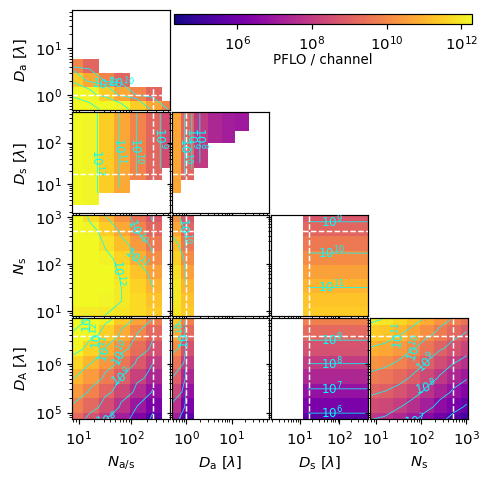

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2BF_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


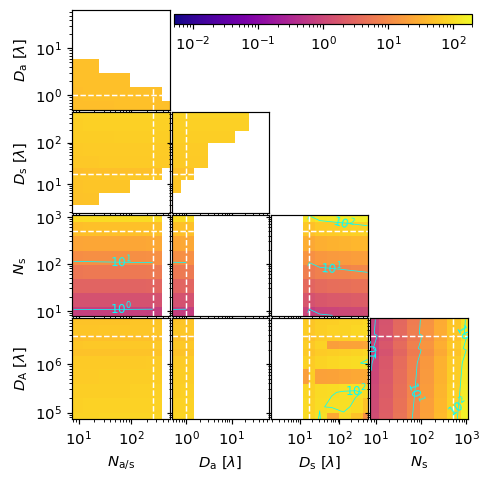

/tmp/ipykernel_611350/1815246876.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2BF_relative_epe_analysis_IC-VLBA-low.pdf


In [1181]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2BF:
    yax, xax = slices_epe_1BF_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2BF[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2BF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2BF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2BF:
    yax, xax = slices_epe_1BF_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2BF[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2BF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2BF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station BF + Inter-station EPIC

<IPython.core.display.Javascript object>


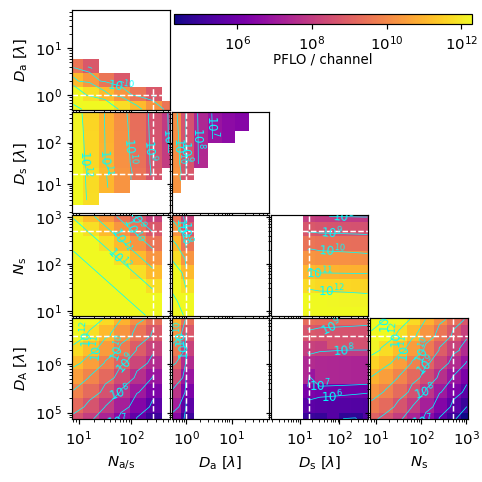

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2EPIC_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


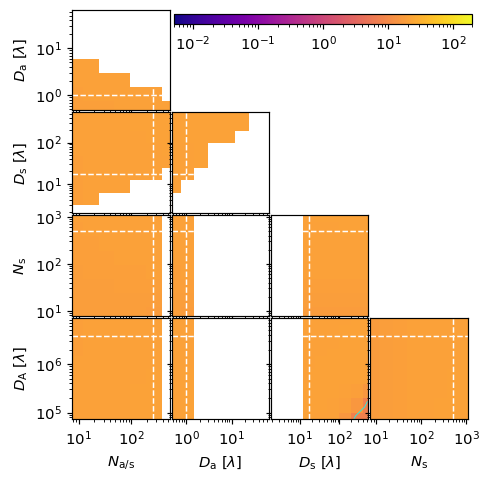

/tmp/ipykernel_611350/4079118034.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2EPIC_relative_epe_analysis_IC-VLBA-low.pdf


In [1182]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2EPIC:
    yax, xax = slices_epe_1BF_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2EPIC[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2EPIC_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2EPIC_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2EPIC:
    yax, xax = slices_epe_1BF_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2EPIC[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2EPIC_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2EPIC_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station BF + Inter-station XBF

<IPython.core.display.Javascript object>


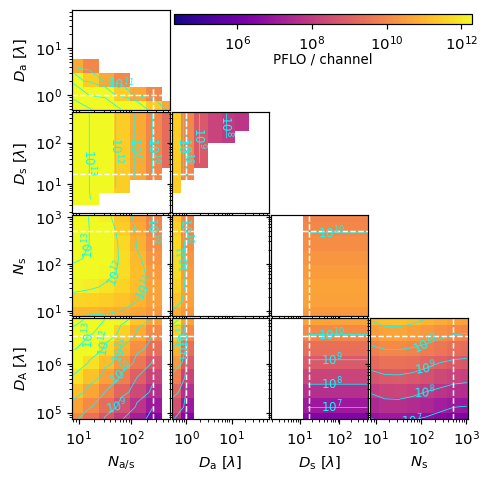

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2XBF_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


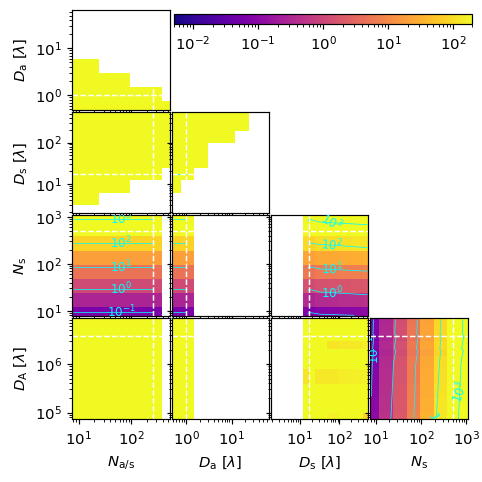

/tmp/ipykernel_611350/4063919840.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2XBF_relative_epe_analysis_IC-VLBA-low.pdf


In [1183]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2XBF:
    yax, xax = slices_epe_1BF_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2XBF[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XBF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2XBF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2XBF:
    yax, xax = slices_epe_1BF_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2XBF[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XBF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2XBF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station BF + Inter-station XFFT

<IPython.core.display.Javascript object>


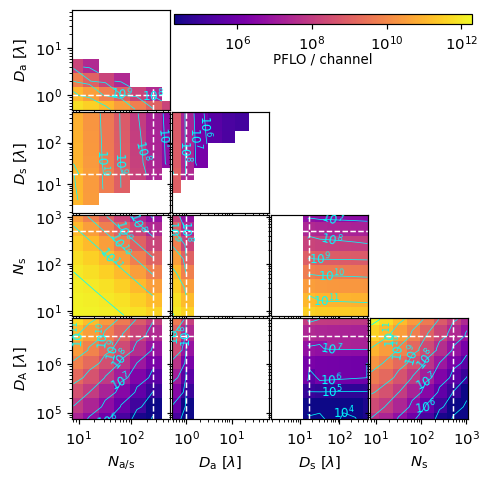

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2XFFT_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


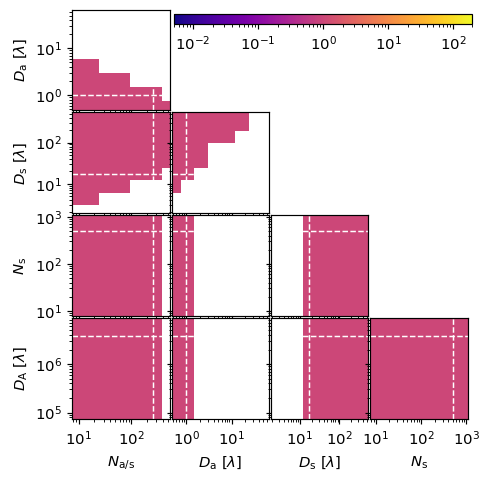

/tmp/ipykernel_611350/1475610779.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1BF_2XFFT_relative_epe_analysis_IC-VLBA-low.pdf


In [1184]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2XFFT:
    yax, xax = slices_epe_1BF_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XFFT_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2XFFT_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1BF_2XFFT:
    yax, xax = slices_epe_1BF_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1BF_2XFFT_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1BF_2XFFT_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station EPIC + Inter-station BF

<IPython.core.display.Javascript object>


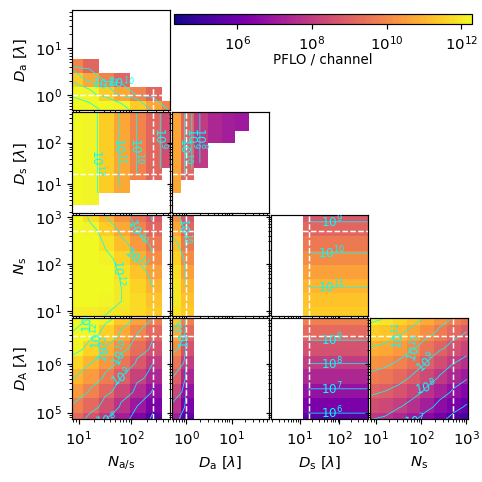

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2BF_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


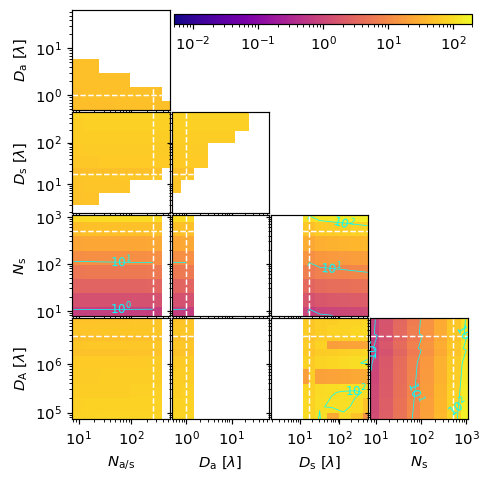

/tmp/ipykernel_611350/3712621905.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2BF_relative_epe_analysis_IC-VLBA-low.pdf


In [1185]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2BF:
    yax, xax = slices_epe_1EPIC_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2BF[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2BF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2BF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2BF:
    yax, xax = slices_epe_1EPIC_2BF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2BF[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2BF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2BF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station EPIC + Inter-station EPIC

<IPython.core.display.Javascript object>


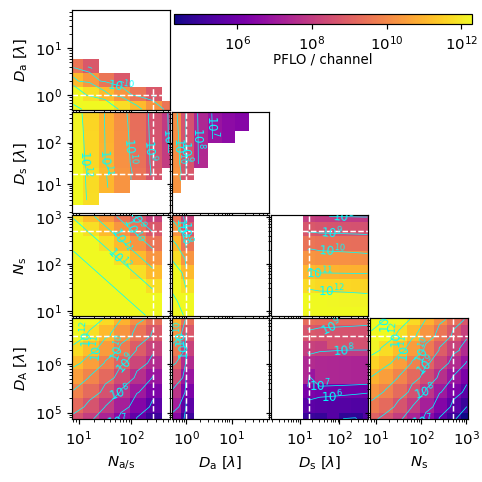

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2EPIC_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


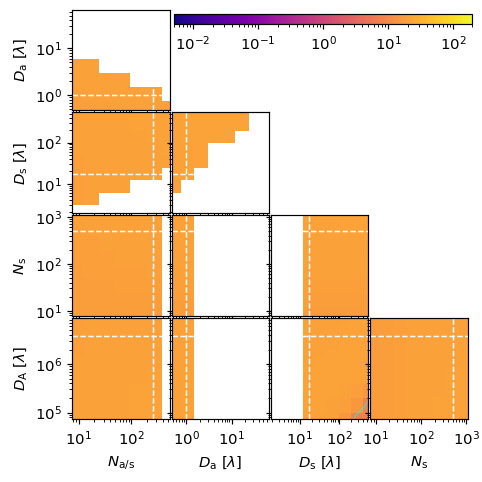

/tmp/ipykernel_611350/1888561981.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2EPIC_relative_epe_analysis_IC-VLBA-low.pdf


In [1186]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2EPIC:
    yax, xax = slices_epe_1EPIC_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2EPIC[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2EPIC_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2EPIC:
    yax, xax = slices_epe_1EPIC_2EPIC[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2EPIC[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2EPIC_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2EPIC_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station EPIC + Inter-station XBF

<IPython.core.display.Javascript object>


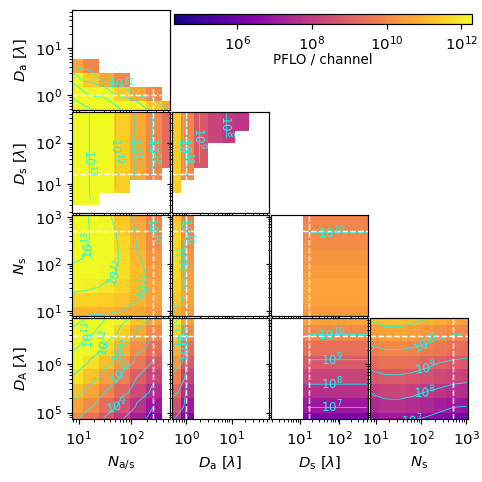

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2XBF_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


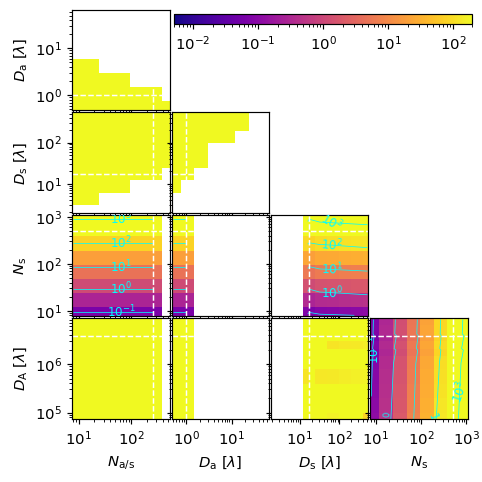

/tmp/ipykernel_611350/1998879684.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2XBF_relative_epe_analysis_IC-VLBA-low.pdf


In [1187]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2XBF:
    yax, xax = slices_epe_1EPIC_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2XBF[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XBF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2XBF_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2XBF:
    yax, xax = slices_epe_1EPIC_2XBF[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2XBF[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XBF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2XBF_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

### Intra-station EPIC + Inter-station XFFT

<IPython.core.display.Javascript object>


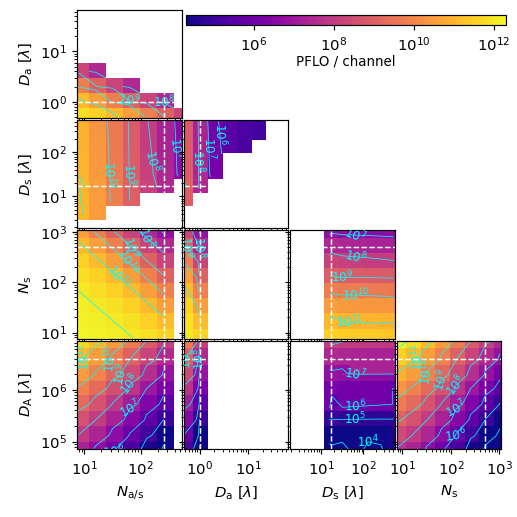

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2XFFT_epe_analysis_IC-VLBA-low.pdf


<IPython.core.display.Javascript object>


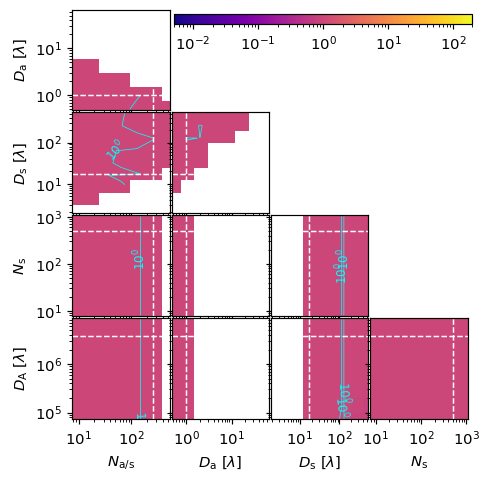

/tmp/ipykernel_611350/306656640.py:87: UserWarning: No contour levels were found within the data range.
  compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')


Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/multidim_1EPIC_2XFFT_relative_epe_analysis_IC-VLBA-low.pdf


In [1188]:
nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2XFFT:
    yax, xax = slices_epe_1EPIC_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    log10_min_imgvals = NP.floor(NP.log10(NP.nanmin(imgvals).value))
    log10_max_imgvals = NP.ceil(NP.log10(NP.nanmax(imgvals).value))
    nlevs = int(log10_max_imgvals - log10_min_imgvals) + 1
    clevels = NP.logspace(log10_min_imgvals,log10_max_imgvals,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals, norm=PLTC.LogNorm(vmin=2e4, vmax=2e12), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals).value*NP.nanmax(imgvals).value)]
        compcost_cntr = ax.contour(axs_vals[xax], axs_vals[yax], imgvals.value, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XFFT_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

###############################################

nrows = len(axes_to_plot)-1
ncols = nrows
fig = PLT.figure(figsize=(4.5,4.5))
gs = fig.add_gridspec(nrows, ncols, left=0.15, right=0.97, bottom=0.13, top=0.98, wspace=0.02, hspace=0.02)

for r,c in slices_epe_1EPIC_2XFFT:
    yax, xax = slices_epe_1EPIC_2XFFT[(r,c)]['axkey']
    imgvals = NP.copy(slices_epe_1EPIC_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ref = NP.copy(slices_epe_1BF_2XFFT[(r,c)]['array']).to('pflo').squeeze()
    imgvals_ratio = (imgvals/imgvals_ref).decompose().value
    log10_min_ratio = NP.floor(NP.log10(NP.nanmin(imgvals_ratio)))
    log10_max_ratio = NP.ceil(NP.log10(NP.nanmax(imgvals_ratio)))
    nlevs = int(log10_max_ratio - log10_min_ratio) + 1
    clevels = NP.logspace(log10_min_ratio,log10_max_ratio,nlevs,endpoint=True)

    ax = fig.add_subplot(gs[r,c])
    compcost_img_ratio = ax.pcolormesh(axs_vals[xax], axs_vals[yax], imgvals_ratio, norm=PLTC.LogNorm(vmin=5e-3, vmax=2e2), shading='nearest', cmap='plasma')
    ax.axvline(axs_vals[xax][arr_nominal_inds[xax]], color='white', lw=1, ls='--')
    ax.axhline(axs_vals[yax][arr_nominal_inds[yax]], color='white', lw=1, ls='--')

    try:
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    except Exception as err:
        print(repr(err))
        clevels = [NP.sqrt(NP.nanmin(imgvals_ratio)*NP.nanmax(imgvals_ratio))]
        compcost_cntr_ratio = ax.contour(axs_vals[xax], axs_vals[yax], imgvals_ratio, clevels, linewidths=0.5, colors='cyan')
    fmt.create_dummy_axis()
    ax.clabel(compcost_cntr_ratio, inline=False, fmt=fmt, fontsize=8)

    ax.set_xscale(axs_scales[xax])
    ax.set_yscale(axs_scales[yax])
    if r<nrows-1:
        ax.tick_params(axis='x', labelbottom=False)
    if c>0:
        ax.tick_params(axis='y', labelleft=False)
    ax.set_ylim(axs_min[yax], axs_max[yax])
    ax.set_xlim(axs_min[xax], axs_max[xax])
#     ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
#     ax.locator_params(axis='x', nbins=3)
    if c==0:
        ax.set_ylabel(axs_labels[yax])
    if r==nrows-1:
        ax.set_xlabel(axs_labels[xax])
#     ax.set_xticklabels(ax.get_xticks(), fontsize=9, rotation=60)
#     ax.set_yticklabels(ax.get_yticks(), fontsize=9, rotation=0)

for r in range(nrows):
    for c in range(ncols):
        if c>r:
            ax = fig.add_subplot(gs[r,c])
            ax.remove()

cbax = fig.add_axes([0.36, 0.95, 0.62, 0.02])
cbar = PLT.colorbar(compcost_img_ratio, cax=cbax, orientation='horizontal')
cbax.xaxis.set_ticks_position('bottom')
cbax_xticks = ticker.LogLocator(base=10.0, numticks=7)
cbax.xaxis.set_major_locator(cbax_xticks)
# cbax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.3g'))
# cbax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
# cbar.set_label('PFLO / channel', labelpad=0, x=0.5, fontsize=9)

PLT.savefig(figdir+'multidim_1EPIC_2XFFT_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']), bbox_inches=0)
print('Saved at: '+figdir+'multidim_1EPIC_2XFFT_relative_epe_analysis_{0}.pdf'.format(arrs[chosen_arr]['name']))

## 1D Effort per event for coherent-coherent imaging architectures

<IPython.core.display.Javascript object>


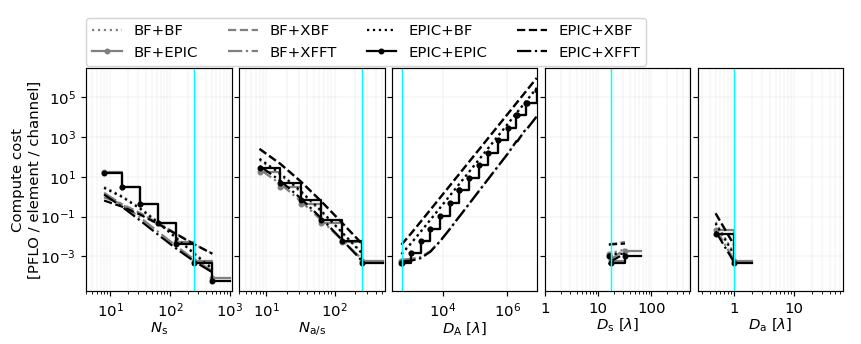

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_perelement_coherent_epe_analysis_SKA1-low-core.pdf


<IPython.core.display.Javascript object>


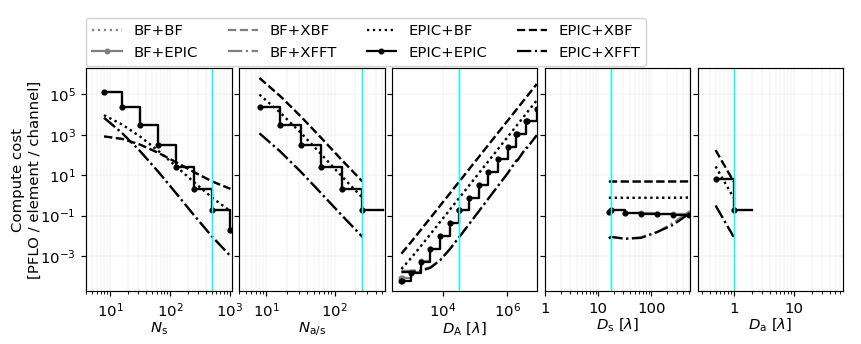

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_perelement_coherent_epe_analysis_SKA1-low.pdf


<IPython.core.display.Javascript object>


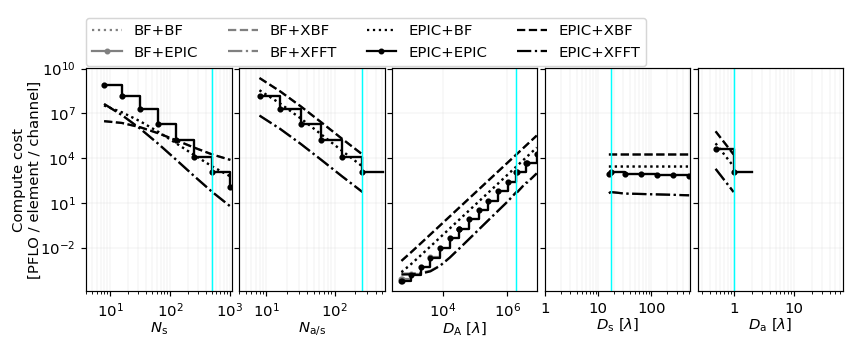

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_perelement_coherent_epe_analysis_AU-VLBA-low.pdf


<IPython.core.display.Javascript object>


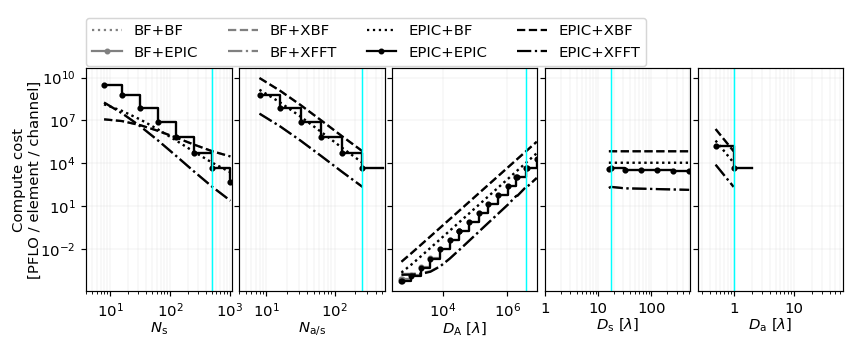

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_perelement_coherent_epe_analysis_IC-VLBA-low.pdf


In [1189]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_npol, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.95*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.95*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.95*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent)
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,3))

    axs[0].plot(nstations, (epe_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, (epe_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[0].plot(nstations, (epe_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, (epe_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, (epe_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, (epe_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[0].plot(nstations, (epe_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, (epe_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Compute cost\n[PFLO / element / channel]', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, (epe_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, (epe_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[1].plot(nants_in_station, (epe_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, (epe_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, (epe_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].to(pflo), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, (epe_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, (epe_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[2].plot(array_dia, (epe_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, (epe_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, (epe_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, (epe_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[2].plot(array_dia, (epe_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, (epe_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
#     axs[2].set_xlim(charr_axs_min[1], charr_axs_max[1])
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, (epe_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, (epe_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[3].plot(station_dia, (epe_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, (epe_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, (epe_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, (epe_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[3].plot(station_dia, (epe_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, (epe_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, (epe_1BF_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, (epe_1BF_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[4].plot(ant_dia, (epe_1BF_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, (epe_1BF_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, (epe_1EPIC_2BF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, (epe_1EPIC_2EPIC/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[4].plot(ant_dia, (epe_1EPIC_2XBF/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, (epe_1EPIC_2XFFT/nelements_in_array)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].to(pflo), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.15, right=0.98, left=0.1, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_perelement_coherent_epe_analysis_{0}.pdf'.format(charr['name']), bbox_inches=0)
    print('Saved at: '+figdir+'1D_perelement_coherent_epe_analysis_{0}.pdf'.format(charr['name']))

## ID effort per event for 1EPIC-2coherent vs. 1BF-2coherent 

<IPython.core.display.Javascript object>


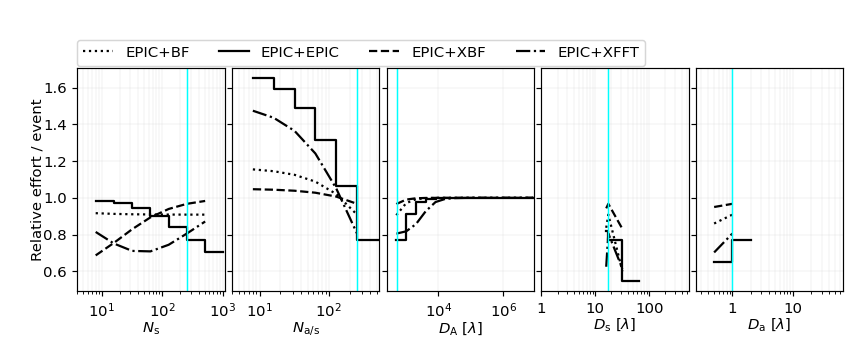

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_coherent_epe_EPIC_1BF_ratio_SKA1-low-core.pdf


<IPython.core.display.Javascript object>


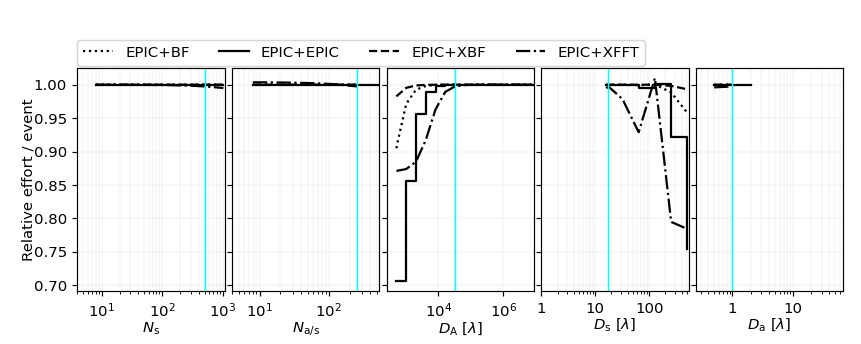

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_coherent_epe_EPIC_1BF_ratio_SKA1-low.pdf


<IPython.core.display.Javascript object>


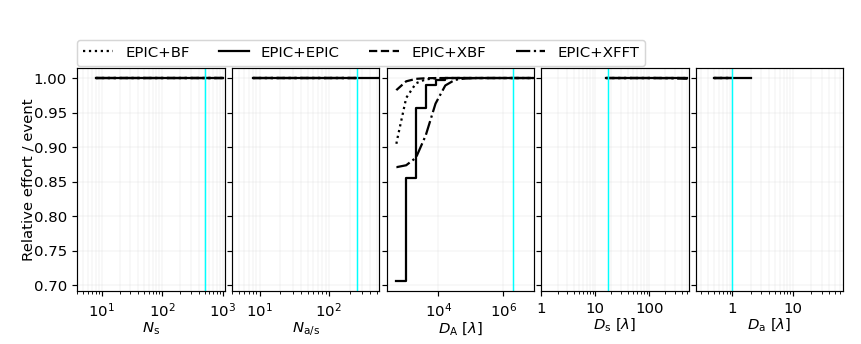

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_coherent_epe_EPIC_1BF_ratio_AU-VLBA-low.pdf


<IPython.core.display.Javascript object>


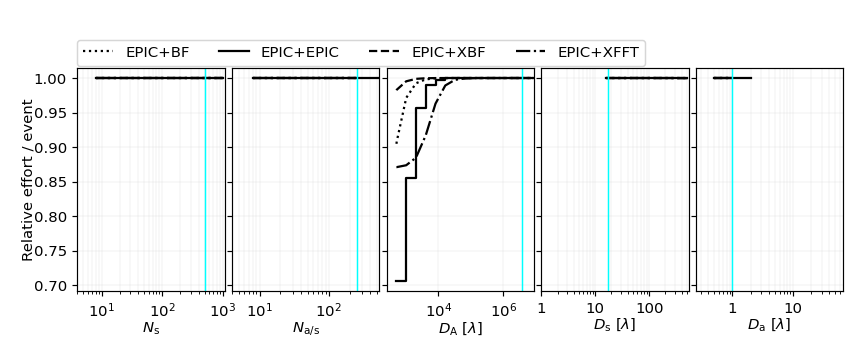

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_coherent_epe_EPIC_1BF_ratio_IC-VLBA-low.pdf


In [1190]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_npol, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.95*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.95*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.95*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent)
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,3))

    axs[0].plot(nstations, (epe_1EPIC_2BF/epe_1BF_2BF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, (epe_1EPIC_2EPIC/epe_1BF_2EPIC)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[0].plot(nstations, (epe_1EPIC_2XBF/epe_1BF_2XBF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, (epe_1EPIC_2XFFT/epe_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xscale('log')
    axs[0].set_yscale('linear')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Relative effort / event', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, (epe_1EPIC_2BF/epe_1BF_2BF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2EPIC/epe_1BF_2EPIC)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XBF/epe_1BF_2XBF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XFFT/epe_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xscale('log')
    axs[1].set_yscale('linear')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, (epe_1EPIC_2BF/epe_1BF_2BF)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, (epe_1EPIC_2EPIC/epe_1BF_2EPIC)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[2].plot(array_dia, (epe_1EPIC_2XBF/epe_1BF_2XBF)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, (epe_1EPIC_2XFFT/epe_1BF_2XFFT)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
#     axs[2].set_xlim(charr_axs_min[1], charr_axs_max[1])
    axs[2].set_xscale('log')
    axs[2].set_yscale('linear')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, (epe_1EPIC_2BF/epe_1BF_2BF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, (epe_1EPIC_2EPIC/epe_1BF_2EPIC)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[3].plot(station_dia, (epe_1EPIC_2XBF/epe_1BF_2XBF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, (epe_1EPIC_2XFFT/epe_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('linear')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, (epe_1EPIC_2BF/epe_1BF_2BF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, (epe_1EPIC_2EPIC/epe_1BF_2EPIC)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[4].plot(ant_dia, (epe_1EPIC_2XBF/epe_1BF_2XBF)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, (epe_1EPIC_2XFFT/epe_1BF_2XFFT)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xscale('log')
    axs[4].set_yscale('linear')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.15, right=0.98, left=0.09, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_perelement_coherent_coherent_epe_EPIC_1BF_ratio_{0}.pdf'.format(charr['name']), bbox_inches=0)
    print('Saved at: '+figdir+'1D_coherent_coherent_epe_EPIC_1BF_ratio_{0}.pdf'.format(charr['name']))

## 1D Effort per event ratio for coherent-coherent vs. coherent-incoherent imaging architectures

<IPython.core.display.Javascript object>


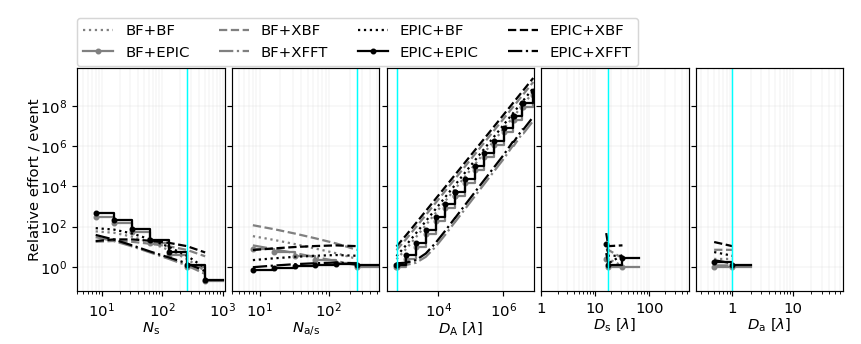

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_incoherent_epe_ratio_SKA1-low-core.pdf


<IPython.core.display.Javascript object>


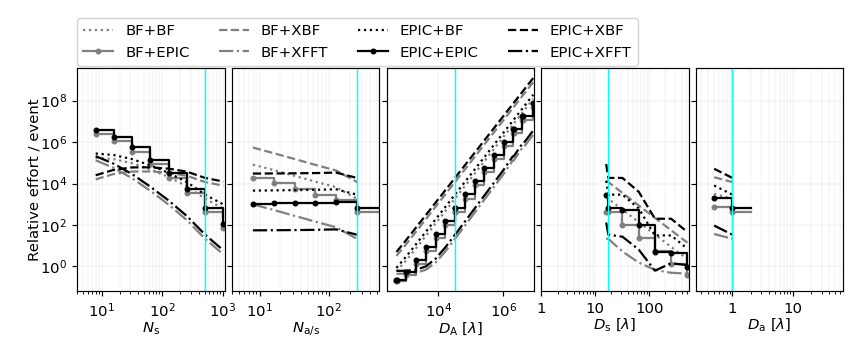

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_incoherent_epe_ratio_SKA1-low.pdf


<IPython.core.display.Javascript object>


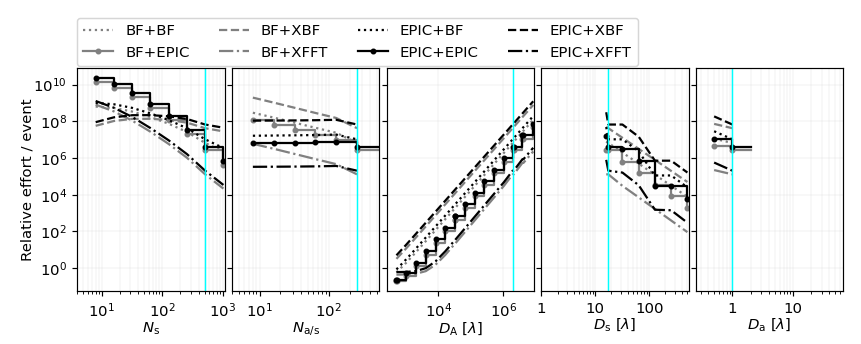

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_incoherent_epe_ratio_AU-VLBA-low.pdf


<IPython.core.display.Javascript object>


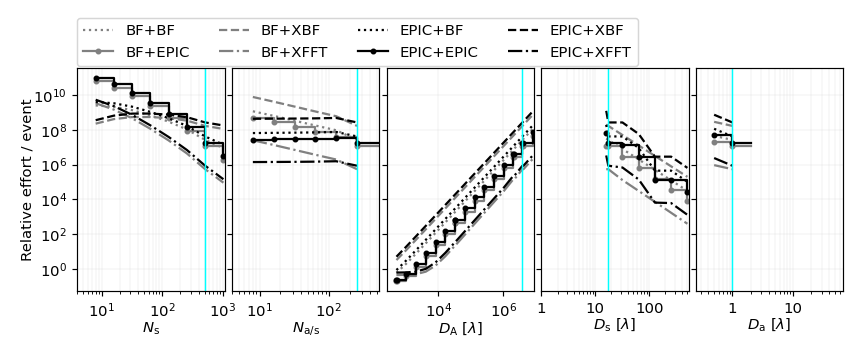

Saved at: /u/thy009/carina2/bulk/projects/multi_scale_imaging/figures/v2.1/1D_coherent_incoherent_epe_ratio_IC-VLBA-low.pdf


In [1191]:
for chosenarr in range(len(arrs)):
    charr, charr_nominal_vals, charr_ind_nominal_npol, charr_ind_nominal_array_dia, charr_ind_nominal_nstations, charr_ind_nominal_station_dia, charr_ind_nominal_ant_dia, charr_ind_nominal_nants_in_station, charr_nominal_inds, charr_nominal_inds_epe_incoherent, charr_nominal_inds_eventrate_incoherent = chosen_array_info(chosenarr)

    charr_axs_min = []*len(charr_nominal_vals)
    charr_axs_max = []*len(charr_nominal_vals)
    for charr_axi,charr_axv in enumerate(axs_vals):
        charr_axs_min += [0.95*charr_axv.min()]
        charr_axs_max += [1.05*charr_axv.max()]
#         if charr_axi == 1:
#             if chosenarr in [2,3]:
#                 charr_axs_min += [0.95*charr_axv.min()]
#                 charr_axs_max += [1.05e4*charr_axv.min()]
#             else:
#                 charr_axs_min += [0.95e-4*charr_axv.max()]
#                 charr_axs_max += [1.05*charr_axv.max()]
#         else:
#             charr_axs_min += [0.95*charr_axv.min()]
#             charr_axs_max += [1.05*charr_axv.max()]

    ncols = len(axes_to_plot_coherent)
    fig, axs = PLT.subplots(1, ncols, sharey=True, figsize=(7.5,3))

    axs[0].plot(nstations, (epe_1BF_2BF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[0].plot(nstations, (epe_1BF_2EPIC/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[0].plot(nstations, (epe_1BF_2XBF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[0].plot(nstations, (epe_1BF_2XFFT/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[0].plot(nstations, (epe_1EPIC_2BF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[0].plot(nstations, (epe_1EPIC_2EPIC/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[0].plot(nstations, (epe_1EPIC_2XBF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[0].plot(nstations, (epe_1EPIC_2XFFT/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,:,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[0].axvline(nstations[charr_ind_nominal_nstations], color='cyan', ls='-', lw=1)
    axs[0].set_xlim(0.5*nstations.min(), 1.05*nstations.max())
    axs[0].set_xscale('log')
    axs[0].set_yscale('log')
    axs[0].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax0_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[0].yaxis.set_major_locator(ax0_yticks)
#     axs[0].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
#     axs[0].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[0].set_xlabel(r'$N_\mathrm{s}$', fontsize=10, labelpad=0)
    axs[0].set_ylabel('Relative effort / event', fontsize=10, labelpad=-1)
    axs[0].legend(ncol=4, loc=[0.0, 1.01])
    
    axs[1].plot(nants_in_station, (epe_1BF_2BF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls=':', label='BF+BF')
    axs[1].plot(nants_in_station, (epe_1BF_2EPIC/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[1].plot(nants_in_station, (epe_1BF_2XBF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[1].plot(nants_in_station, (epe_1BF_2XFFT/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[1].plot(nants_in_station, (epe_1EPIC_2BF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2EPIC/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XBF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[1].plot(nants_in_station, (epe_1EPIC_2XFFT/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,:].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[1].axvline(nants_in_station[charr_ind_nominal_nants_in_station], color='cyan', ls='-', lw=1)
    axs[1].set_xlim(0.5*nants_in_station.min(), 1.05*nants_in_station.max())
    axs[1].set_xscale('log')
    axs[1].set_yscale('log')
    axs[1].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax1_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[1].yaxis.set_major_locator(ax1_yticks)
#     axs[1].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[1].set_xlabel(r'$N_\mathrm{eps}$', fontsize=10, labelpad=0)

    axs[2].plot(array_dia, (epe_1BF_2BF/epe_stationwise_beamforming)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[2].plot(array_dia, (epe_1BF_2EPIC/epe_stationwise_beamforming)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[2].plot(array_dia, (epe_1BF_2XBF/epe_stationwise_beamforming)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[2].plot(array_dia, (epe_1BF_2XFFT/epe_stationwise_beamforming)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[2].plot(array_dia, (epe_1EPIC_2BF/epe_stationwise_epic)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[2].plot(array_dia, (epe_1EPIC_2EPIC/epe_stationwise_epic)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[2].plot(array_dia, (epe_1EPIC_2XBF/epe_stationwise_epic)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[2].plot(array_dia, (epe_1EPIC_2XFFT/epe_stationwise_epic)[charr_ind_nominal_npol,:,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[2].axvline(array_dia[charr_ind_nominal_array_dia], color='cyan', ls='-', lw=1)
    axs[2].set_xlim(0.5*array_dia.min(), 1.05*array_dia.max())
#     axs[2].set_xlim(charr_axs_min[1], charr_axs_max[1])
    axs[2].set_xscale('log')
    axs[2].set_yscale('log')
    axs[2].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax2_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[2].yaxis.set_major_locator(ax2_yticks)
#     axs[2].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
#     axs[2].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[2].set_xlabel(r'$D_\mathrm{A}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[3].plot(station_dia, (epe_1BF_2BF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[3].plot(station_dia, (epe_1BF_2EPIC/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[3].plot(station_dia, (epe_1BF_2XBF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[3].plot(station_dia, (epe_1BF_2XFFT/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[3].plot(station_dia, (epe_1EPIC_2BF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[3].plot(station_dia, (epe_1EPIC_2EPIC/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[3].plot(station_dia, (epe_1EPIC_2XBF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[3].plot(station_dia, (epe_1EPIC_2XFFT/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,:,charr_ind_nominal_ant_dia,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[3].axvline(station_dia[charr_ind_nominal_station_dia], color='cyan', ls='-', lw=1)
    axs[3].set_xlim(0.5*station_dia.min(), 1.05*station_dia.max())
    axs[3].set_xscale('log')
    axs[3].set_yscale('log')
    axs[3].grid(axis='both', which='both', lw=0.2, color='lightgray')
    ax3_yticks = ticker.LogLocator(base=10.0, numticks=7)
    axs[3].yaxis.set_major_locator(ax3_yticks)
    axs[3].xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))
    axs[3].yaxis.set_major_formatter(ticker.FormatStrFormatter('%.4g'))
    axs[3].set_xlabel(r'$D_\mathrm{s}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    axs[4].plot(ant_dia, (epe_1BF_2BF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls=':', label='BF+BF')
    axs[4].plot(ant_dia, (epe_1BF_2EPIC/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', marker='.', ls='-', drawstyle='steps-post', label='BF+EPIC')
    axs[4].plot(ant_dia, (epe_1BF_2XBF/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='--', label='BF+XBF')
    axs[4].plot(ant_dia, (epe_1BF_2XFFT/epe_stationwise_beamforming)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='gray', ls='-.', label='BF+XFFT')
    axs[4].plot(ant_dia, (epe_1EPIC_2BF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls=':', label='EPIC+BF')
    axs[4].plot(ant_dia, (epe_1EPIC_2EPIC/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', marker='.', ls='-', drawstyle='steps-post', label='EPIC+EPIC')
    axs[4].plot(ant_dia, (epe_1EPIC_2XBF/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='--', label='EPIC+XBF')
    axs[4].plot(ant_dia, (epe_1EPIC_2XFFT/epe_stationwise_epic)[charr_ind_nominal_npol,charr_ind_nominal_array_dia,charr_ind_nominal_nstations,charr_ind_nominal_station_dia,:,charr_ind_nominal_nants_in_station].decompose(), color='black', ls='-.', label='EPIC+XFFT')
    axs[4].axvline(ant_dia[charr_ind_nominal_ant_dia], color='cyan', ls='-', lw=1)
    axs[4].set_xlim(0.5*ant_dia.min(), 1.05*ant_dia.max())
    axs[4].set_xscale('log')
    axs[4].set_yscale('log')
    axs[4].grid(axis='both', which='both', lw=0.2, color='lightgray')
    axs[4].xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2g'))
    axs[4].set_xlabel(r'$D_\mathrm{e}\,\, [\lambda]$', fontsize=10, labelpad=0)
    
    PLT.subplots_adjust(bottom=0.15, right=0.98, left=0.09, top=0.8, wspace=0.05, hspace=0)

    PLT.savefig(figdir+'1D_perelement_coherent_incoherent_epe_ratio_{0}.pdf'.format(charr['name']), bbox_inches=0)
    print('Saved at: '+figdir+'1D_coherent_incoherent_epe_ratio_{0}.pdf'.format(charr['name']))

In [197]:
print(cmac)

8.0 flo


In [198]:
ee = 10**NP.arange(25,36,1.0) * U.erg / U.Hz
rate_bochenek = frb_vol_rate_Bochenek_et_al_2020(ee, plindex=-0.91)
ll = 10**NP.arange(40, 46, 1.0)
# rate_luo_1 = phi_ * upper_gamma_incomplete(-1.79+1, ll/lum_.cgs.value)
# rate_luo_2 = phi_ * upper_gamma_incomplete(-1.5+1, ll/lum_.cgs.value)
rate_luo_1 = frb_vol_rate_Luo_et_al_2020(ll*U.erg/U.s, -1.79)
rate_luo_2 = frb_vol_rate_Luo_et_al_2020(ll*U.erg/U.s, -1.5)

<IPython.core.display.Javascript object>


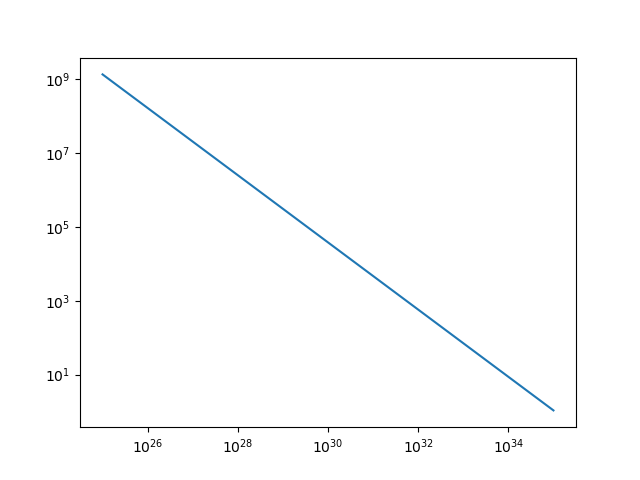

<IPython.core.display.Javascript object>


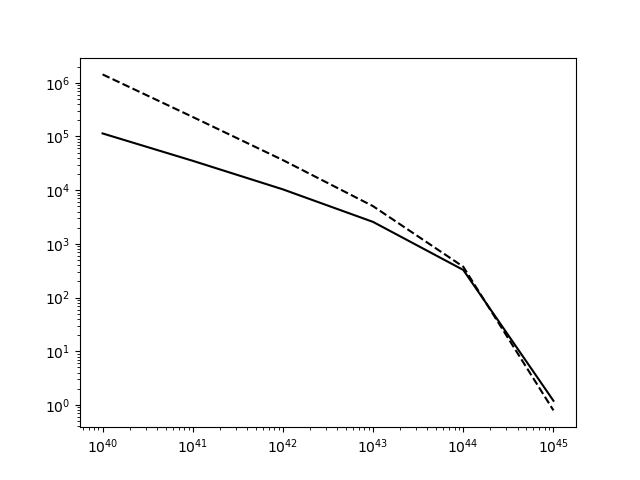

In [199]:
fig = PLT.figure()
ax = fig.add_subplot(111)
ax.plot(ee, rate_bochenek.to('Gpc-3 yr-1').value)
ax.set_xscale('log')
ax.set_yscale('log')

fig = PLT.figure()
ax = fig.add_subplot(111)
ax.plot(ll, rate_luo_1.to('Gpc-3 yr-1').value, color='black', ls='--')
ax.plot(ll, rate_luo_2.to('Gpc-3 yr-1').value, color='black', ls='-')
ax.set_xscale('log')
ax.set_yscale('log')

In [200]:
flux_density_peak_pulse = 1 * U.Jy
d_C = NP.sqrt(psd_pulse_typical / (4*NP.pi*flux_density_peak_pulse))
print(d_C.to('Mpc'))
z_pulse = Cosmo.z_at_value(surface_area_modulus_function, psd_pulse_typical/flux_density_peak_pulse, zmax=5)
print(z_pulse)

914.2069588409049 Mpc
[0.1979259]


In [204]:
print(1*flops==1*flo/U.s)
U.add_enabled_units([flops, flo])
print((1*flo/U.s).to(gflo*U.kHz))

True
1e-12 gflo kHz


[[ True False False False False False False False False False]
 [ True  True False False False False False False False False]
 [ True  True  True False False False False False False False]]
[[1 0 0 0 0 0 0 0 0 0]
 [1 1 0 0 0 0 0 0 0 0]
 [1 1 1 0 0 0 0 0 0 0]]
0.6766
[0.01238178 0.10015123 0.17561058 0.17114567 0.09562096 0.04458641
 0.02161954 0.01137371 0.00645475 0.00390147] solMass / (Mpc3 yr)


<IPython.core.display.Javascript object>


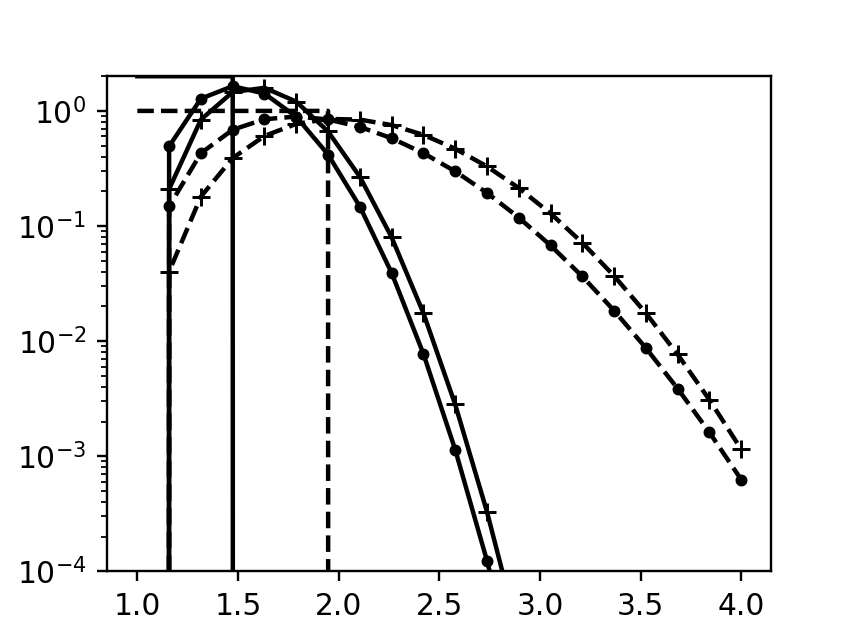

In [485]:
aa = NP.linspace(1,3,num=3,endpoint=True)
bb = 0.01 + NP.arange(10) 
cc = NP.ones((3,10), dtype=int)
zz = NP.linspace(0, 3, num=20, endpoint=True)
zc = NP.array([0.5, 1])
mask = aa.reshape(-1,1) > bb.reshape(1,-1)
print(mask)
dd = cc * mask
print(dd)
print(cosmoparm.h)
sfh_unit = U.M_sun / U.yr / U.Mpc**3
b1 = 0.0170
b2 = 0.13
b3 = 3.3
b4 = 5.3
sfh = (b1+b2*bb)*cosmoparm.h / (1+(bb/b3)**b4) * sfh_unit
print(sfh)
pzc = frb_redshift_distribution(zz, zc, model='const', output='pdf')
pzs = frb_redshift_distribution(zz, zc, model='sfh', output='pdf')
pzu = frb_redshift_distribution(zz, zc, model='uniform-step', output='pdf')

msymb = ['.', 's', 'x']
ls = ['-', '--']
fig, ax = PLT.subplots(1, figsize=(4,3))
for zci in range(len(zc)):
    ax.plot(1+zz, pzu[zci], ls=ls[zci], color='black')
    ax.plot(1+zz, pzc[zci], ls=ls[zci], marker='.', color='black')
    ax.plot(1+zz, pzs[zci], ls=ls[zci], marker='+', color='black')
ax.set_ylim(1e-4, 2)
ax.set_yscale('log')

[ 0.          1.04087729  1.94641663  2.72572233  3.39563447  3.9741024
  4.47719791  4.91829623  5.30818888  5.655489    5.96706634  6.24842462
  6.50400399  6.7374157   6.95162173  7.14907202  7.33180946  7.50155072
  7.65974889  7.80764237  7.9462934   8.07661856  8.19941316  8.31537095
  8.42510001  8.5291358   8.62795184  8.72196859  8.8115608   8.89706365
  8.97877799  9.05697466  9.13189825  9.20377024  9.27279176  9.3391459
  9.40299973  9.46450606  9.52380499  9.58102519  9.63628508  9.68969388
  9.74135249  9.79135427  9.83978577  9.88672737  9.93225378  9.97643459
 10.01933471 10.06101472 10.10153131 10.14093752 10.17928307 10.21661465
 10.2529761  10.28840865 10.32295114 10.35664016 10.38951023 10.42159396
 10.45292216 10.48352398 10.51342703 10.54265745 10.57124007 10.59919841
 10.62655485 10.65333065 10.67954602 10.70522023 10.73037161 10.75501763
 10.77917498 10.80285957 10.82608659 10.84887057 10.87122539 10.89316435
 10.91470015 10.93584497 10.95661049 10.97700789 10.9

<IPython.core.display.Javascript object>


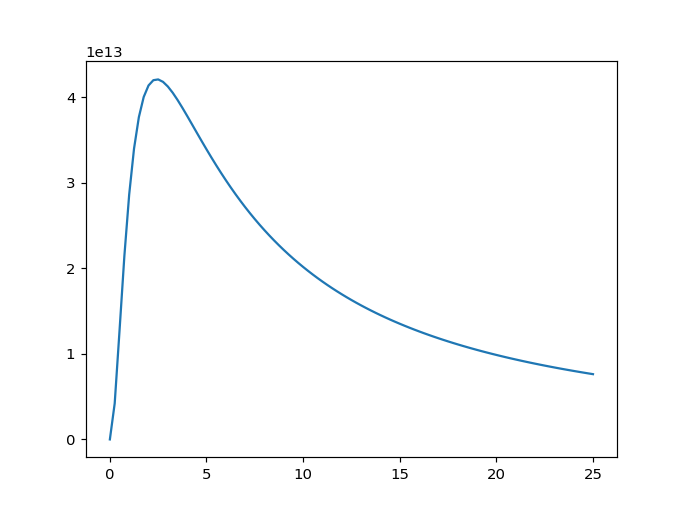

In [432]:
zv = NP.linspace(0,25.0,num=101,endpoint=True)
cmvdist = cosmoparm.comoving_distance(zv)
fz = FC.c * cmvdist**2 / cosmoparm.H(zv)
print(cmvdist.to('Gpc'))
print(fz.to('Gpc3'))
fig, ax = PLT.subplots(1)
ax.plot(zv, fz)